<a href="https://colab.research.google.com/github/Floquicanale/TP-2-PSB/blob/main/PSB2023Q1_TP2_Ejercicio_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Trabajo Práctico 2, Ejercicio 2: EEG

##Se Monta el Drive y se importan las librerías

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install brainflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.6/28.6 MB 26.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 kB 2.2 MB/s eta 0:00:00


In [ ]:
import numpy as np
import scipy.signal as signal
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
import scipy.io
import math
from scipy.fft import fft
import librosa
from sklearn.preprocessing import normalize
from brainflow.board_shim import BoardShim, BrainFlowInputParams, BoardIds
from brainflow.data_filter import DataFilter, NoiseTypes, FilterTypes

##Señales capturadas del EEG crudas

In [ ]:
arch_path = '/content/drive/MyDrive/Colab Notebooks/Archivos EEG/Datos2y5Actualizados.csv'
arch_path1 = '/content/drive/MyDrive/Colab Notebooks/Archivos EEG/Datos1y3Actualizados.csv'
arch_path2 = '/content/drive/MyDrive/Colab Notebooks/Archivos EEG/Datos4y6Actualizados.csv'
datos = pd.read_csv(arch_path)
datos1=pd.read_csv(arch_path1)
datos2=pd.read_csv(arch_path2)

#datos = pd.DataFrame(np.transpose(datos))
#
print('Data From the File 2 y 5')
print(datos.head())
print('Data From the File 1 y 3')
print(datos1.head())
print('Data From the File 4 y 6')
print(datos2.head())


print(datos.shape)
print("Tipo de dato: ",type(datos))

Data From the File 2 y 5
   Column1      Column2      Column3      Column4      Column5      Column6  \
0        0       0.0000      0.00000       0.0000       0.0000       0.0000   
1        1 -187500.0224 -66441.87915 -105801.6695 -187500.0224 -187500.0224   
2        2 -187500.0224 -66443.62258 -105800.8424 -187500.0224 -187500.0224   
3        3 -187500.0224 -66447.35532 -105796.0145 -187500.0224 -187500.0224   
4        4 -187500.0224 -66447.98117 -105797.5344 -187500.0224 -187500.0224   

       Column7      Column8      Column9  Column10  ...  Column15  Column16  \
0      0.00000      0.00000      0.00000     0.012  ...        96         0   
1 -47136.83392 -65333.45614 -41556.38564     0.012  ...         0         0   
2 -47136.92333 -65333.61260 -41554.44104     0.012  ...         0         0   
3 -47136.27513 -65331.44448 -41554.12812     0.012  ...         0         0   
4 -47135.11284 -65330.39395 -41554.10577     0.012  ...         0         0   

   Column17  Column18  Co

In [ ]:
data = datos.to_numpy()
data1 = datos1.to_numpy()
data2 = datos2.to_numpy()

In [ ]:
type(data)

data.shape

(164252, 24)

In [ ]:
fs = 250
a = data.shape[0]
b = data1.shape[0]
c = data2.shape[0]

In [ ]:
print(f"En Registro Juli se tomaron", a/fs ,"segundos \n\tJuli es el Sujeto 1")
print(f"En Registro Pao se tomaron", b/fs ,"segundos\n\tPao es el Sujeto 2")
print(f"En Registro Abril se tomaron", c/fs ,"segundos\n\tAbril es el Sujeto 3")

En Registro Juli se tomaron 657.008 segundos 
	Juli es el Sujeto 1
En Registro Pao se tomaron 623.336 segundos
	Pao es el Sujeto 2
En Registro Abril se tomaron 611.452 segundos
	Abril es el Sujeto 3


In [ ]:
print(data)

cant_canales = data.shape[1]

canales = np.arange(0,cant_canales)+1
canales

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   1.68435816e+09  0.00000000e+00]
 [ 1.00000000e+00 -1.87500022e+05 -6.64418791e+04 ...  0.00000000e+00
   1.68435816e+09  0.00000000e+00]
 [ 2.00000000e+00 -1.87500022e+05 -6.64436226e+04 ...  0.00000000e+00
   1.68435816e+09  0.00000000e+00]
 ...
 [ 1.64249000e+05 -1.87500022e+05 -6.83203421e+04 ...  0.00000000e+00
   1.68435881e+09  0.00000000e+00]
 [ 1.64250000e+05 -1.87500022e+05 -6.83210127e+04 ...  0.00000000e+00
   1.68435881e+09  0.00000000e+00]
 [ 1.64251000e+05 -1.87500022e+05 -6.83171458e+04 ...  0.00000000e+00
   1.68435881e+09  0.00000000e+00]]


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24])

In [ ]:
tiempo0 = np.linspace(0,a,a)
tiempo1 = np.linspace(0,b,b)
tiempo2 = np.linspace(0,c,c)

In [ ]:
def graficos_crudos(tiempo,datos,sujeto):
  for c in canales:
    if c not in [3,4,7,8,9]:
      continue
    if c == 3:
      titulo = 'Canal '+ str(c-1) +': EOG derecho'
      plt.figure(figsize=(20,4))
      plt.title("EOG derecho sin eliminar la muestra 0 " + sujeto)
      plt.plot(tiempo, datos[f"Column{c}"], color = "red")
      plt.show()
    if c == 4:
      titulo = 'Canal '+ str(c-1) +': EOG izquierdo'
    if c == 7:
      titulo = 'Canal '+ str(c-1) +': Fz'
    if c == 8:
      titulo = 'Canal '+ str(c-1) +': Cz'
    if c == 9:
      titulo = 'Canal '+ str(c-1) +': Pz'

    plt.figure(figsize=(20,4))
    plt.title(titulo + ' ' + sujeto)
    plt.plot(tiempo[1:], datos[f"Column{c}"][1:])
    plt.show()

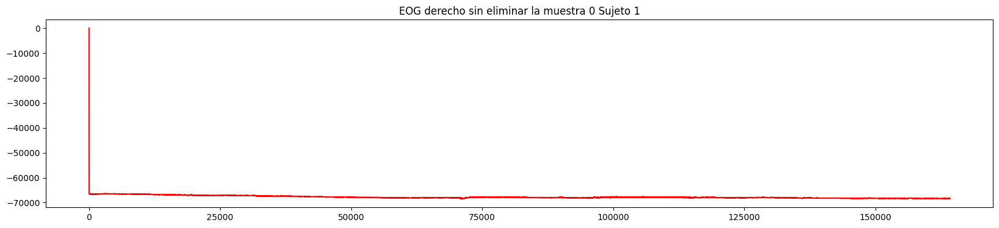

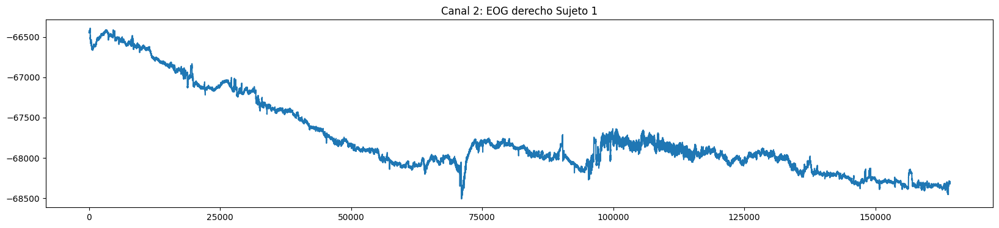

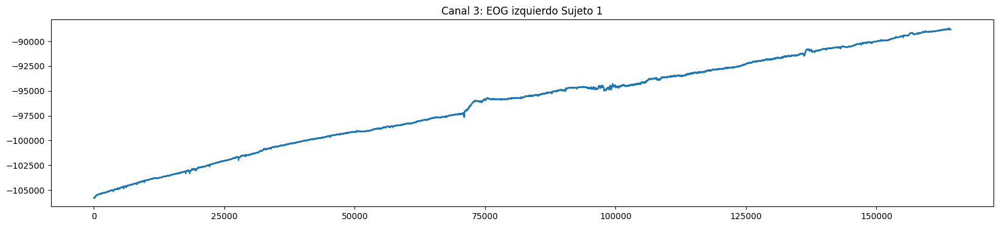

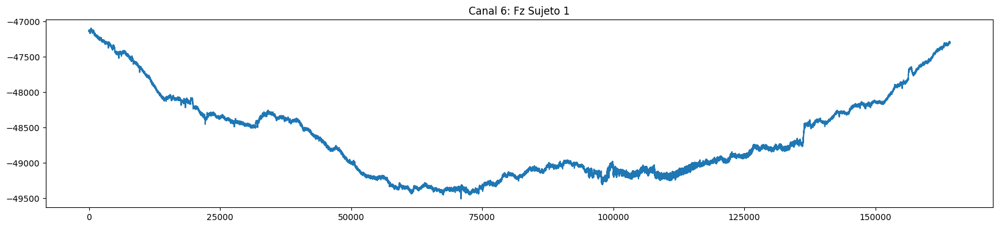

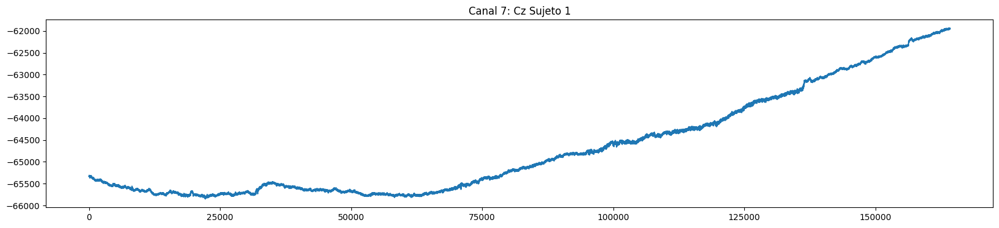

...

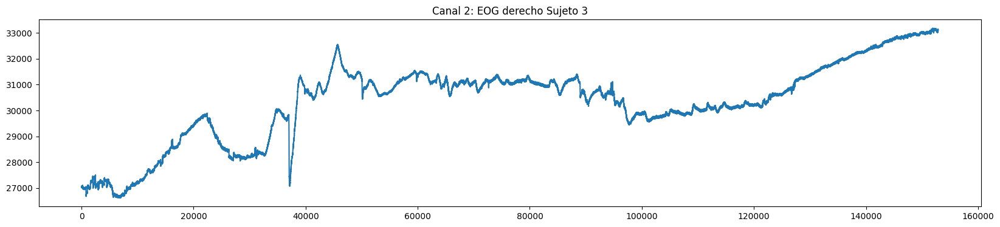

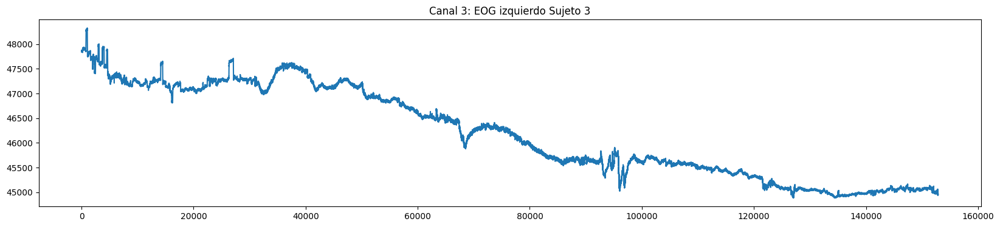

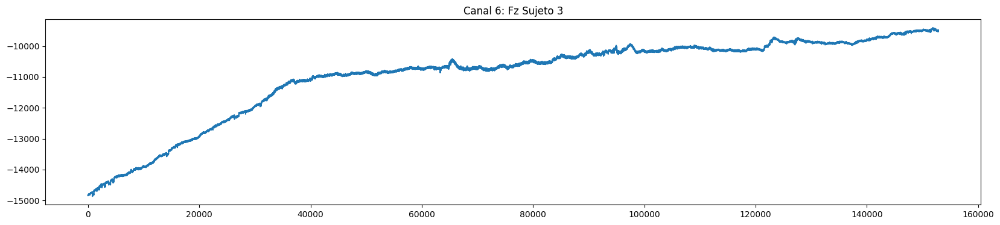

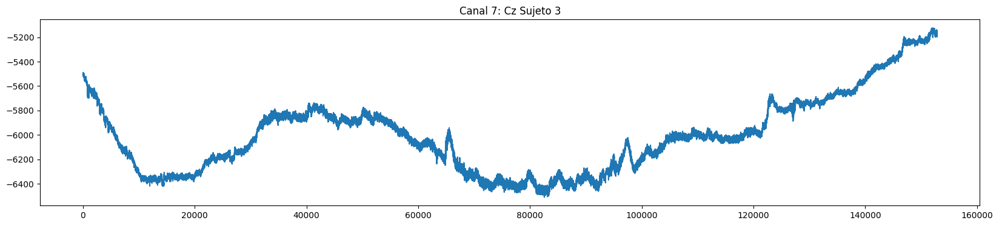

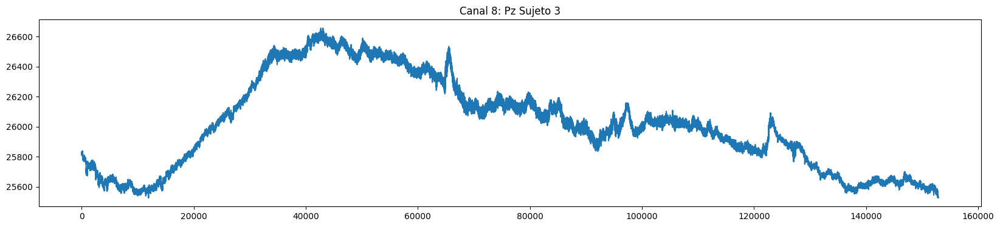

In [ ]:
graficos_crudos(tiempo0,datos, 'Sujeto 1')
graficos_crudos(tiempo1,datos1, 'Sujeto 2')
graficos_crudos(tiempo2,datos2, 'Sujeto 3')

Creamos el diccionario para llenar con las señales filtradas

##Preprocesaimento

In [ ]:
senales = {}
senales1 = {}
senales2 = {}

###Filtro Pasa Bandas

Prueba de filtro IIR butter b,a o sos a partir de un seno.

Se guardan las señales a partir de la muestra 2000, es decir, los primeros 8 segundos se descartan, ya que si no se ven como se muestra en la primera imagen. Es necesario hacerlo para no introducir ruidos a futuro.

Se muestran todas las señales filtradas.

Se hace un espectograma de uno de los canales para observar si hay ruidos constantes y sus armónicos.

<Figure size 1000x700 with 0 Axes>

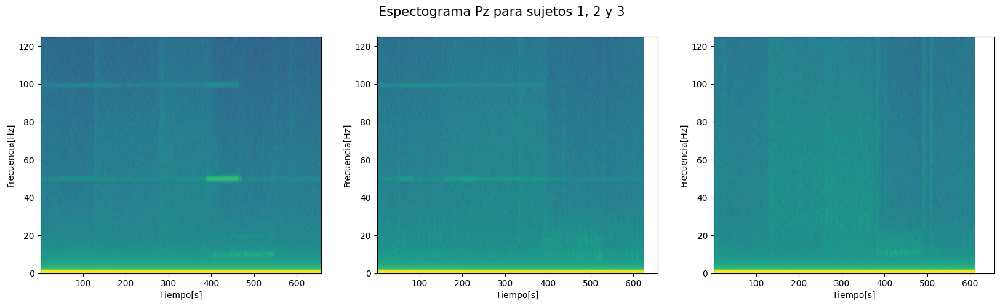

In [ ]:
plt.figure(figsize = (10,7))
fig, (ax1,ax2, ax3) = plt.subplots(1, 3, figsize=(20, 5),sharex=True)
fig.suptitle('Espectograma Pz para sujetos 1, 2 y 3', fontsize=15)
spectrum, fr, ti, im = ax1.specgram(datos[f"Column9"], Fs=fs)
spectrum, fr, ti, im = ax2.specgram(datos1[f"Column9"], Fs=fs)
spectrum, fr, ti, im = ax3.specgram(datos2[f"Column9"], Fs=fs)
ax1.set_xlabel('Tiempo[s]')
ax2.set_xlabel('Tiempo[s]')
ax3.set_xlabel('Tiempo[s]')
ax1.set_ylabel('Frecuencia[Hz]')
ax2.set_ylabel('Frecuencia[Hz]')
ax3.set_ylabel('Frecuencia[Hz]')
plt.show()

In [ ]:
def pasabandas(datos, tiempo, sujeto):
  senales = {}
  #Filtro pasa bandas de la señal
  N = 5
  wn = [0.5,60] #Queremos eliminar el ruido de deriva y las altas frecuencias

  print("Segundos perdidos:", 2000/fs)

  for c in canales:
    if c not in [3,4,7,8,9]:
      continue

    a_procesar = np.array(datos[f"Column{c}"][100:])

    [b,a] = signal.butter(N, wn, btype = 'bandpass', fs = fs)
    filtrada = signal.lfilter(b,a,a_procesar)
    #filtrada = librosa.util.normalize(filtrada)

    if c == 3:
      titulo = 'EOG derecho'
      if sujeto == 'Sujeto 1':
        plt.figure(figsize=(20,4))
        plt.plot((tiempo[100:]/fs),filtrada,color="red")
        plt.title("Señal de EOG derecho sin eliminar muestras " + sujeto)
        plt.xlabel('Tiempo [s]')
        plt.ylabel('Amplitud [uV]')
        plt.show()
      senales['EOGd']=filtrada[2000:]
    if c == 4:
      titulo = 'EOG izquierdo'
      senales['EOGi']=filtrada[2000:]
    if c == 7:
      titulo = 'Fz'
      senales['Fz']=filtrada[2000:]
    if c == 8:
      titulo = 'Cz'
      senales['Cz']=filtrada[2000:]
    if c == 9:
      titulo = 'Pz'
      senales['Pz']=filtrada[2000:]

    if sujeto == 'Sujeto 1':
      fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
      ax1.plot((tiempo[100:]/fs)[2000:],a_procesar[2000:])
      ax1.set_title(titulo +" sin filtrar " + sujeto)
      ax1.set_xlabel('Tiempo [s]')
      ax1.set_ylabel('Amplitud [uV]')
      #plt.xlim([0,700])
      ax2.plot((tiempo[100:]/fs)[2000:],filtrada[2000:])
      ax2.set_title(titulo +" filtrado " + sujeto)
      ax2.set_xlabel('Tiempo [s]')
      ax2.set_ylabel('Amplitud [uV]')
      #plt.xlim([0,700])


  time = (tiempo[100:]/fs)[2000:]

  return senales, time

#CUando procesamos nos chequeamos  movimientos y vemos
#CUando elimino el movimiento lo saco y pego las señales.
#5565TAnalizar por segmentos, mini epocas, segmentos con movimientos los elimino. Y pego la sub epoca
#Paper clave con datos de frecuencias de filtrado de eog: https://repositorio.uniandes.edu.co/bitstream/handle/1992/23697/u303515.pdf?sequence=1

#EOG entre las 2 hago una informacion general, ya sea promediando o uno menos el otro.

Segundos perdidos: 8.0


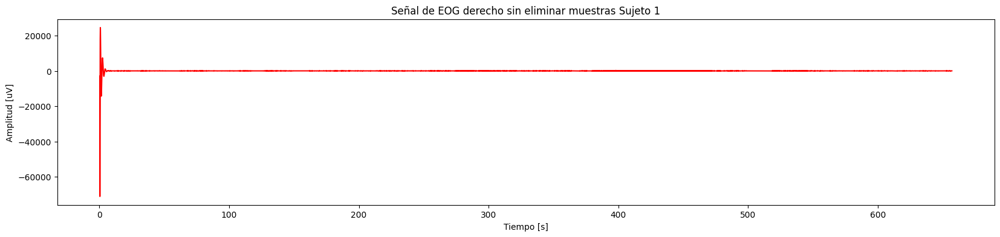

Segundos perdidos: 8.0
Segundos perdidos: 8.0


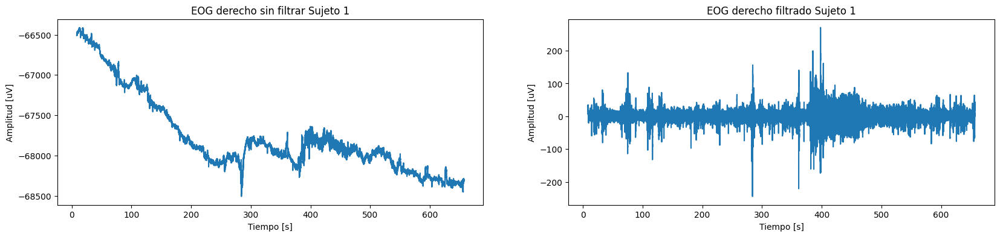

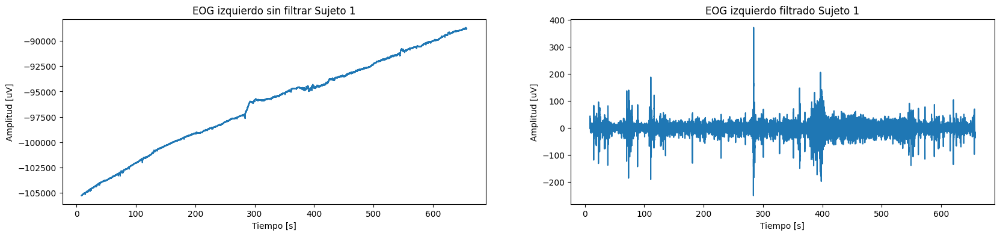

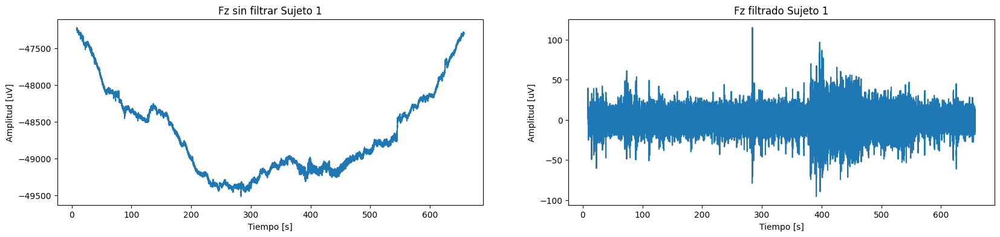

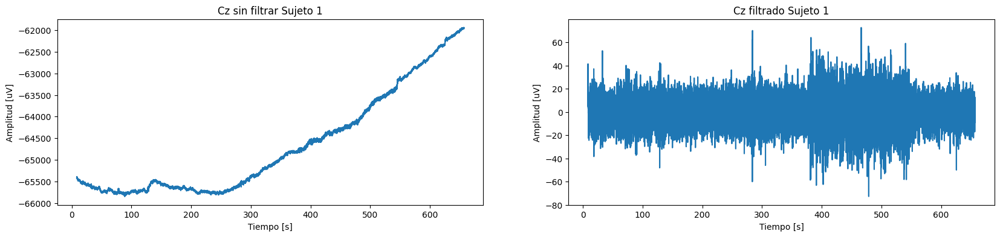

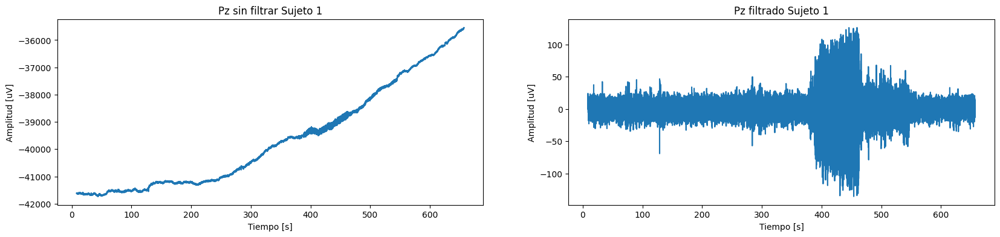

In [ ]:
senales, time0 = pasabandas(datos, tiempo0, 'Sujeto 1')
senales1, time1 = pasabandas(datos1, tiempo1, 'Sujeto 2')
senales2, time2 = pasabandas(datos2, tiempo2, 'Sujeto 3')

Se puede ver que hay ruido de 50 Hz y 100 Hz (su primer armónico), constantes en todo el muestreo.
Por ende, un notch eliminará la frecuencia de 50 Hz y luego el pasabandas cortará la frecuencia de 100 Hz, ya que según la bibliografía, el EEG nos interesa hasta 60 Hz

In [ ]:
def notch(senales):
  #Filtro notch de la señal
  N = 4
  wn = [48,52] #Queremos eliminar el ruido de 50 Hz

  for c in canales:
    if c not in [3,4,7,8,9]:
      continue

    if c == 3:
      a_procesar = np.array(senales['EOGd'])
      [b,a] = signal.butter(N, wn, btype = 'bandstop', fs = fs)
      filtrada = signal.lfilter(b,a,a_procesar)
      senales['EOGd']=filtrada
    if c == 4:
      a_procesar = np.array(senales['EOGi'])
      [b,a] = signal.butter(N, wn, btype = 'bandstop', fs = fs)
      filtrada = signal.lfilter(b,a,a_procesar)
      senales['EOGi']=filtrada
    if c == 7:
      a_procesar = np.array(senales['Fz'])
      [b,a] = signal.butter(N, wn, btype = 'bandstop', fs = fs)
      filtrada = signal.lfilter(b,a,a_procesar)
      senales['Fz']=filtrada
    if c == 8:
      a_procesar = np.array(senales['Cz'])
      [b,a] = signal.butter(N, wn, btype = 'bandstop', fs = fs)
      filtrada = signal.lfilter(b,a,a_procesar)
      senales['Cz']=filtrada
    if c == 9:
      a_procesar = np.array(senales['Pz'])
      [b,a] = signal.butter(N, wn, btype = 'bandstop', fs = fs)
      filtrada = signal.lfilter(b,a,a_procesar)
      senales['Pz']=filtrada

  return senales

#CUando procesamos nos chequeamos  movimientos y vemos
#CUando elimino el movimiento lo saco y pego las señales.
#5565TAnalizar por segmentos, mini epocas, segmentos con movimientos los elimino. Y pego la sub epoca
#Paper clave con datos de frecuencias de filtrado de eog: https://repositorio.uniandes.edu.co/bitstream/handle/1992/23697/u303515.pdf?sequence=1

#EOG entre las 2 hago una informacion general, ya sea promediando o uno menos el otro.

In [ ]:
senales = notch(senales)
senales1 = notch(senales1)
senales2 = notch(senales2)

In [ ]:
def fft_senales(datos,senales,sujeto):
  #fft de cada una de las muestras.
  for c in canales:
    if c not in [3,4,7,8,9]:
      continue

    a_procesar = np.array(datos[f"Column{c}"][100:])
    #Calculo las ffts
    fft = np.abs(np.fft.fft(a_procesar[2000:]))
    freq_fft = np.abs(np.fft.fftfreq(len(a_procesar[2000:]))) * fs

    if c == 3:
      titulo = 'EOG derecho'
      fft_filt = np.abs(np.fft.fft(senales['EOGd']))
      freq_fft_filt = np.abs(np.fft.fftfreq(len(senales['EOGd']))) * fs
    if c == 4:
      titulo = 'EOG izquierdo'
      fft_filt = np.abs(np.fft.fft(senales['EOGi']))
      freq_fft_filt = np.abs(np.fft.fftfreq(len(senales['EOGi']))) * fs
    if c == 7:
      titulo = 'Fz'
      fft_filt = np.abs(np.fft.fft(senales['Fz']))
      freq_fft_filt = np.abs(np.fft.fftfreq(len(senales['Fz']))) * fs
    if c == 8:
      titulo = 'Cz'
      fft_filt = np.abs(np.fft.fft(senales['Cz']))
      freq_fft_filt = np.abs(np.fft.fftfreq(len(senales['Cz']))) * fs
    if c == 9:
      titulo = 'Pz'
      fft_filt = np.abs(np.fft.fft(senales['Pz']))
      freq_fft_filt = np.abs(np.fft.fftfreq(len(senales['Pz']))) * fs

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
    #Ploteo
    ax1.plot(freq_fft, fft)
    ax1.set_xlabel('Frecuencia (Hz)')
    ax1.set_ylabel('Amplitud')
    ax1.set_title('FFT Original de '+ titulo + ' '+ sujeto)
    ax1.set_ylim([800,120000])

    ax2.plot(freq_fft_filt, fft_filt, color='#71BBE8')
    ax2.set_xlabel('Frecuencia (Hz)')
    ax2.set_ylabel('Amplitud')
    ax2.set_title('FFT Filtrada de '+ titulo)

    plt.show()

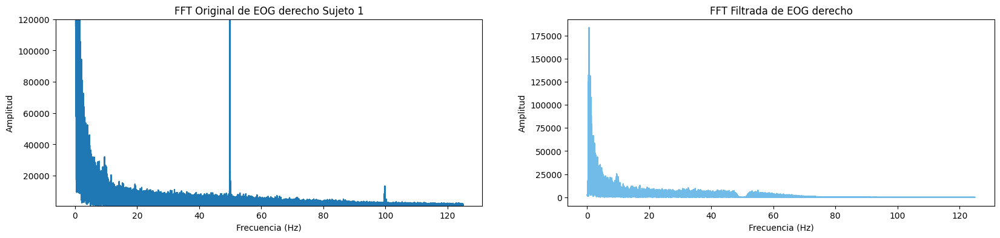

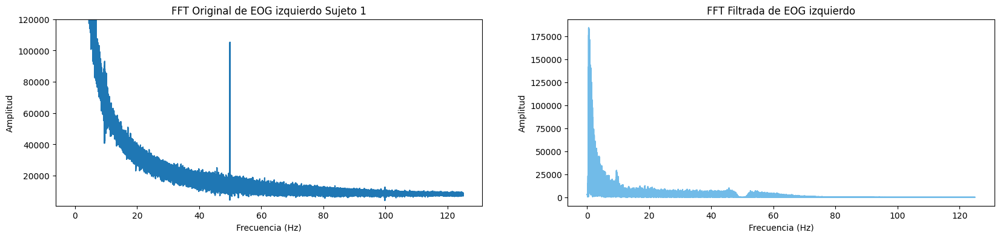

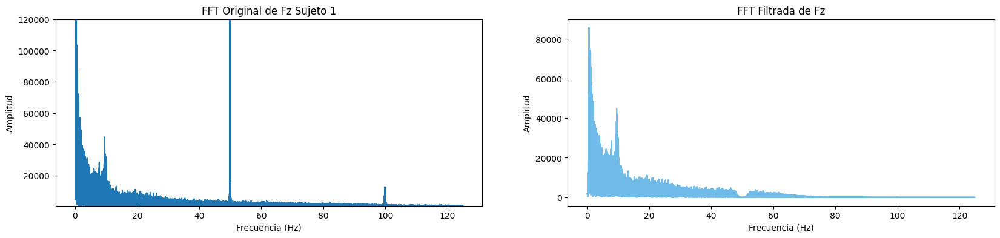

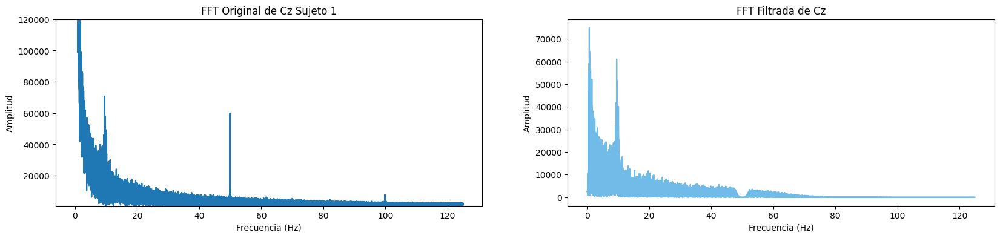

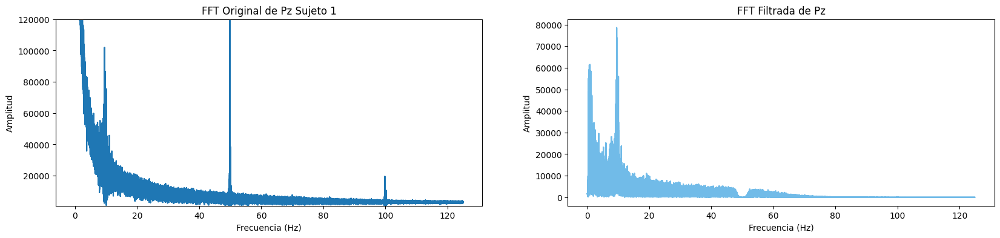

...

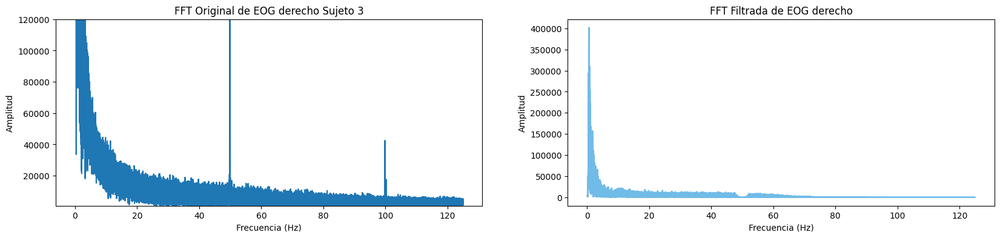

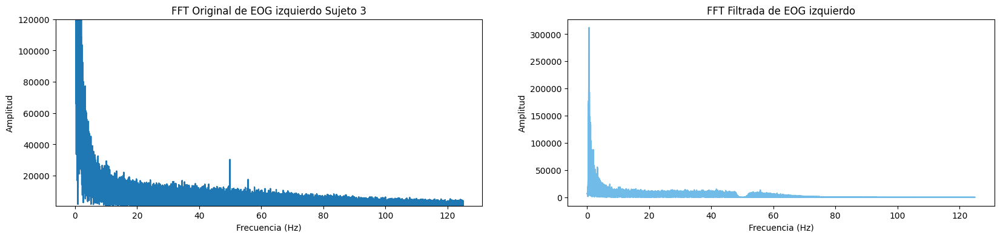

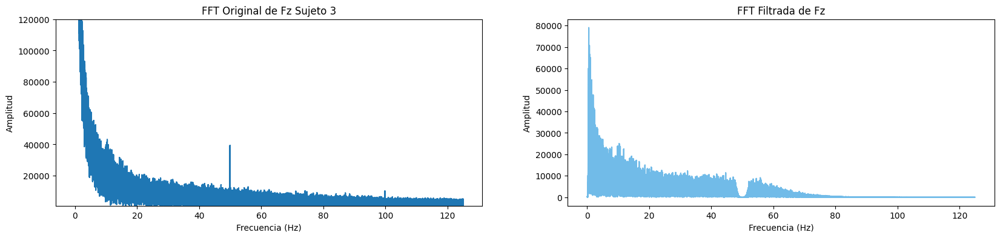

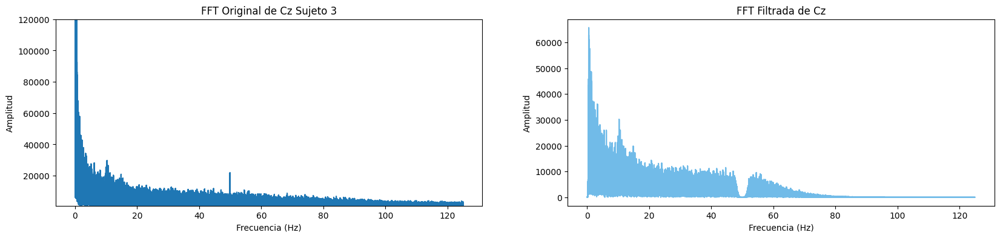

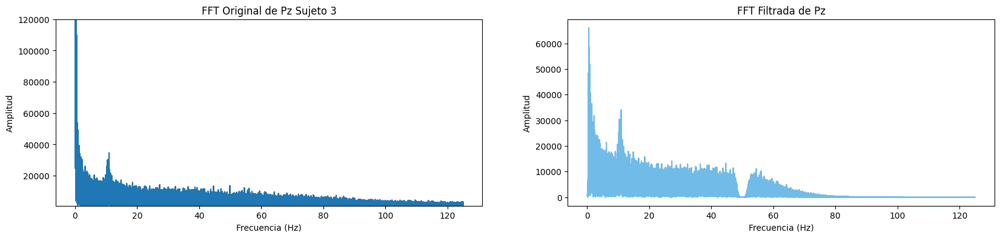

In [ ]:
fft_senales(datos, senales, 'Sujeto 1')
fft_senales(datos1, senales1, 'Sujeto 2')
fft_senales(datos2, senales2, 'Sujeto 3')

Observamos las gráficas de las señales EOGd - EOGi y el promedio entre EOGd y EOGi

In [ ]:
def senales_EOG(senales, time, sujeto):
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
  EOG_dif = senales['EOGd']-senales['EOGi']
  ax1.plot(time, EOG_dif)
  ax1.set_title('EOGd - EOGi '+ sujeto)
  ax1.set_xlabel('Tiempo [s]')
  ax1.set_ylabel('Amplitud [uV]')

  EOG_prom = (senales['EOGd']+senales['EOGi'])/2
  ax2.plot(time, EOG_prom)
  ax2.set_title('Promedio entre EOGd y EOGi ' + sujeto)
  ax2.set_xlabel('Tiempo [s]')
  ax2.set_ylabel('Amplitud [uV]')

  plt.show()

  return EOG_dif, EOG_prom
#probar con cual es mejor hacer el filtro adaptativo. Ver si usar el promediado (donde se ven los blinks) o la diferencia, donde puedo ver el movimiento de baja frec de los 2 ojos
#Esto es para ver tambien si es mejor filtrar adaptativamente o si eso le mete mas ruido a la señal.

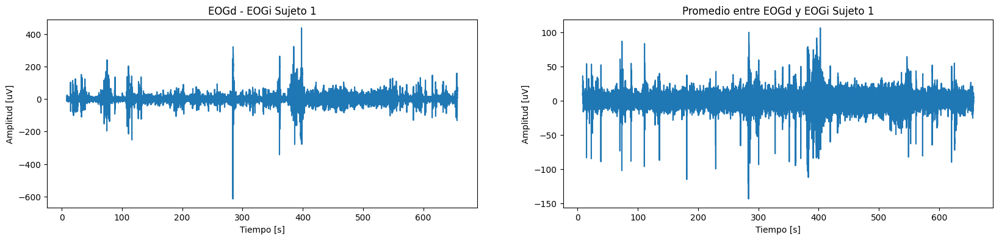

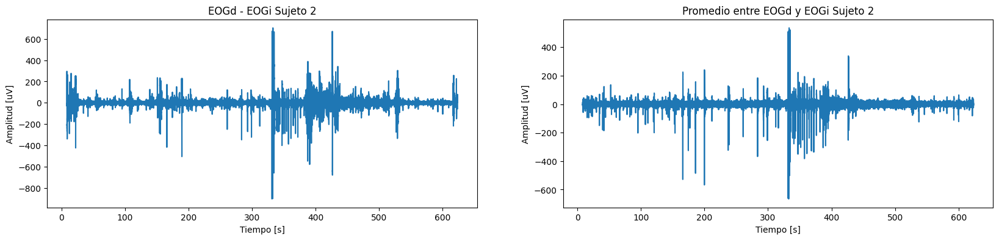

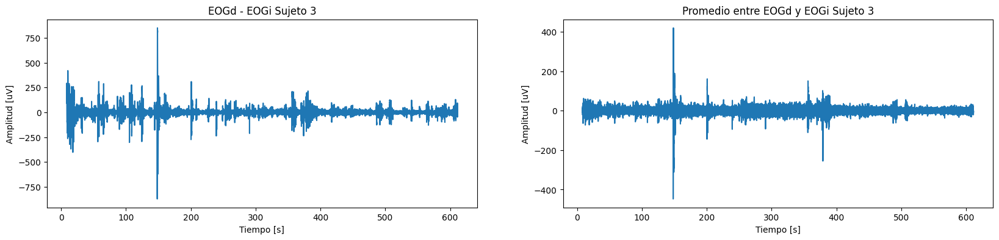

In [ ]:
EOG_dif0, EOG_prom0 = senales_EOG(senales,time0, 'Sujeto 1')
EOG_dif1, EOG_prom1 = senales_EOG(senales1,time1, 'Sujeto 2')
EOG_dif2, EOG_prom2 = senales_EOG(senales2,time2, 'Sujeto 3')

senales_EOG(senales1,time1)En una se pueden ver claramente los parpadeos (el promedio), mientras que en la diferencia no se ven tan claros, ya que al estar en ambas señales se cancelan.

###Filtro adaptativo

In [ ]:
def lms(x, d, L, mu):

  """
  x: señal de entrada
  d: señal deseada
  L: orden del filtro
  mu: paso para la actualización
  """

  # 0. Chequear que mu sea un valor válido

  # 1. Inicializo los pesos (y el resto de valores)
  M = x.shape[0]
  h = np.zeros([1,L]) # Vector pesos
  y = np.zeros([1,M])
  e = np.zeros([1,M])

  for i in range(L,M):
    #print("i",i,"\n")
    x1 = x[i:i-L:-1]
    #print("x1:", x1)

    y[0,i] = h.dot(x1) # 2. Calculo la salida del filtro

    e[0,i] = d[i] - y[0,i] # 3. Obtengo la señal de error

    h = h + mu *e[0,i] * x1 # 4. Actualizo los pesos
    #print("h", h)

  h = h[0]

  return h

In [ ]:
def mostrar_salidas_Pz(senales, time, EOG_dif, EOG_prom, sujeto):
  L= 2**10 #orden del filtro
  Px = np.mean((senales['Pz'])**2) #aproximación de la potencia
  a=0.1
  mu = a*(1/(10*L*Px))

  #t=np.linspace(0,len(senales['Pz']),len(senales['Pz']))

  op = lms(senales['Pz'],EOG_dif,L,mu)
  op1 = lms(senales['Pz'],EOG_prom,L,mu)

  filter = sp.signal.lfilter(op, 1, senales['Pz'])
  filter1 = sp.signal.lfilter(op1, 1, senales['Pz'])

  plt.figure(figsize=(20,4))
  plt.plot(time, senales['Pz'])
  plt.title("Señal de entrada al filtro óptimo "+ sujeto)
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud [uV]')

  plt.show()
  plt.figure(figsize=(20,4))
  plt.plot(time,filter)
  plt.title("Señal de salida diferencia de EOG "+ sujeto)
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud [uV]')

  plt.show()
  plt.figure(figsize=(20,4))
  plt.plot(time,filter1)
  plt.title("Señal de salida EOG promedio "+ sujeto)
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud [uV]')

  plt.show()

  #Resta de las dos señales:
  plt.rcParams["figure.figsize"] = [15, 5]
  plt.plot(time, senales['Pz'], label='Señal Pz original')
  plt.plot(time, senales['Pz']- filter, label='Señal Pz filtrada adaptativamente con diferencia de EOG', color='black')
  plt.plot(time, senales['Pz']-  filter1, label='Señal Pz filtrada adaptativamente con promedio EOG', color='orange')
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud [uV]')
  plt.title('Pz filtrado adaptativamente EOG '+ sujeto)
  plt.legend(loc='upper left')
  plt.show()

  #Resta de las dos señales:
  plt.rcParams["figure.figsize"] = [15, 5]
  plt.plot(time, senales['Pz'], label='Señal Pz original')
  plt.plot(time, senales['Pz']-filter, label='Señal Pz filtrada adaptativamente con diferencia de EOG', color='black')
  plt.plot(time, senales['Pz']- filter1, label='Señal Pz filtrada adaptativamente con promedio EOG', color='orange')
  plt.xlabel('Tiempo [s]')
  plt.xlim([520,600])
  plt.ylabel('Amplitud [uV]')
  plt.title('Fragmento de 40 segundos del gráfico anterior '+ sujeto)
  plt.legend(loc='upper right')
  plt.show()

  #Ver EOG vs filtrada filtro optimo
  plt.rcParams["figure.figsize"] = [15, 5]
  plt.plot(time, senales['EOGd'], label='Señal EOG derecho filtrada (BP)')
  plt.plot(time, senales['EOGd']-filter, label='Señal EOGd vs señal obtenida del filtro (diferencia)', color='black')
  plt.plot(time, senales['EOGd']- filter1, label='Señal EOGd vs señal obtenida del filtro (promedio)', color='orange')
  plt.xlabel('Tiempo [s]')
  plt.xlim([520,600])
  plt.ylabel('Amplitud [uV]')
  plt.title('Señal EOG vs salida del filtro adaptativo '+ sujeto)
  plt.legend(loc='upper right')
  plt.show()

  fft_op = np.abs(np.fft.fft(senales['Pz']-filter))
  freq_fft_op = np.fft.fftfreq(len(senales['Pz']-filter))*fs

  fft_op1 = np.abs(np.fft.fft(senales['Pz']-filter1))
  freq_fft_op1 = np.fft.fftfreq(len(senales['Pz']-filter1))*fs


  fft_filt = np.abs(np.fft.fft(senales['Pz']))
  freq_fft_filt = np.abs(np.fft.fftfreq(len(senales['Pz']))) * fs

  # Grafico

  fig, (ax1,ax2, ax3) = plt.subplots(1, 3, figsize=(18, 5))

  ax1.plot(freq_fft_filt, fft_filt, color='#71BBE8')
  ax1.set_xlabel('Frecuencia (Hz)')
  ax1.set_ylabel('Amplitud')
  ax1.set_title('FFT Filtrada '+ sujeto)
  ax1.set_xlim([0, 60])

  ax2.plot(freq_fft_op, fft_op, color = 'black', alpha=0.7)
  ax2.set_xlabel('Frecuencia (Hz)')
  ax2.set_ylabel('Amplitud')
  ax2.set_title('FFT post filtro optimo diferencia '+ sujeto)
  ax2.set_xlim([0,60])

  ax3.plot(freq_fft_op1, fft_op1, color = "orange")
  ax3.set_xlabel('Frecuencia (Hz)')
  ax3.set_ylabel('Amplitud')
  ax3.set_title('FFT post filtro optimo promedio '+ sujeto)
  ax3.set_xlim([0,60])

  plt.show()



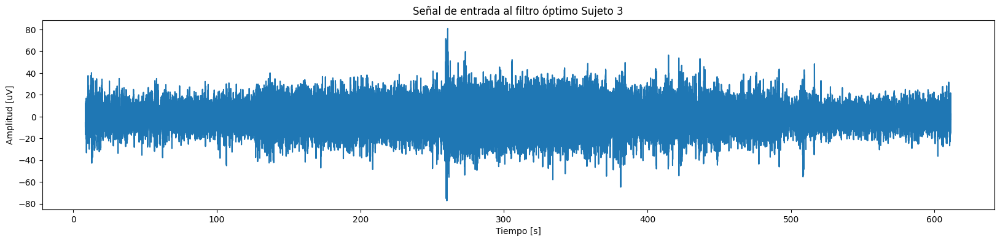

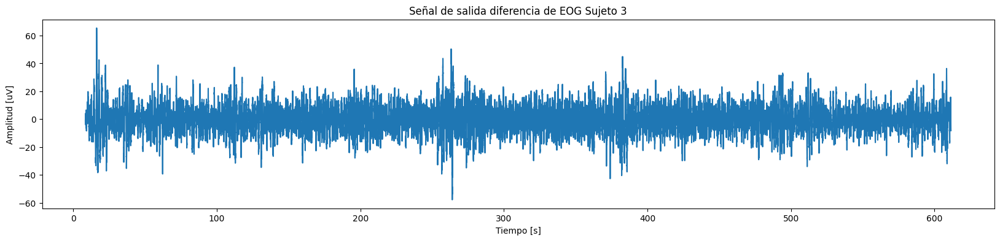

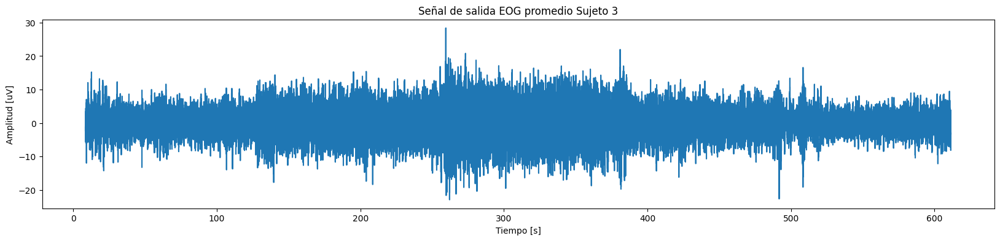

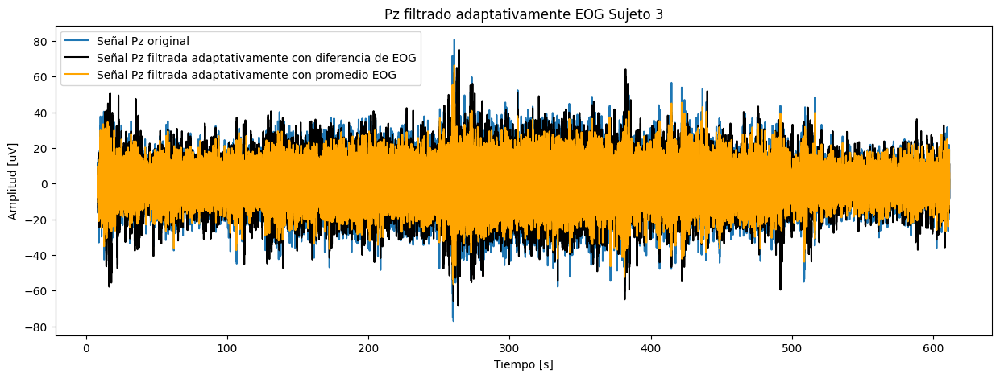

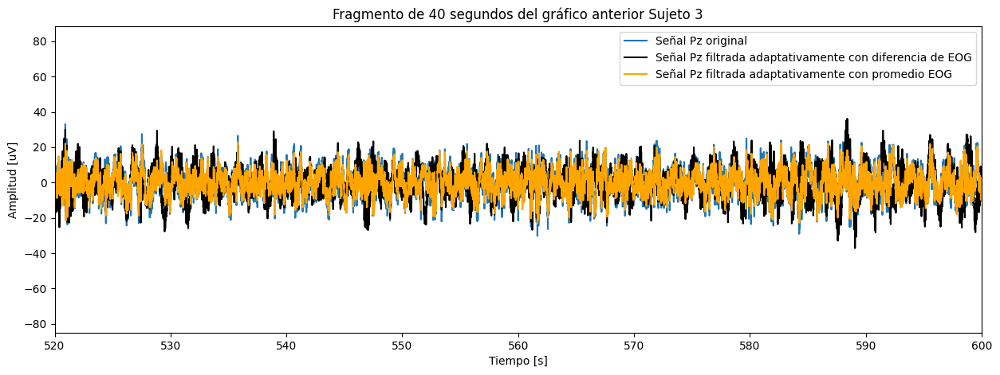

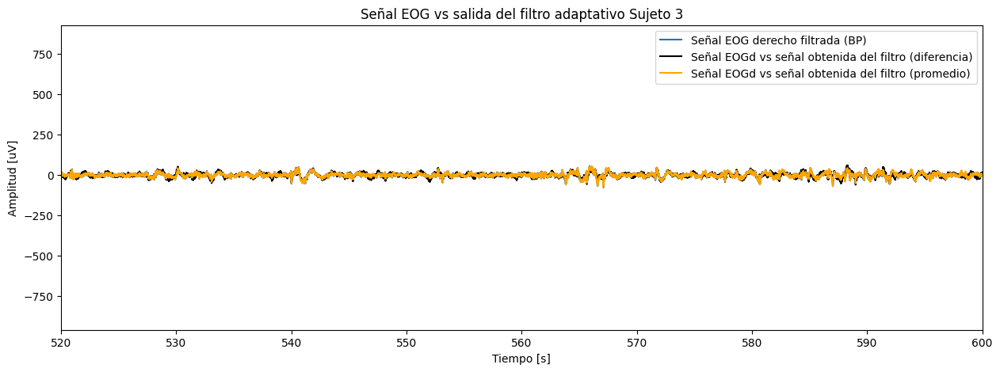

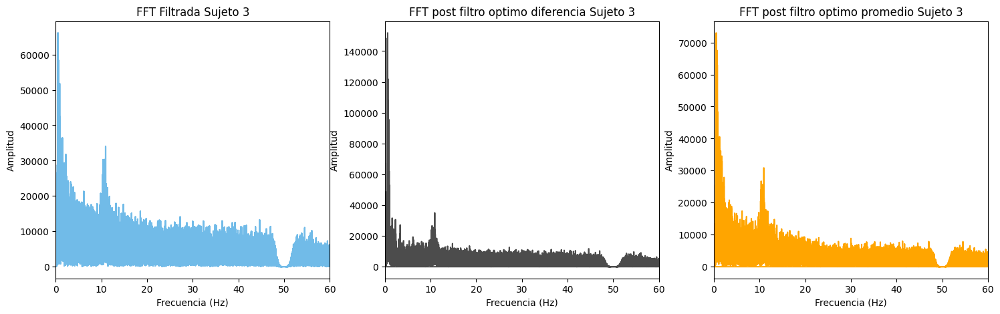

In [ ]:
mostrar_salidas_Pz(senales2,time2,EOG_dif2,EOG_prom2, 'Sujeto 3')

Se puede observar la atenuación en los picos más pronunciados de la señal en tiempo, logrando así una mejora en el pre-procesamiento.

A partir de lo observado arriba, tomamos como referencia para el filtrado adaptativo la señal promediada de EOG.

###Aplicación del filtro adaptativo en todas los canales

In [ ]:
senales_FA = {}



In [ ]:
def filtro_adaptativo(senales, time, EOG_dif, EOG_prom, sujeto):
  senales_FA = {}
  L= 2**10 #orden del filtro
  a=0.1

  Px = np.mean((senales['Pz'])**2) #aproximación de la potencia
  mu = a*(1/(10*L*Px))
  op1 = lms(senales['Pz'],EOG_prom,L,mu)

  Px2 = np.mean((senales['Cz'])**2) #aproximación de la potencia
  mu2 = a*(1/(10*L*Px2))
  op2 = lms(senales['Cz'],EOG_prom,L,mu2)

  Px3 = np.mean((senales['Fz'])**2) #aproximación de la potencia
  mu3 = a*(1/(10*L*Px3))
  op3 = lms(senales['Fz'],EOG_prom,L,mu3)

  filter1 = sp.signal.lfilter(op1, 1, senales['Pz'])
  filter2 = sp.signal.lfilter(op2, 1, senales['Cz'])
  filter3 = sp.signal.lfilter(op3, 1, senales['Fz'])

  senales_FA['Pz'] = senales['Pz']-filter1
  senales_FA['Cz'] = senales['Cz']-filter2
  senales_FA['Fz'] = senales['Fz']-filter3

  if sujeto == 'Sujeto 1':
    fig, (ax1,ax2, ax3) = plt.subplots(3, 1, figsize=(18, 9),sharex=True)
    fig.suptitle('Comparacion Señal filtrada vs original para '+ sujeto, fontsize=15)

    ax1.plot(time, senales['Pz'], label='Señal Pz original')
    ax1.plot(time, senales_FA['Pz'], label='Señal Pz filtrada adaptativamente con promedio EOG', color='orange')
    ax1.set_ylabel('Amplitud [uV]')
    ax1.set_title('Pz filtrado adaptativamente con EOG '+ sujeto)
    ax1.legend(loc='upper left')

    ax2.plot(time, senales['Cz'], label='Señal Cz original')
    ax2.plot(time, senales_FA['Cz'], label='Señal Cz filtrada adaptativamente con promedio EOG', color='green')
    ax2.set_ylabel('Amplitud [uV]')
    ax2.set_title('Cz filtrado adaptativamente con EOG '+ sujeto)
    ax2.legend(loc='upper left')

    ax3.plot(time, senales['Fz'], label='Señal Fz original')
    ax3.plot(time, senales_FA['Fz'], label='Señal Fz filtrada adaptativamente con promedio EOG', color='cyan')
    ax3.set_xlabel('Tiempo [s]')
    ax3.set_ylabel('Amplitud [uV]')
    ax3.set_title('Fz filtrado adaptativamente con EOG '+ sujeto)
    ax3.legend(loc='upper left')


    plt.show()

  plt.rcParams["figure.figsize"] = [18, 8]
  plt.plot(time, senales_FA['Pz'], label='Pz', color='orange')
  plt.plot(time, senales_FA['Cz'] - 150, label='Cz', color='green')
  plt.plot(time, senales_FA['Fz'] - 300, label='Fz', color='cyan')
  plt.title('Señales del EEG a utilizar para el procesado '+ sujeto, fontsize=15)
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud [uV]')
  plt.legend(loc='right')
  plt.xlim(0,time[-1]+50)
  plt.show()


  fft_opPz = np.abs(np.fft.fft(senales['Pz']))
  freq_fft_Pz = np.fft.fftfreq(len(senales_FA['Pz']))*fs

  fft_opCz = np.abs(np.fft.fft(senales['Cz']))
  freq_fft_Cz = np.fft.fftfreq(len(senales_FA['Cz']))*fs

  fft_opFz = np.abs(np.fft.fft(senales['Fz']))
  freq_fft_Fz = np.fft.fftfreq(len(senales_FA['Fz']))*fs

  fig, (ax1,ax2, ax3) = plt.subplots(1, 3, figsize=(18, 5))
  ticks = [i for i in range(0, 65, 5)]
  values = [str(i) for i in range(0, 65, 5)]

  ax1.plot(freq_fft_Pz, fft_opPz, color='orange')
  ax1.set_xlabel('Frecuencia (Hz)')
  ax1.set_ylabel('Amplitud')
  ax1.set_title('FFT Pz ' + sujeto)
  ax1.set_xlim([0, 65])
  ax1.set_xticks(ticks)
  ax1.set_xticklabels(values)

  ax2.plot(freq_fft_Cz, fft_opCz, color = 'green', alpha=0.7)
  ax2.set_xlabel('Frecuencia (Hz)')
  ax2.set_ylabel('Amplitud')
  ax2.set_title('FFT Cz ' + sujeto)
  ax2.set_xlim([0, 65])
  ax2.set_xticks(ticks)
  ax2.set_xticklabels(values)

  ax3.plot(freq_fft_Fz, fft_opFz, color = "cyan")
  ax3.set_xlabel('Frecuencia (Hz)')
  ax3.set_ylabel('Amplitud')
  ax3.set_title('FFT Fz ' + sujeto)
  ax3.set_xlim([0, 65])
  ax3.set_xticks(ticks)
  ax3.set_xticklabels(values)

  plt.show()

  return senales_FA

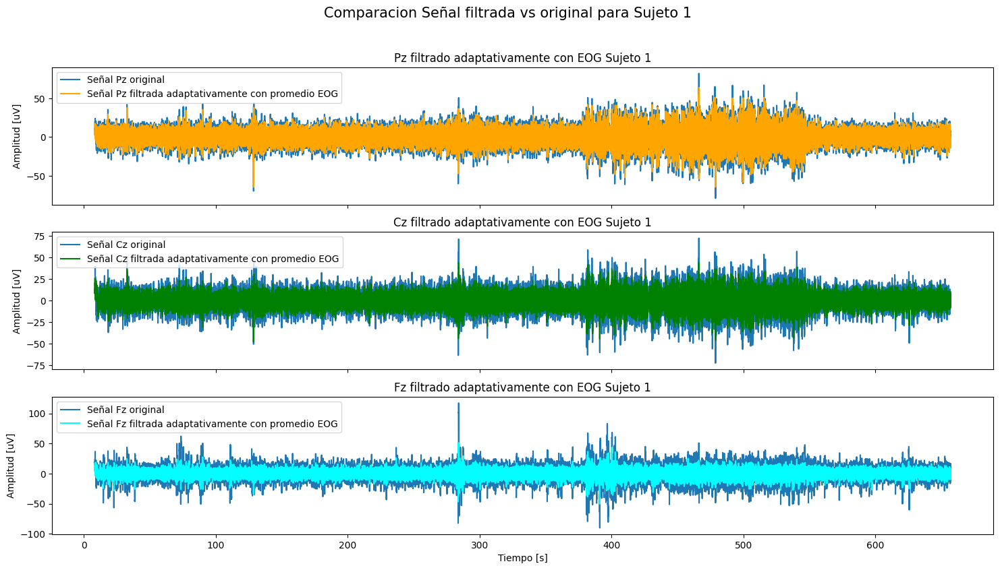

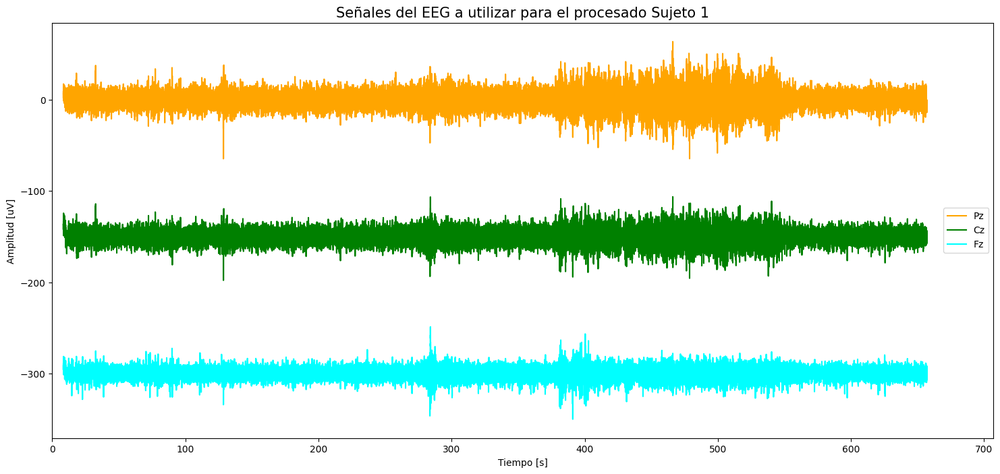

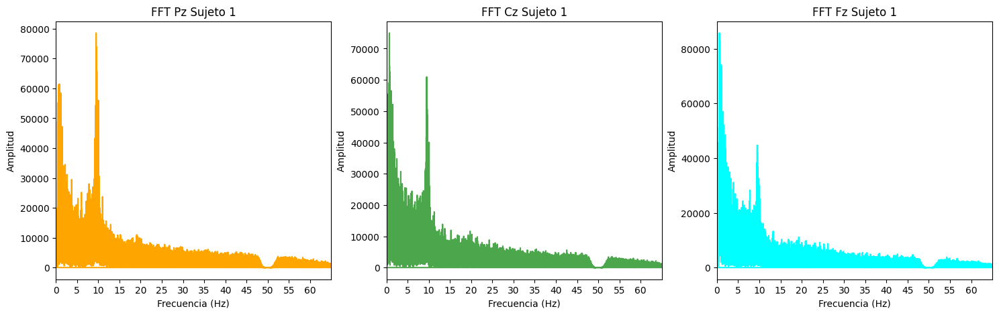

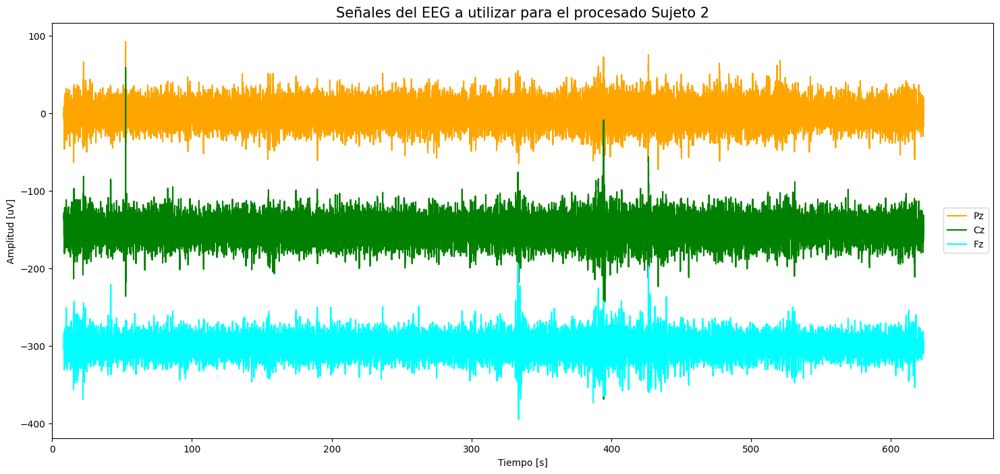

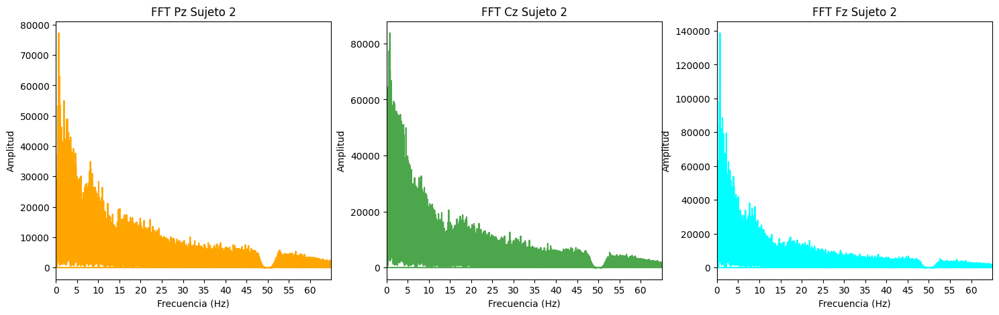

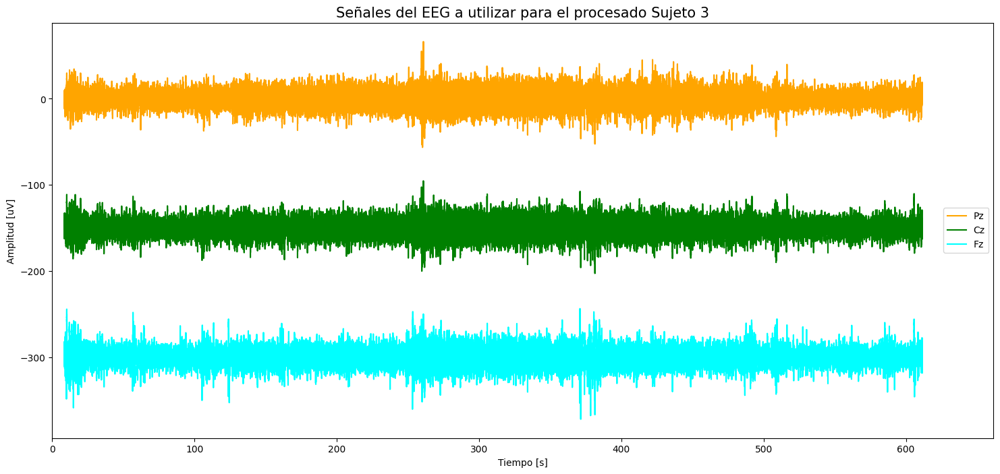

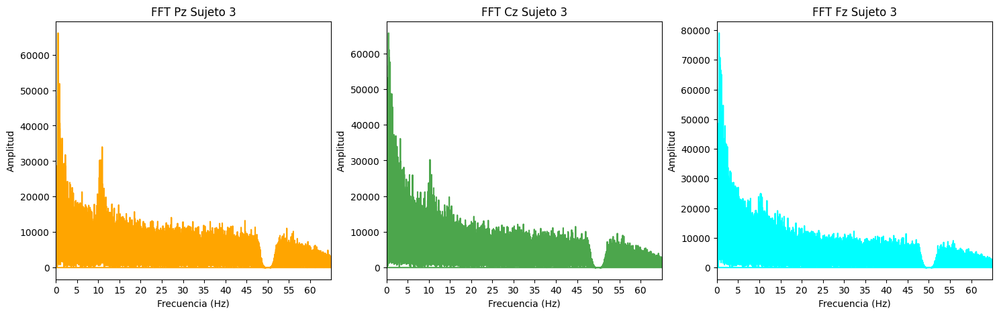

In [ ]:
senales_FA_0 = filtro_adaptativo(senales, time0, EOG_dif0, EOG_prom0, 'Sujeto 1')
senales_FA_1 = filtro_adaptativo(senales1, time1, EOG_dif1, EOG_prom1, 'Sujeto 2')
senales_FA_2 = filtro_adaptativo(senales2, time2, EOG_dif2, EOG_prom2, 'Sujeto 3')

##Procesamiento


##Segmentación por periodograma

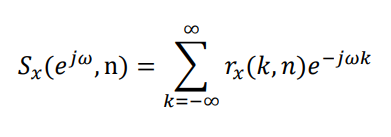

Voy a tener el periodograma desplazado ($r_x(k,n)$) y el de la ventana de referencia ($r_x(k,0)$)



> $n$: posicion variable de la ventana

> $k$: parámetro que indica el desplazamiento para calcular la correlación de la ventana en $n$

**DISIMILITUD** (k desplazamiento, n tiempo donde calculo coeficiente)


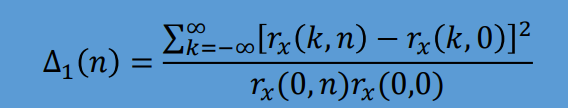

###Primer Abordaje (ventana fija)

####Solo la primera ventana queda fija, no varia la ventana de referencia

In [ ]:
def coef_disimilitud_VF(senal, time, fs,titulo):
  N_win = int(fs) #revisar (empiricamente si asi va bien o conviene que sea más grande la ventana de referencia)
  N_senal = senal.shape[0]

  porcentaje = 0.75 # PORCENTAJE DE SOLAPAMIENTO

  paso =  int((1-porcentaje)*N_win) # 75% de solapamiento  --> (N_win/4)

  s_0 = senal[:N_win] # agarro la primer ventana --> ventana de referencia
  R_0 = np.correlate(s_0,s_0,mode='full')/s_0.shape[0] #Autocorr de la referencia
  R_00 = R_0[int(R_0.shape[0]/2)] #El valor del medio de R

  delta = [] #vector de datos del error espectral

  for i in range(N_win, N_senal-N_win, paso):
    s_N = senal[i:i+N_win]
    R_N = np.correlate(s_N,s_N,mode='full')/s_N.shape[0]    #al dividir por la longitud lo normalizo.
    R_N0 = R_N[int(R_N.shape[0]/2)]
    d = np.sum((R_N-R_0)**2)/(R_N0*R_00)
    delta.append(d)


  delta = delta/max(delta)
  senal = senal/max(senal)

  delta_0 = scipy.signal.resample(delta, int(senal.shape[0]/fs)) # resampleo (cambio freq de muestreo)para poder graficar
  x = np.arange(8, dtype=np.double)
  a=np.full_like(x, np.mean(delta_0))
  delta_1=np.concatenate((a,delta_0),axis=None)

  plt.figure(figsize=(18,5)) # Se pierden las escalas de amplitud del gráfico para mejorar la comparación
  plt.title(f'Periodograma móvil {titulo}')
  plt.plot(time,senal,'gray',label=f'{titulo}')
  plt.plot(delta_1,'red',linewidth=2,label=f'Delta {titulo}')
  plt.legend(loc='upper right')
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud normalizada')
  plt.vlines(x=120, ymin=-2, ymax=2)
  plt.vlines(x=385, ymin=-2, ymax=2)
  plt.vlines(x=540, ymin=-2, ymax=2)
  plt.ylim(-1.2,1.2)
  plt.show()

  return delta, senal, delta_1

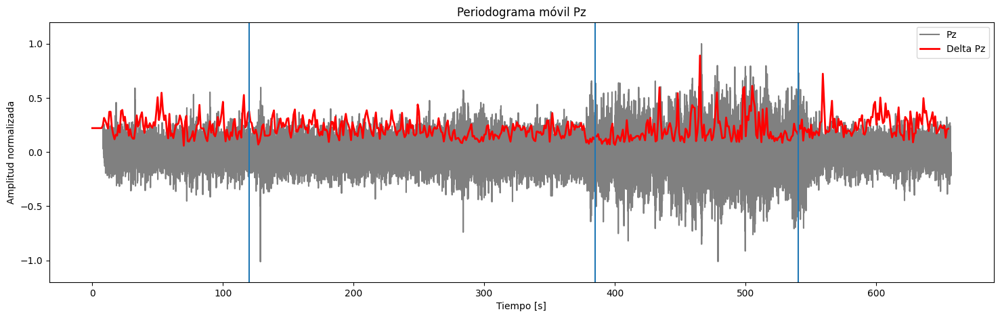

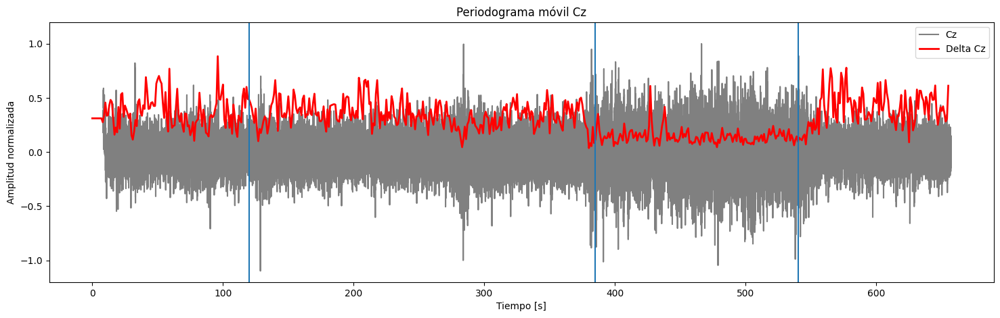

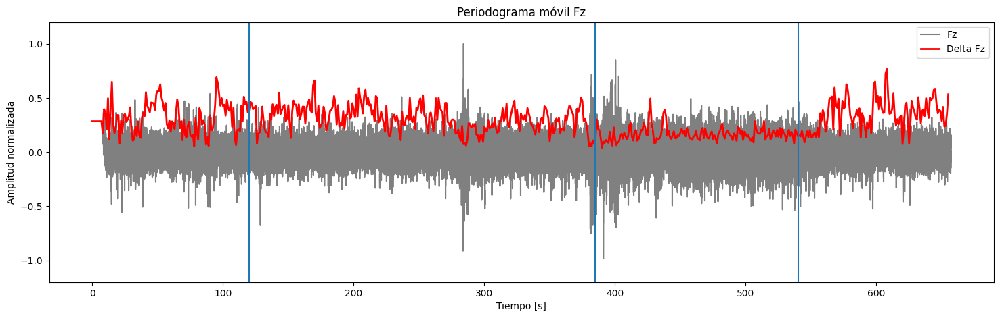

In [ ]:
delta_Pz_pVF, senal_Pz_pVF, delta1_Pz_pVF = coef_disimilitud_VF(senales_FA_0['Pz'],time0, fs,'Pz')
delta_Cz_pVF, senal_Cz_pVF, delta1_Cz_pVF = coef_disimilitud_VF(senales_FA_0['Cz'],time0, fs,'Cz')
delta_Fz_pVF, senal_Fz_pVF, delta1_Fz_pVF = coef_disimilitud_VF(senales_FA_0['Fz'],time0,fs,'Fz')

In [ ]:
def periodograma_movil_Ref_Fija(delta, senal, titulo, delta1, factor, time):
  umbral = factor*max(delta1)

  segm = {}
  ies = []
  c=0
  j=0
  k=1
  aux=np.array([])
  for i in range(len(delta1)):
    if delta[i] > umbral:
      c+=1
      while c==1:       #revisar
        if delta[i+1] > umbral:
          if (len(senal[j*fs:i*fs])>50*fs):
            if(aux.shape!=0):
              senalsita=np.concatenate((aux,senal[j*fs:i*fs]),axis=None)
              aux=np.array([])
            else:
              senalsita=senal[j*fs:i*fs]

            segm[f'Segmento{k}'] = (senalsita)
            ies.append(i)
            k+=1

          else:
            aux= np.append(aux,senal[j*fs:i*fs])
          c+=1
          j=i
        else:
          c=0
    else:
      c=0

  ies.append(i)
  segm[f'Segmento{k}'] = senal[j*fs:i*fs]
  tiempito=np.linspace(0,int(len(delta1)),int(len(delta1)))

  j=0
  k=1
  for i in ies:
    plt.figure(figsize=(10,5))
    plt.plot(time[j*fs:i*fs],segm[f'Segmento{k}'])
    plt.title(f'Segmento {k} de {titulo}: corte de {j} a {i} segundos')
    plt.show()
    j=i
    k+=1

  return segm

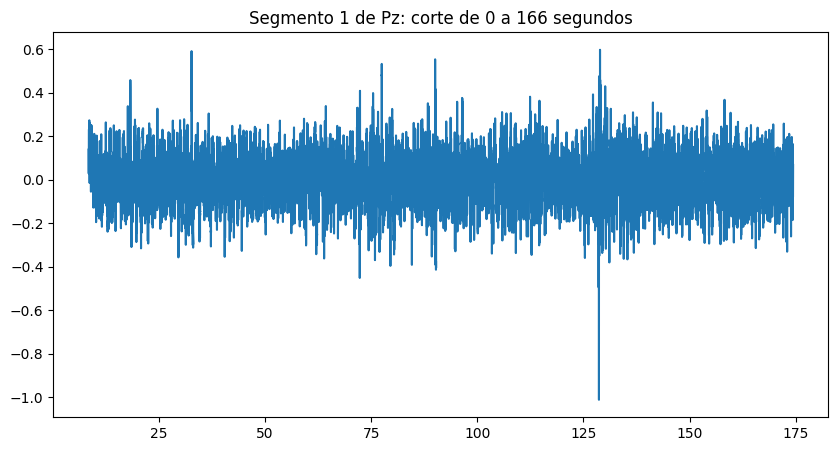

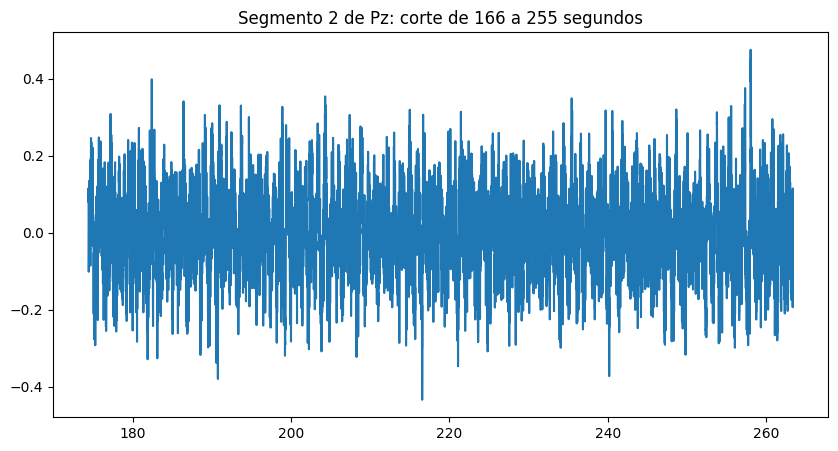

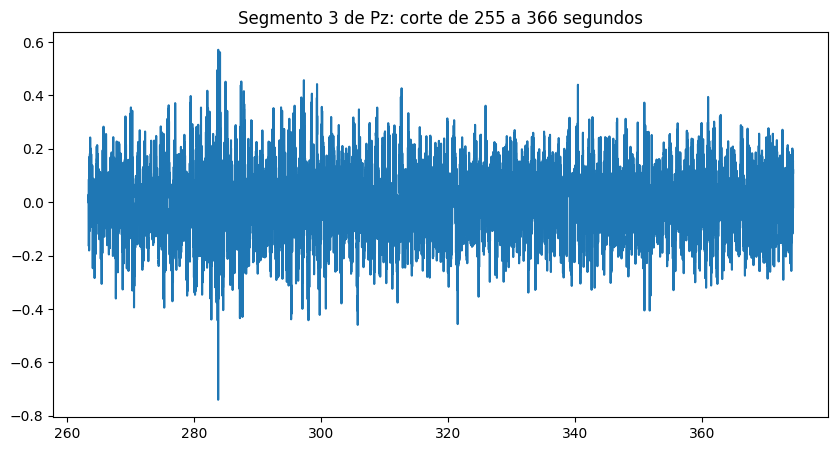

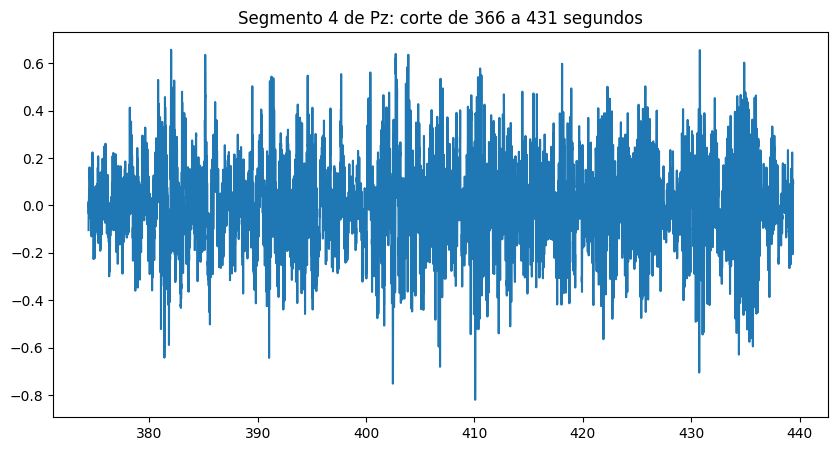

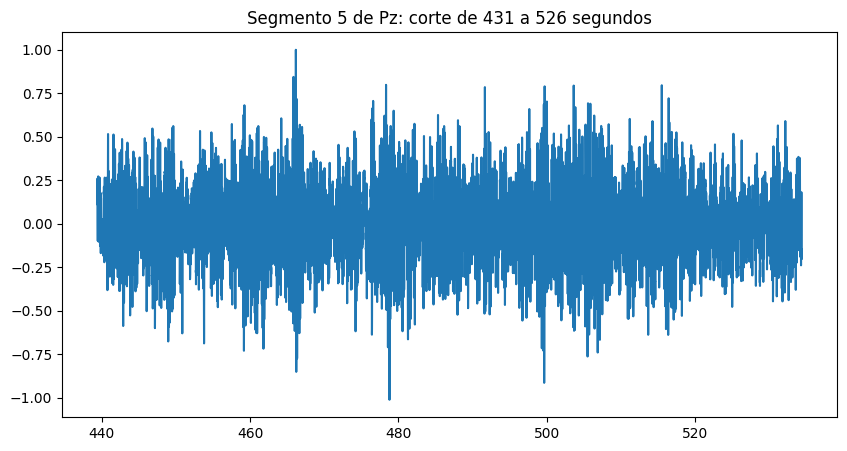

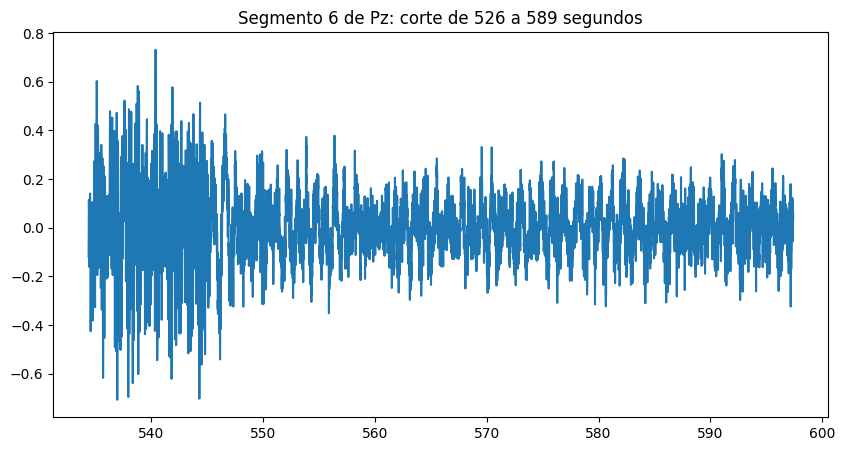

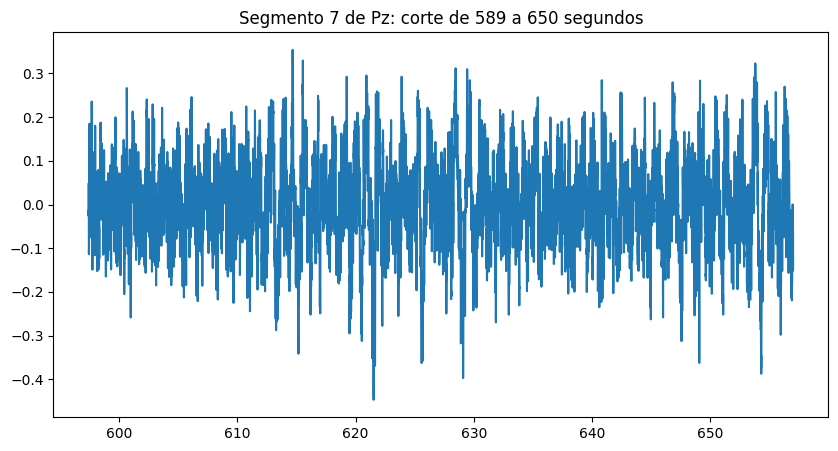

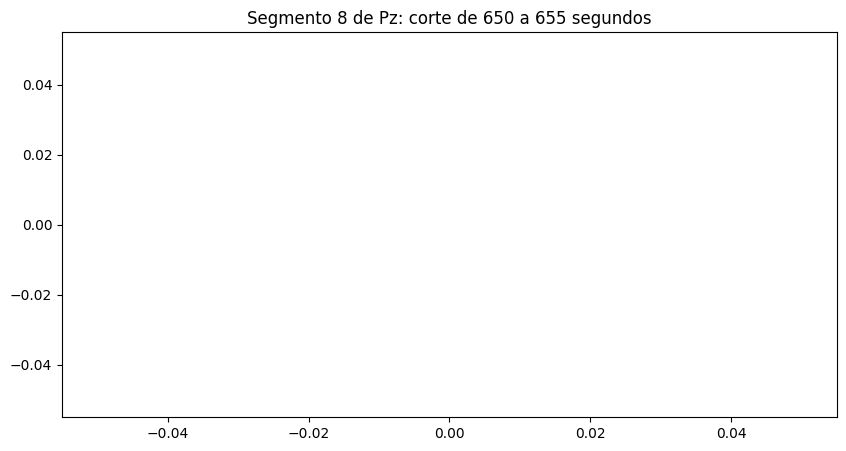

In [ ]:
period_Pz_0 = periodograma_movil_Ref_Fija(delta_Pz_pVF, senal_Pz_pVF, 'Pz', delta1_Pz_pVF,0.45, time0)

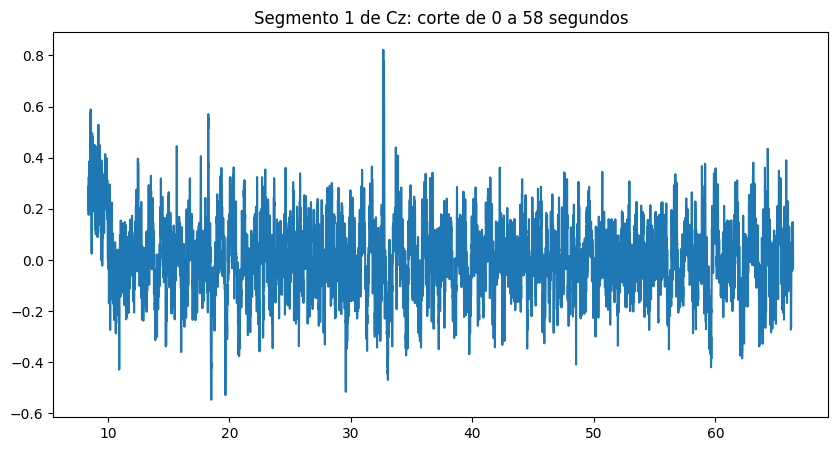

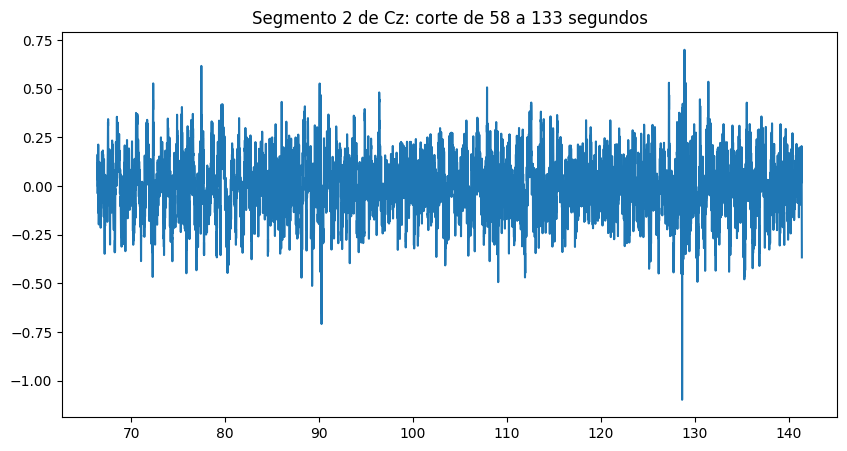

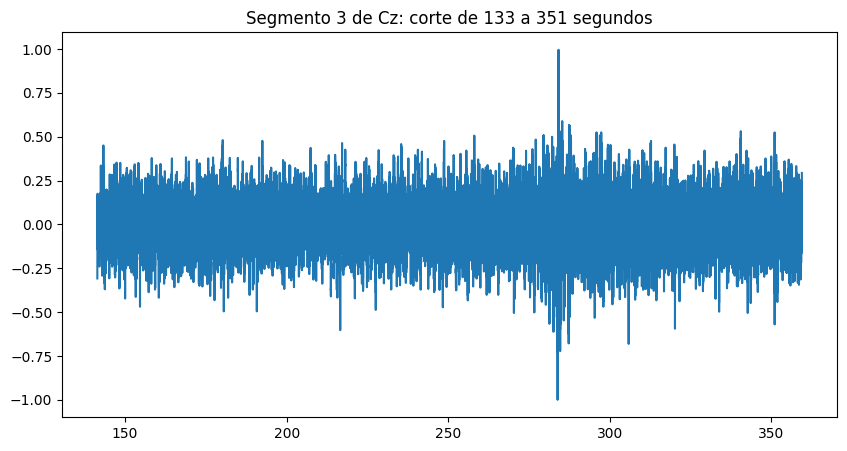

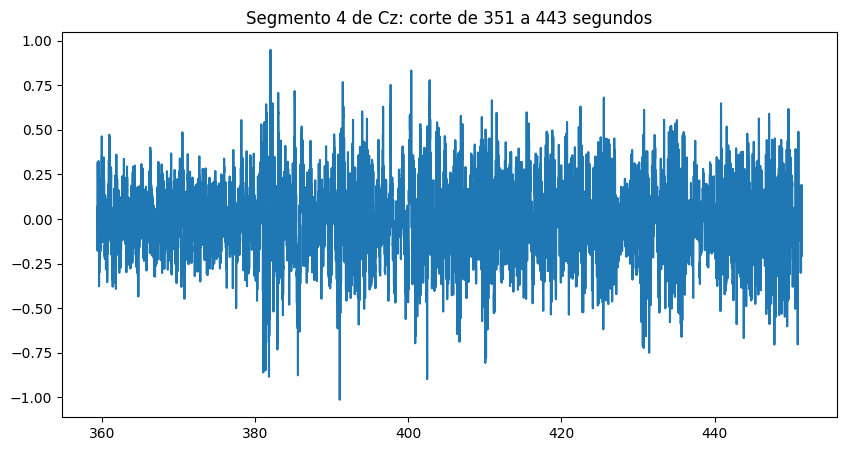

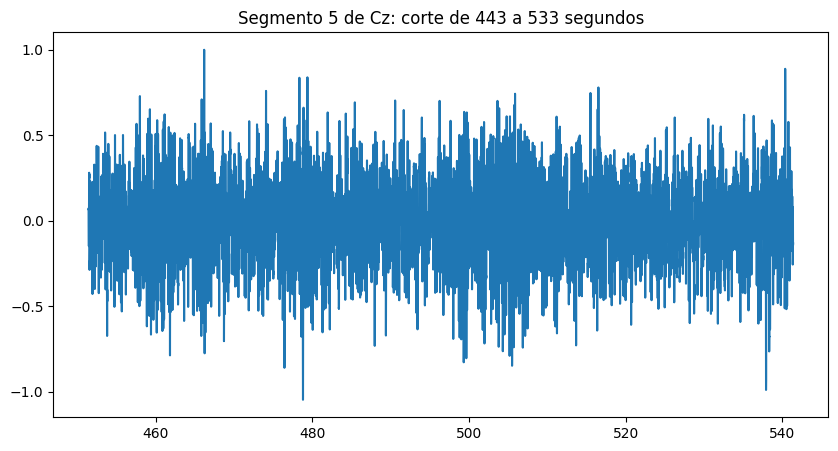

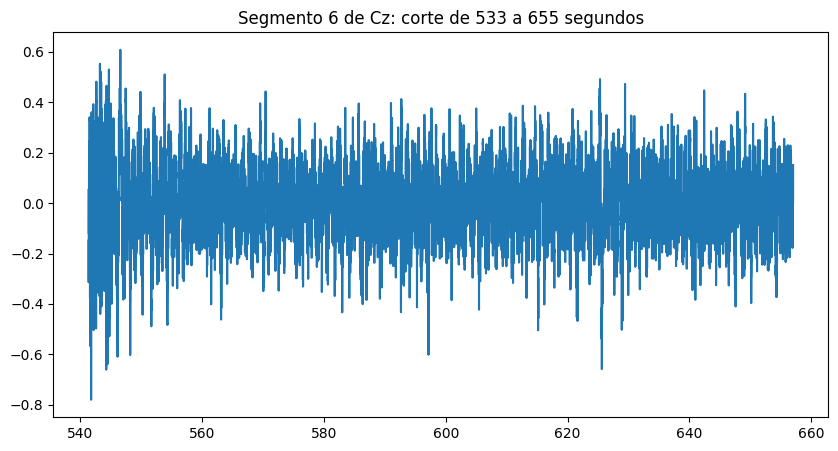

In [ ]:
period_Cz = periodograma_movil_Ref_Fija(delta_Cz_pVF, senal_Cz_pVF, 'Cz', delta1_Cz_pVF,0.7, time0) #seguir revisando umbral y tiempo en esperar a que supere. (solapamiento?)

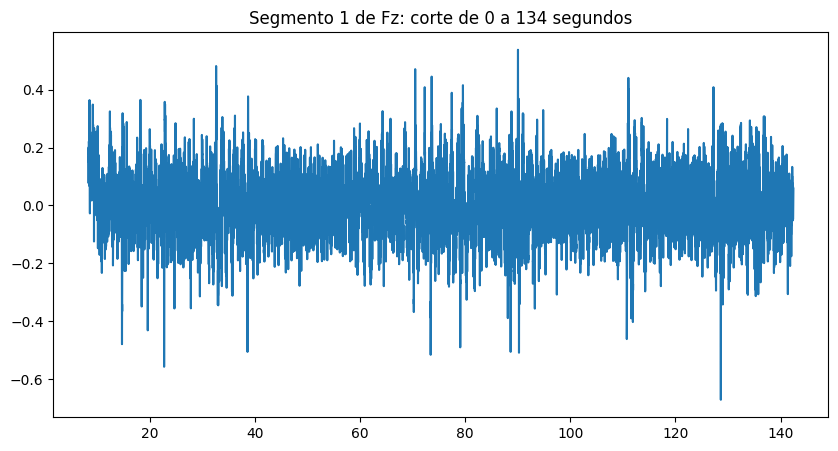

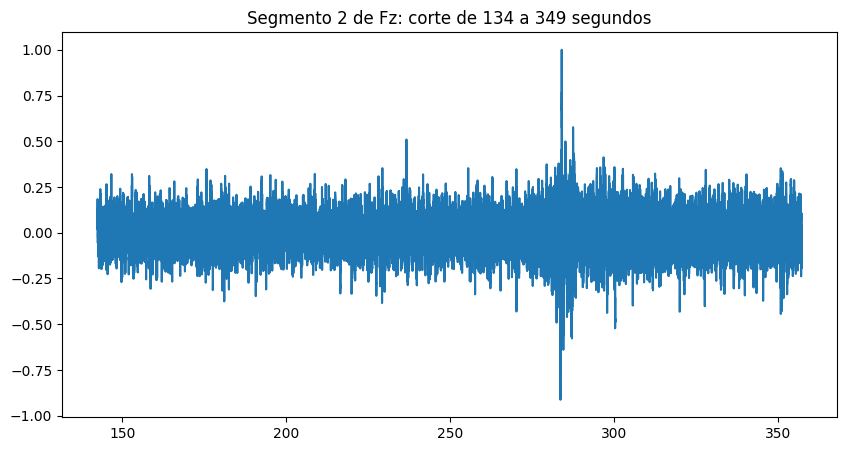

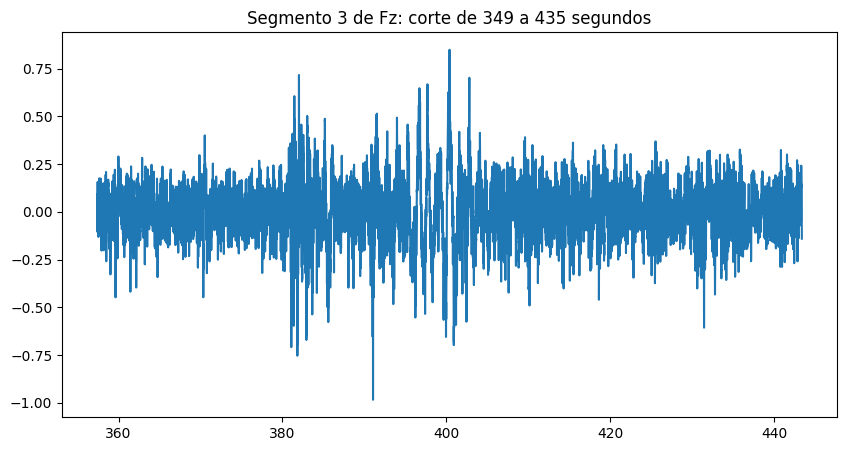

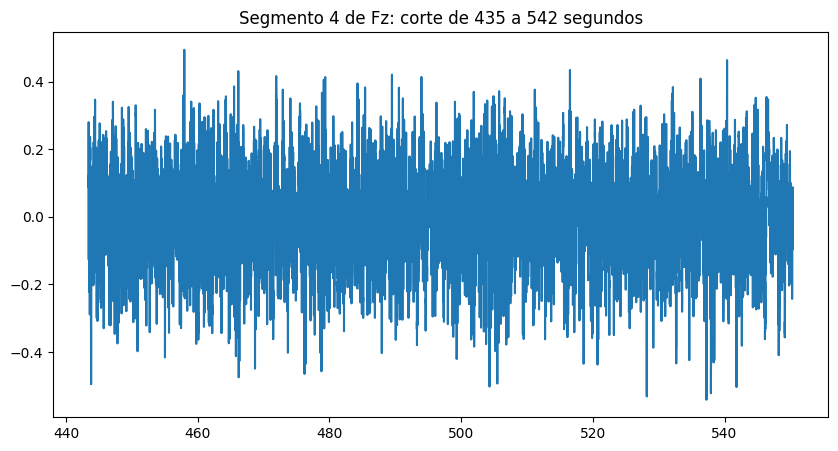

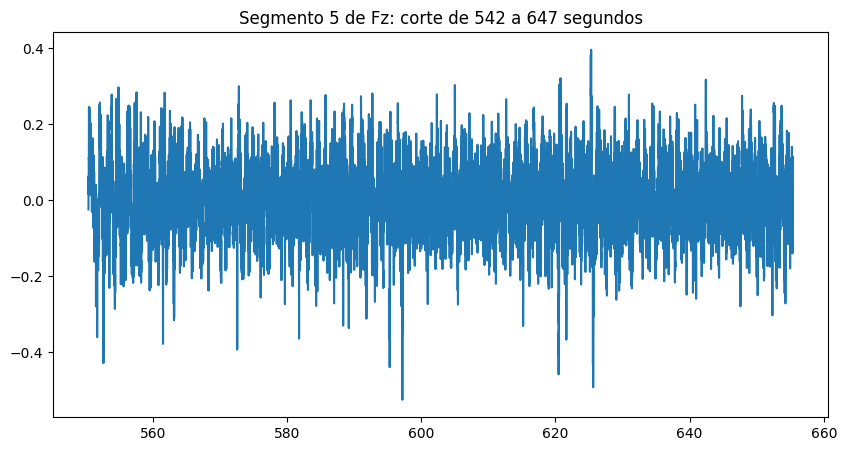

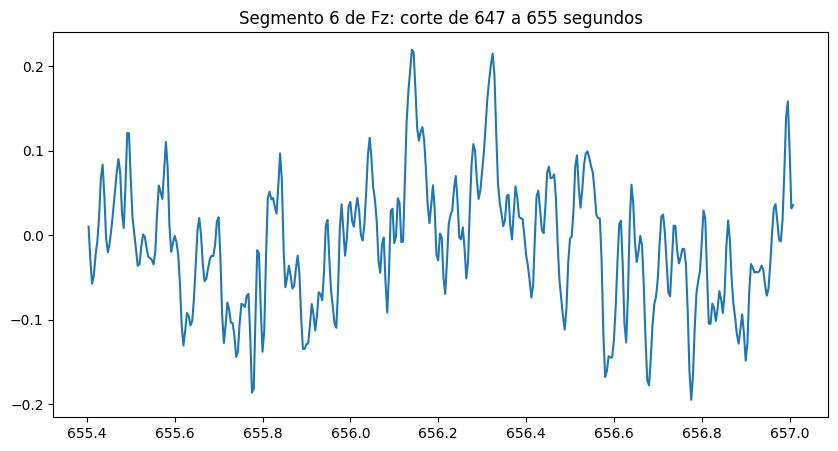

In [ ]:
period_Fz = periodograma_movil_Ref_Fija(delta_Fz_pVF, senal_Fz_pVF, 'Fz', delta1_Fz_pVF, 0.7, time0)

## Segmentacion online

Acontinuación se segmenta de manera online utilizando como referencia el promedio del vector que almacena los coeficientes de disimilut. Una vez que se encuentra una diferencia grande entre el coeficiente calculado y el promedio de los anteriores, se corta la señal y se grafica.

In [ ]:
def coef_disimilitud_VF(senal,fs, factor, N_win, msj, long):
  #N_win = int(fs) #revisar (empiricamente si asi va bien o conviene que sea más grande la ventana de referencia)
  N_senal = senal.shape[0]
  count=0
  count_2=0

  porcentaje = 0.5 # PORCENTAJE DE SOLAPAMIENTO
  save=len(senal)

  paso =  int((1-porcentaje)*N_win) # 75% de solapamiento  --> (N_win/4)

  s_0 = senal[:N_win] # agarro la primer ventana --> ventana de referencia
  R_0 = np.correlate(s_0,s_0,mode='full')/s_0.shape[0] #Autocorr de la referencia
  R_00 = R_0[int(R_0.shape[0]/2)] #El valor del medio de R

  delta = [] #vector de datos del error espectral

  for i in range(N_win, N_senal-N_win, paso):
    s_N = senal[i:i+N_win]
    R_N = np.correlate(s_N,s_N,mode='full')/s_N.shape[0]    #al dividir por la longitud lo normalizo.
    R_N0 = R_N[int(R_N.shape[0]/2)]
    d = np.sum((R_N-R_0)**2)/(R_N0*R_00)
    delta.append(d)

    promedio = np.mean(delta)

    if (d >= factor*promedio):
      if (count!=0 and i==salvo+paso):
        count+=1
        salvo = i
      else:
        count=1
        salvo=i
      if (count>=long):
        save=i
        break

  delta = delta/max(delta)
  cut = senal[:save]/max(senal[:save])

  delta_0 = scipy.signal.resample(delta, int(senal[:save].shape[0]/fs)) # resampleo (cambio freq de muestreo)para poder graficar
  if msj:
    x = np.arange(8, dtype=np.double)
    a=np.full_like(x, np.mean(delta_0))
    delta_1=np.concatenate((a,delta_0),axis=None)
  else:
    delta_1=delta_0

  return cut, delta_1, save

In [ ]:
def segmentador_online(senal, titulo, fs, factor, N_win, long):
  segm={}
  flag=True
  last=0
  last_2=0
  aux=np.array([])
  aux_delta=np.array([])

  while (len(senal)>0):
    if last==0:
      msj=True
    else: msj=False

    senal_cut, delta_1, i = coef_disimilitud_VF(senal, fs, factor, N_win, msj, long)
    senal=senal[i:]

    if(aux.shape!=0): #si aux no esta vacio lo appendeo en mi señal
      senal_cut=np.concatenate((aux,senal_cut),axis=None)
      delta_1=np.concatenate((aux_delta,delta_1), axis=None)

    if (len(senal_cut)<80*fs): #me fijo si mi señal es muy chica de ser asi mi señal pasa al aux y no hago nada
      aux= senal_cut
      aux_delta=delta_1
    else: #si mi señal es lo suficientemente grande printeo y aux se hace cero
      aux=np.array([])
      aux_delta=np.array([])

      last_2 += len(senal_cut)/fs

      time=np.linspace(last,last_2,int(len(senal_cut)))
      tiempo=np.linspace(last,last_2,int(len(delta_1)))

      last=last_2

      plt.figure(figsize=(14,3)) # Se pierden las escalas de amplitud del gráfico para mejorar la comparación
      plt.title(f'Periodograma móvil {titulo}')
      plt.plot(time,senal_cut,'gray',label=f'{titulo}')
      plt.plot(tiempo,delta_1,'red',linewidth=2,label=f'Delta {titulo}')
      plt.legend(loc='lower right')
      plt.xlabel('Tiempo [s]')
      plt.ylabel('Amplitud normalizada')
      plt.show()

  if(aux.shape!=0 and len(aux)>10*fs):
    senal_cut = aux
    delta_1 = aux_delta
    last_2 += len(senal_cut)/fs

    time=np.linspace(last,last_2,int(len(senal_cut)))
    tiempo=np.linspace(last,last_2,int(len(delta_1)))

    plt.figure(figsize=(14,3)) # Se pierden las escalas de amplitud del gráfico para mejorar la comparación
    plt.title(f'Periodograma móvil {titulo}')
    plt.plot(time,senal_cut,'gray',label=f'{titulo}')
    plt.plot(tiempo,delta_1,'red',linewidth=2,label=f'Delta {titulo}')
    plt.legend(loc='lower right')
    plt.xlabel('Tiempo [s]')
    plt.ylabel('Amplitud normalizada')
    plt.show()

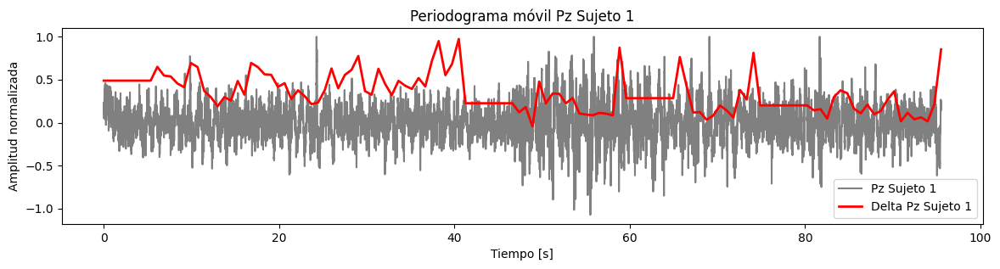

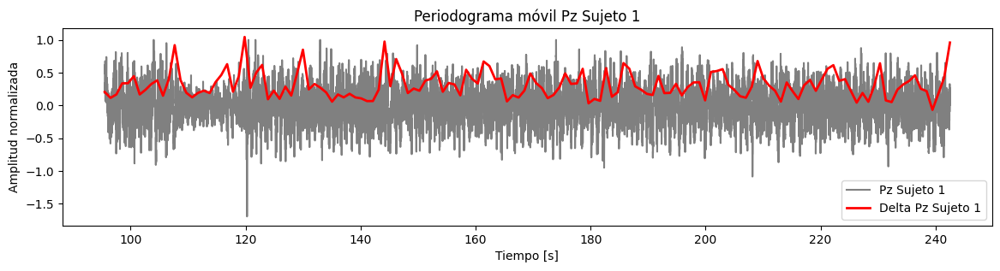

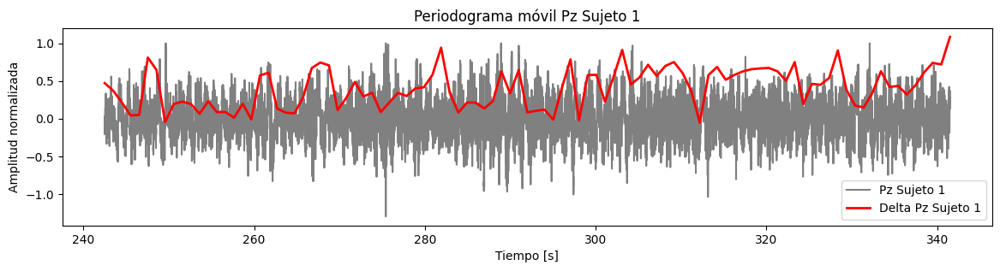

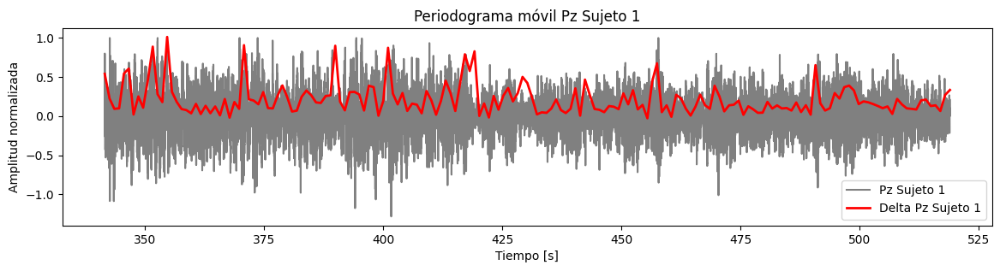

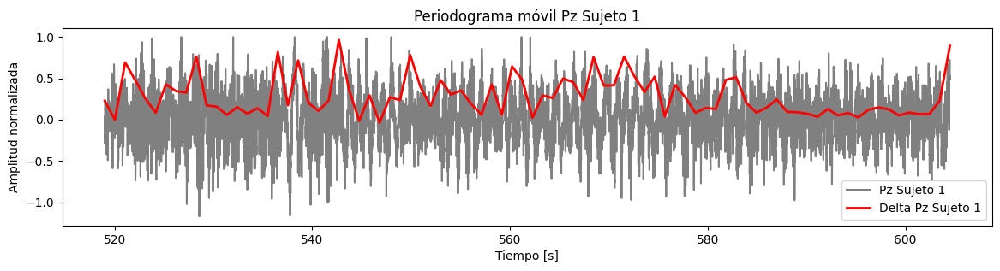

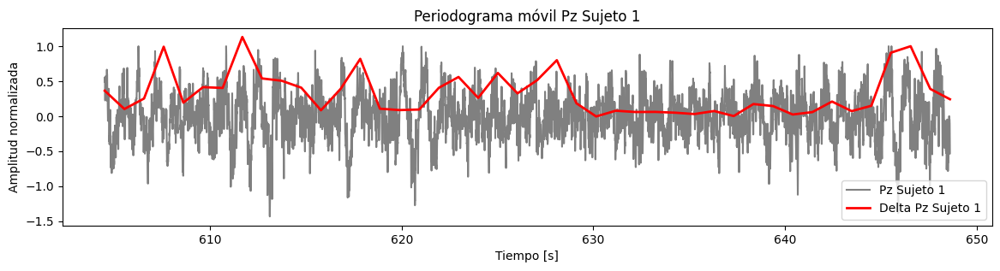

In [ ]:
segmentador_online(senales_FA_0['Pz'], 'Pz Sujeto 1', fs, 1.665, int(fs), 3)

#el primer parametro es la señal, el segundo el nombre para el titulo del gráfico, el tercero la frecuencia de muestreo
#el cuarto parámetro es el factor para distinguir maximos-> factor*promedio del la delta y minimos-> (2-factor)*promedio de la delta
#el quinto es el tamaño de la ventana de muestreo que se puede ajustar si se necesita más o menos precision
#el último es la cantidad de muestras que tiene que encontrar que superen el umbral para cortar, tener en cuenta que como es en delta son pocas muestras

## Segmentacion offline

In [ ]:
def disimilitud_periodograma(senal, time, fs, N_wini, N_winf, titulo):
  N_win = int(fs) #revisar (empiricamente si asi va bien o conviene que sea más grande la ventana de referencia)
  N_senal = senal.shape[0]

  porcentaje = 0.75 # PORCENTAJE DE SOLAPAMIENTO
  paso =  int((1-porcentaje)*N_win) # 75% de solapamiento  --> (N_win/4)
  s_0 = senal[N_wini:N_winf] # agarro la primer ventana --> ventana de referencia
  R_0 = np.correlate(s_0,s_0,mode='full')/s_0.shape[0] #Autocorr de la referencia
  R_00 = R_0[int(R_0.shape[0]/2)] #El valor del medio de R

  delta = [] #vector de datos del error espectral

  for i in range(N_winf, N_senal-N_win, paso):
    s_N = senal[i:i+N_win]
    R_N = np.correlate(s_N,s_N,mode='full')/s_N.shape[0]    #al dividir por la longitud lo normalizo.
    R_N0 = R_N[int(R_N.shape[0]/2)]
    d = np.sum((R_N-R_0)**2)/(R_N0*R_00)
    delta.append(d)

  delta = delta/max(delta)
  senal = senal/max(senal)

  delta_0 = scipy.signal.resample(delta, int(senal[N_wini:].shape[0]/fs)) # resampleo (cambio freq de muestreo)para poder graficar
  if N_wini == 0:
    x = np.arange(8, dtype=np.double)
    a=np.full_like(x, np.mean(delta_0))
    delta_1=np.concatenate((a,delta_0),axis=None)
  else:
    delta_1=delta_0

  y = np.arange(8+int((senal.shape[0]/fs)-len(delta_1)), dtype=np.double)
  agregar0=np.full_like(y, 0)
  delta1_plot=np.concatenate((agregar0,delta_1),axis=None)

  tiempito=np.linspace(0,int(len(delta1_plot)),int(len(delta1_plot)))

  factor = 2*np.mean(delta1_plot[int(N_winf/fs):])
  umbral = factor*max(delta1_plot)


  plt.figure(figsize=(18,5)) # Se pierden las escalas de amplitud del gráfico para mejorar la comparación
  plt.title(f'Periodograma móvil {titulo}')
  plt.plot(time,senal,'gray',label=f'{titulo}')
  plt.plot(tiempito[:],delta1_plot,'red',linewidth=2,label=f'Delta {titulo}')
  plt.legend(loc='upper right')
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud normalizada')
  plt.hlines(y=umbral, xmin=0, xmax=len(delta1_plot), color='yellow')
  plt.show()

  return delta, senal, delta1_plot, umbral

In [ ]:
def segmentador(senal, time, titulo):
  segm = {}
  delta1s = {}
  ies = []
  c=0
  j=0
  k=1
  aux=np.array([])
  delta, senal, delta1s[f'Segmento{k}'], umbral=disimilitud_periodograma(senal, time, fs,N_wini=0,N_winf=fs,titulo=titulo)

  for i in range(len(delta1s[f'Segmento{k}'])-2):
    if delta1s[f'Segmento{k}'][i] > umbral:
      c+=1
      while c==1:
        if delta1s[f'Segmento{k}'][i+1] > umbral:
          if (len(senal[j*fs:i*fs])>80*fs or (len(aux)+len(senal[j*fs:i*fs]))>80*fs and len(delta1s[f'Segmento{k}'][i:])>65 and len(delta1s[f'Segmento{k}'][i:])!=0.0):
            if(aux.shape!=0):
              senalsita=np.concatenate((aux,senal[j*fs:i*fs]),axis=None)
              aux=np.array([])
            else:
              senalsita=senal[j*fs:i*fs]


            segm[f'Segmento{k}'] = (senalsita)
            ies.append(i)
            k+=1
            delta, senal,  delta1s[f'Segmento{k}'], umbral = disimilitud_periodograma(senal, time, fs,N_wini=i*fs,N_winf=(i*fs)+fs,titulo=titulo)
          else:
            aux= np.append(aux,senal[j*fs:i*fs])
          c+=1
          j=i
        else:
          c=0
    else:
      c=0

  ies.append(i)
  segm[f'Segmento{k}'] = senal[ies[-2]*fs:i*fs]

  tiempito=np.linspace(8,int(len(delta1s[f'Segmento1'])),int(len(delta1s[f'Segmento1'])))


  j=0
  k=1
  for i in ies:

    plt.figure(figsize=(10,5))
    plt.plot(time[j*fs:i*fs],segm[f'Segmento{k}'])
    plt.plot(tiempito[j:i],delta1s[f'Segmento{k}'][j:i],'red')
    plt.title(f'Segmento {k} de {titulo}: corte de {j} a {i} segundos')
    plt.show()
    j=i
    k+=1

  return segm, delta1s, ies

######Sujeto 1

Esperamos los cortes alrededor de:
*   120-150 segundos. También se tiene en cuenta alrededor de los 240 segundos, ya que ahí estuvo el esfuerzo más intenso de concentración.
*   385-435 segundos
*   540 segundos

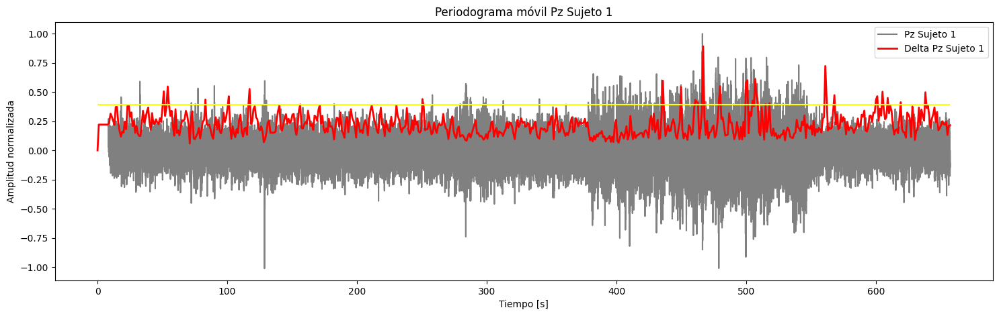

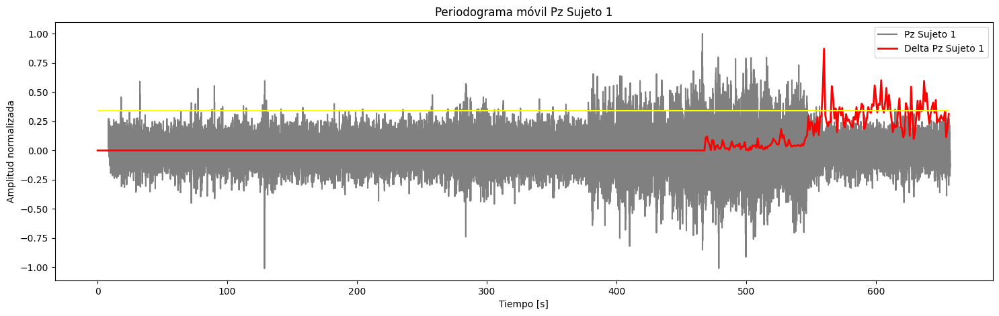

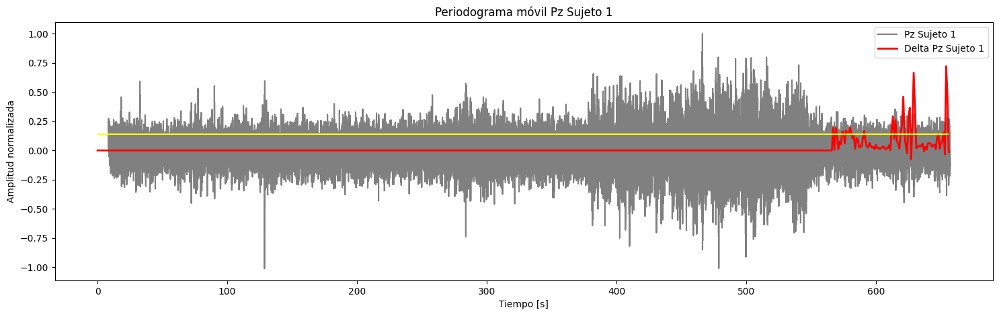

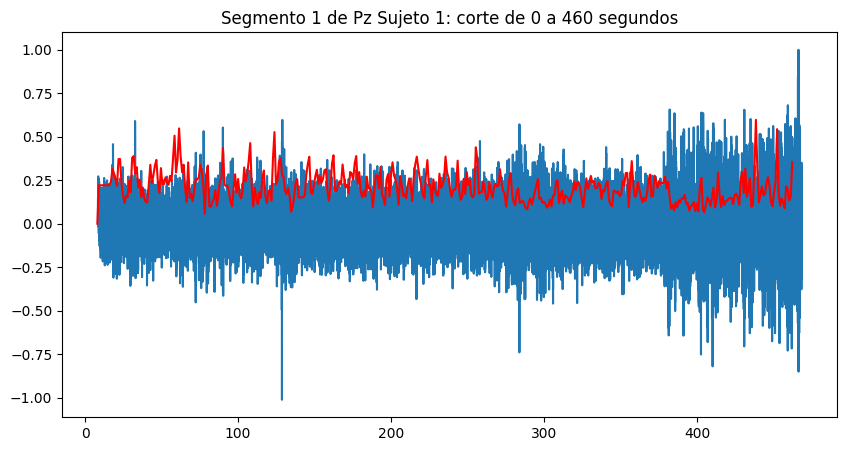

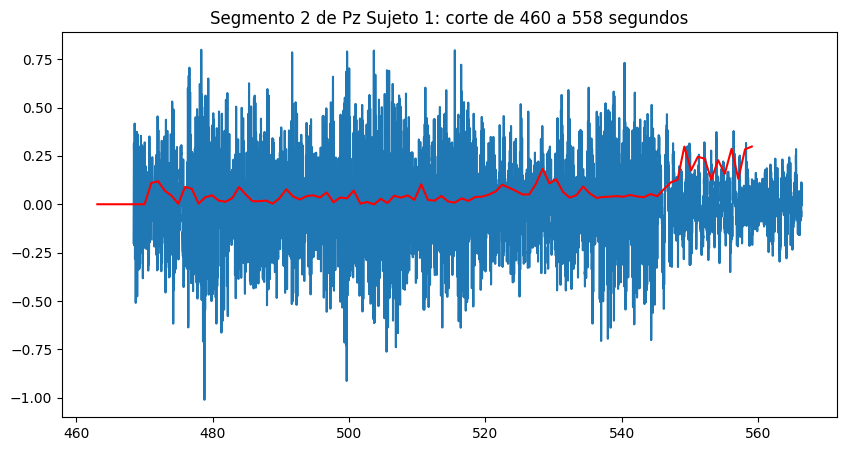

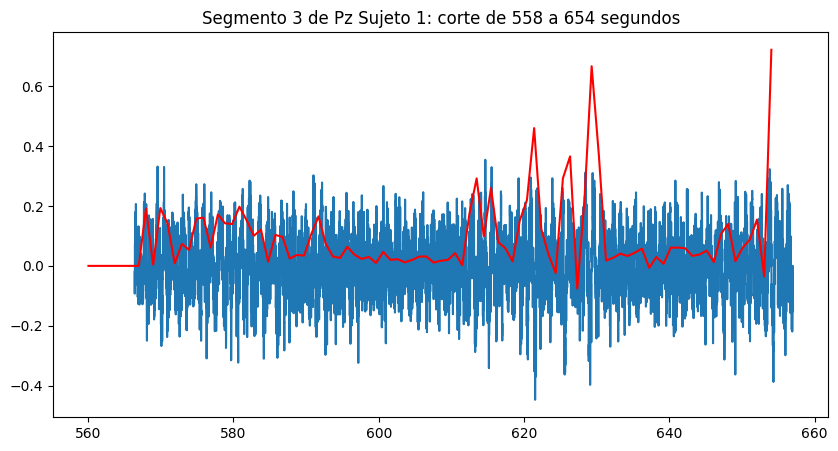

In [ ]:
period_Pz_0, deltas1_Pz_0, ies_Pz_0 = segmentador(senales_FA_0['Pz'], time0, 'Pz Sujeto 1')

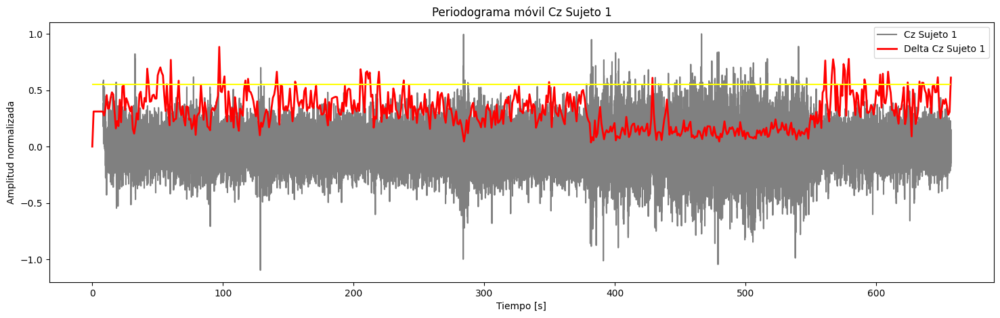

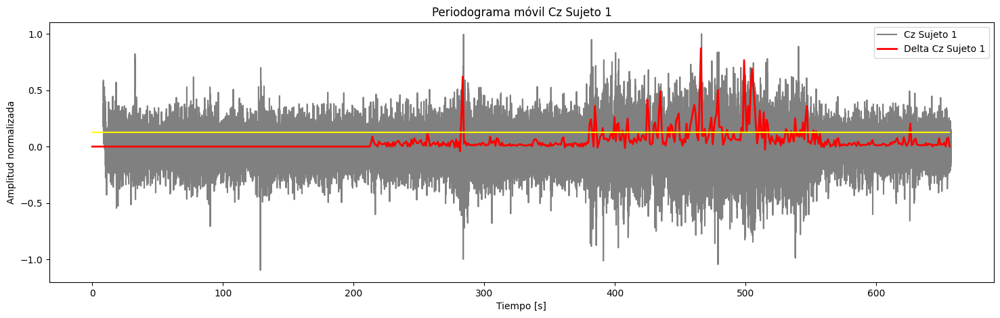

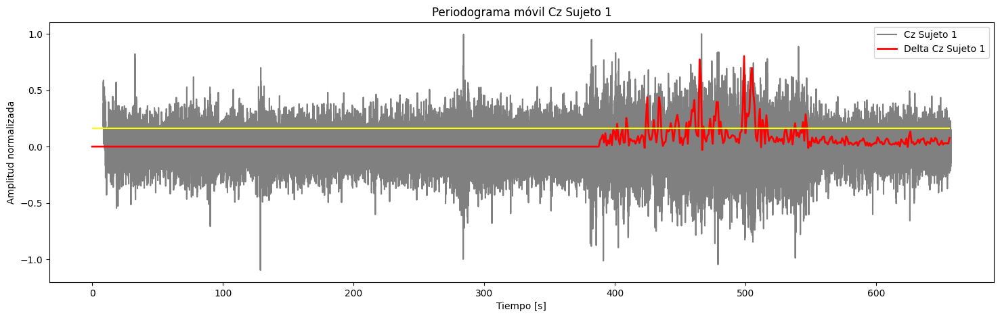

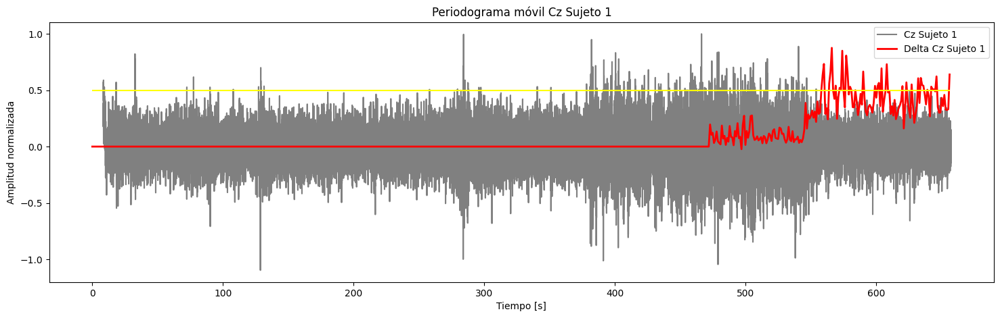

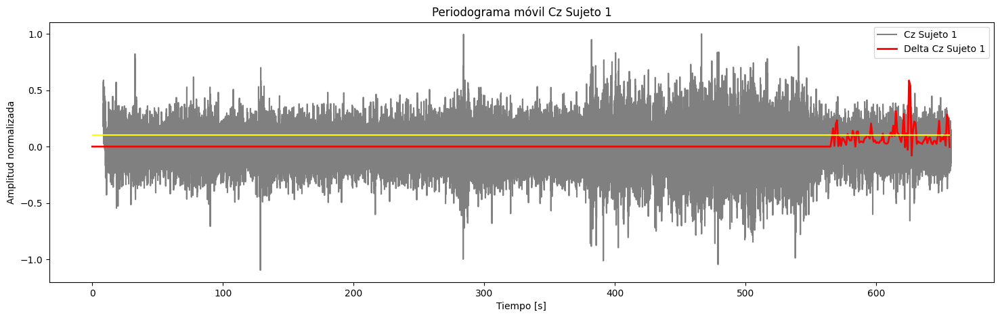

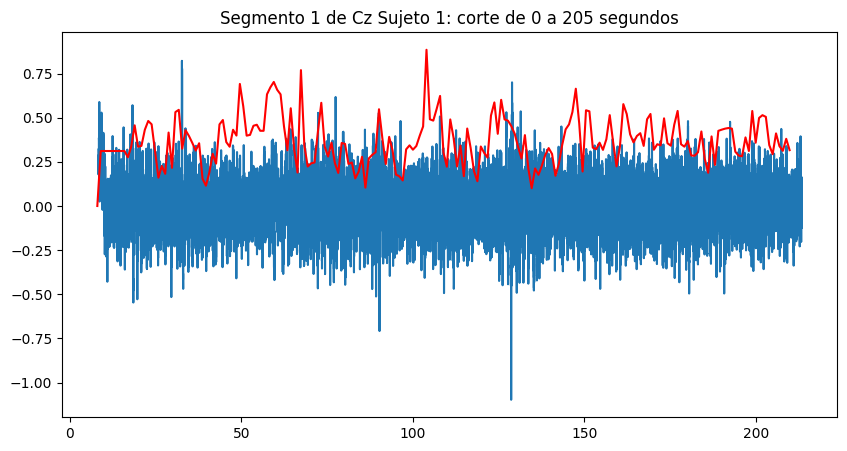

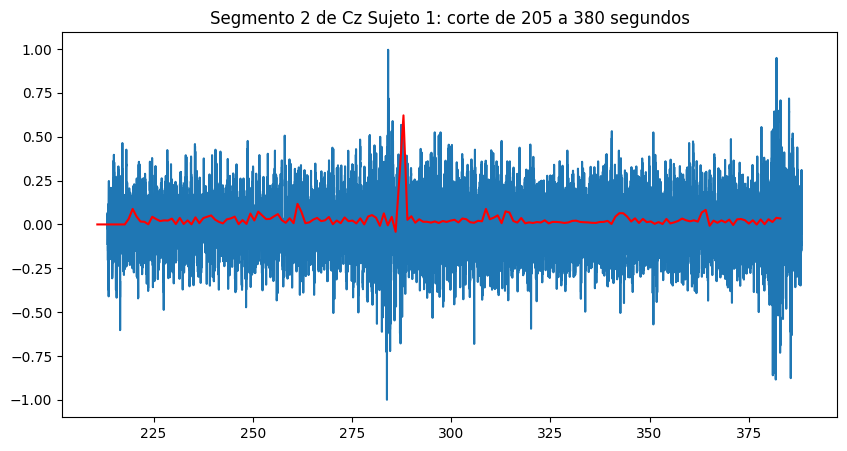

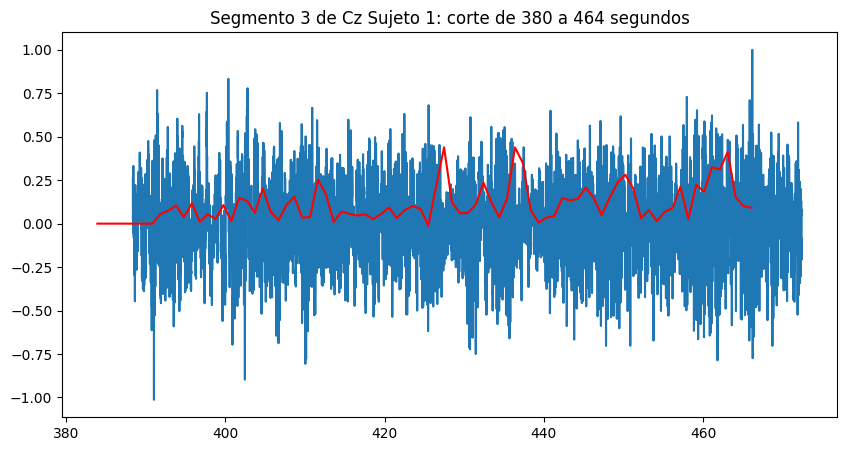

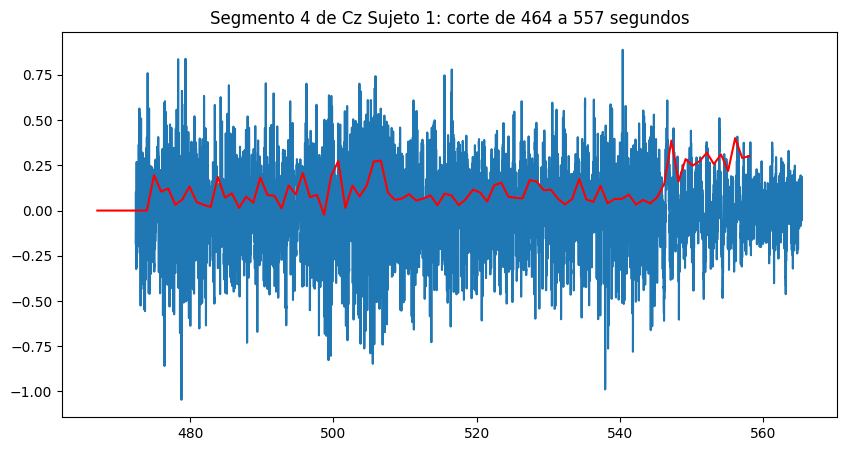

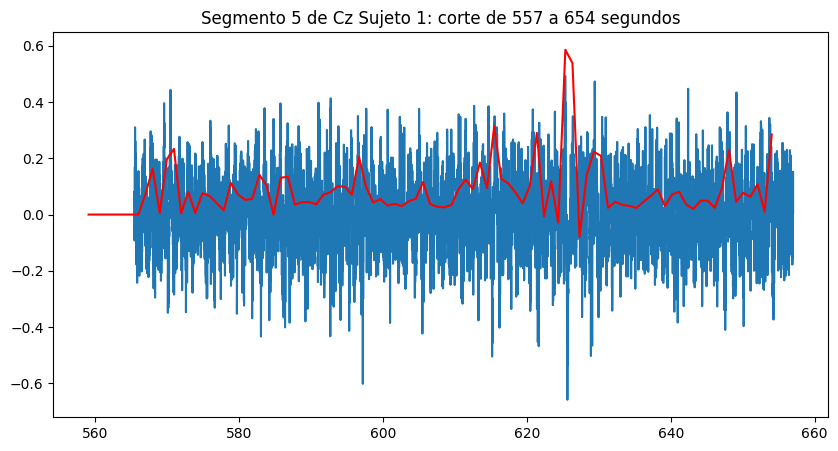

In [ ]:
period_Cz_0, deltas1_Cz_0, ies_Cz_0= segmentador(senales_FA_0['Cz'], time0, 'Cz Sujeto 1')

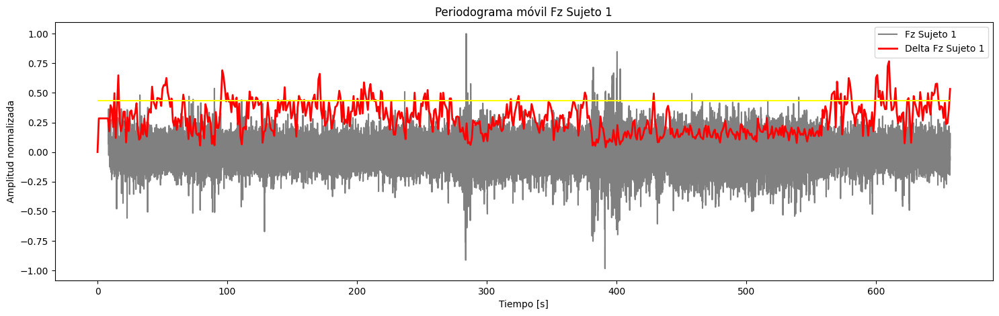

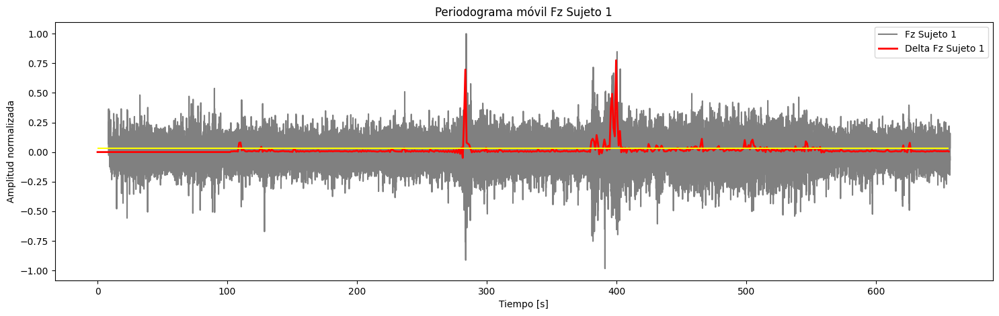

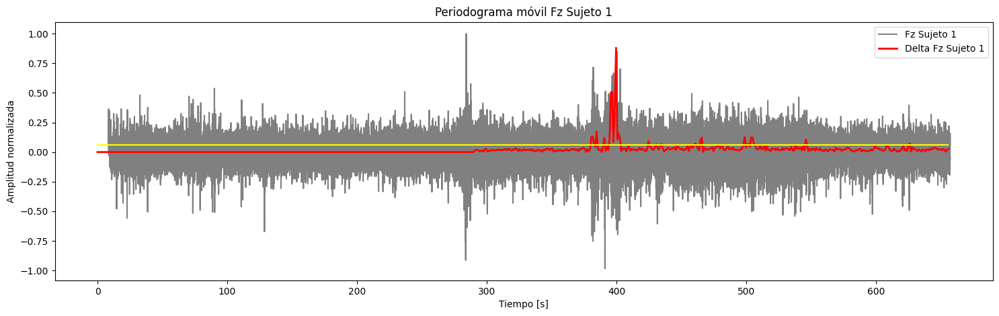

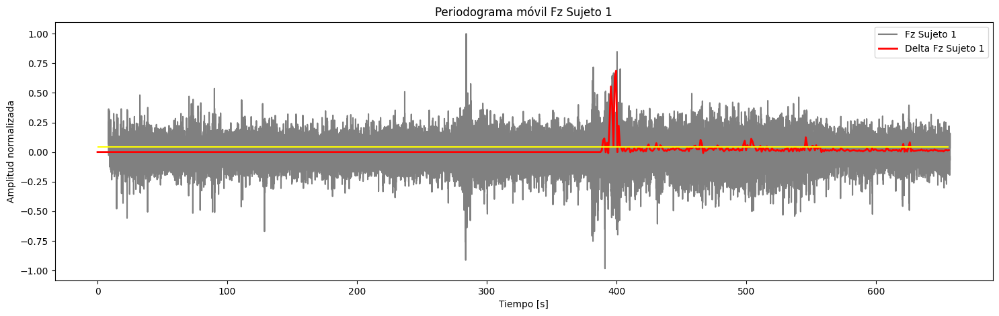

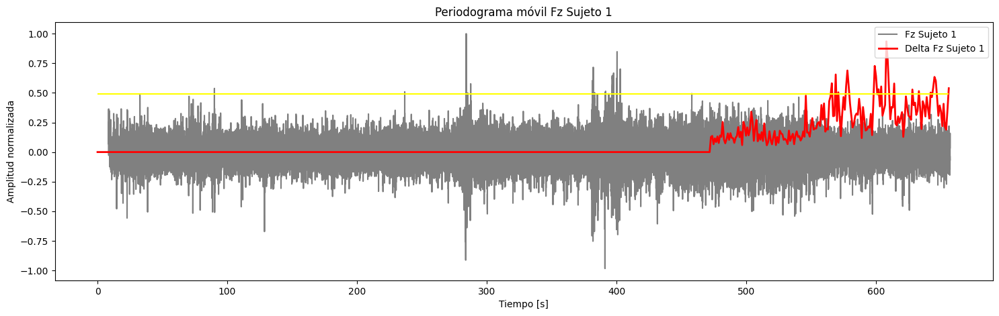

...

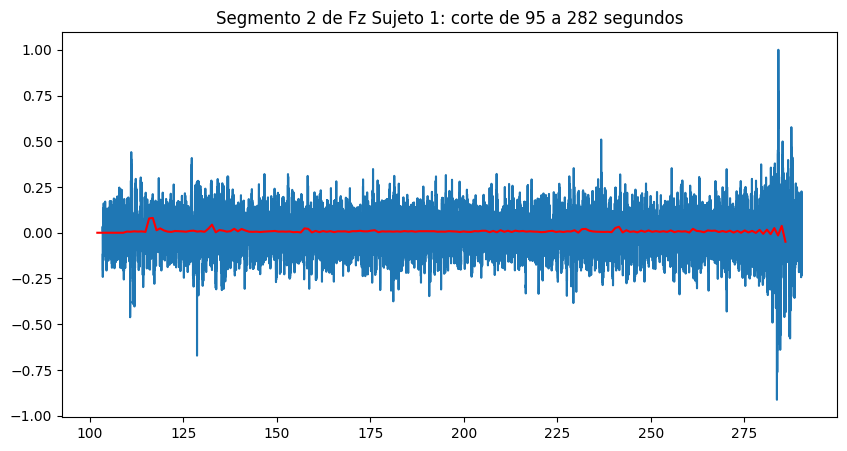

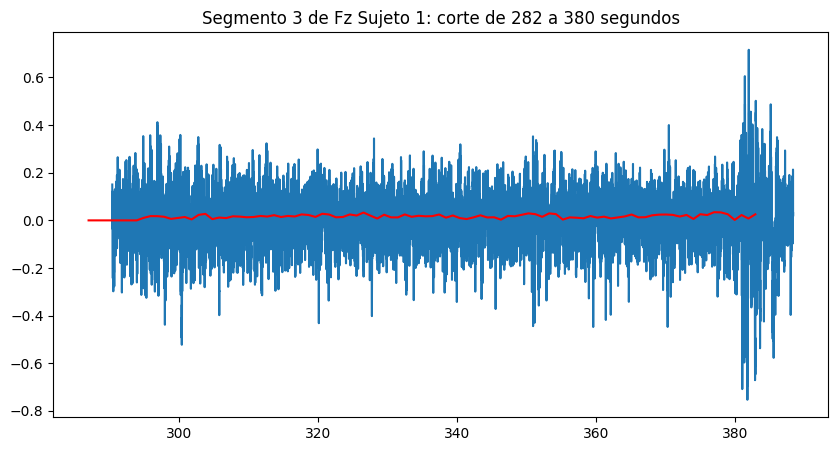

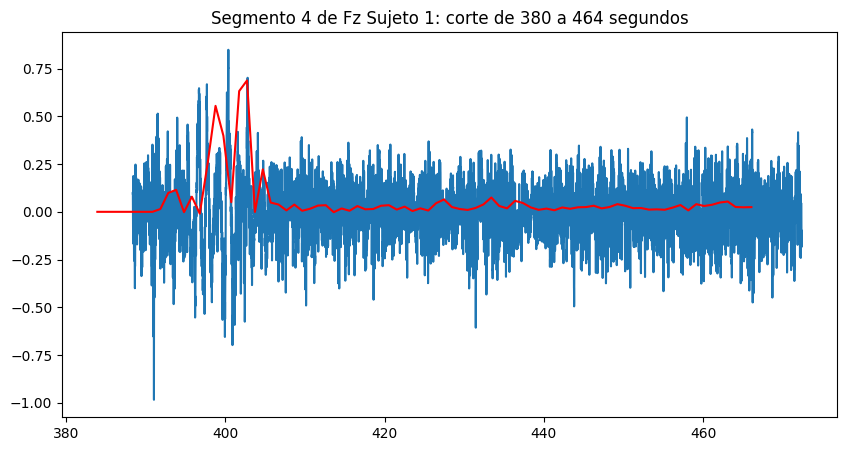

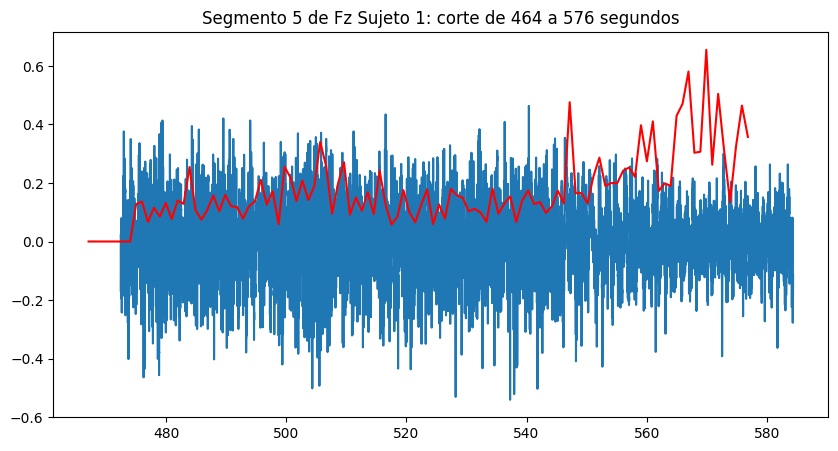

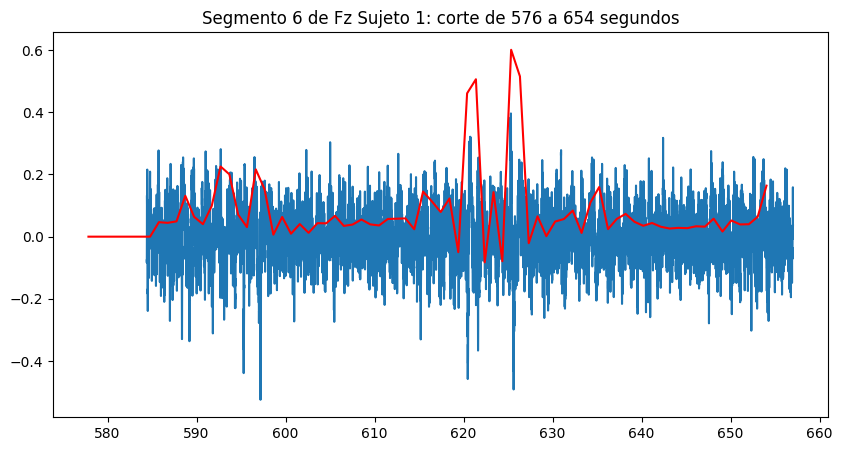

In [ ]:
period_Fz_0, deltas1_Fz_0, ies_Fz_0 = segmentador(senales_FA_0['Fz'], time0, 'Fz Sujeto 1')

######Sujeto 2

Esperamos los cortes alrededor de:
*   120-150 segundos
*   360-410 segundos (abrio los ojos)
*   440-510 segundos
*   510 segundos

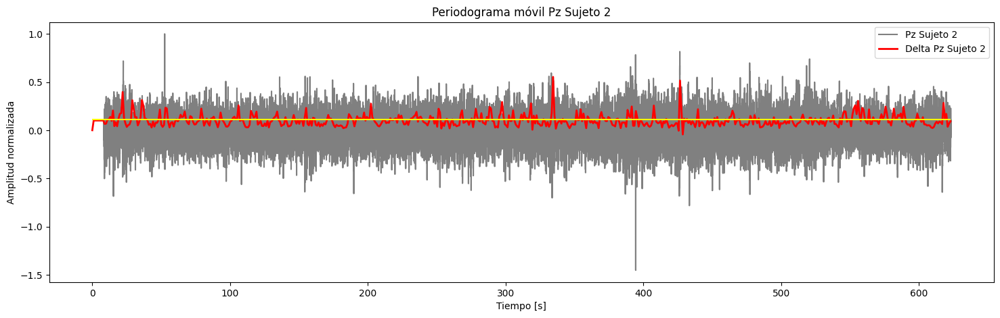

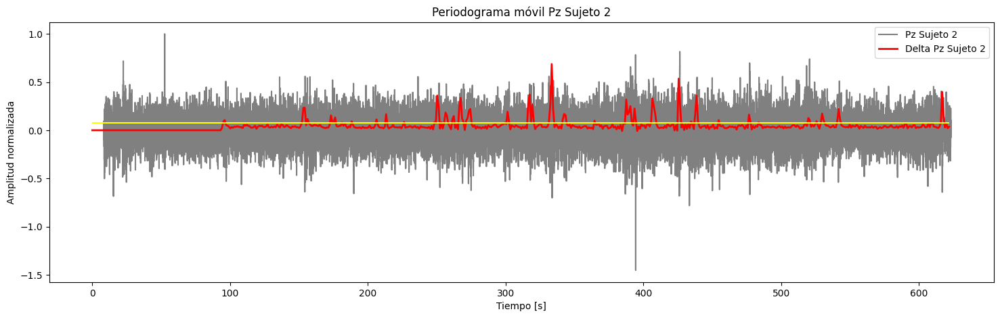

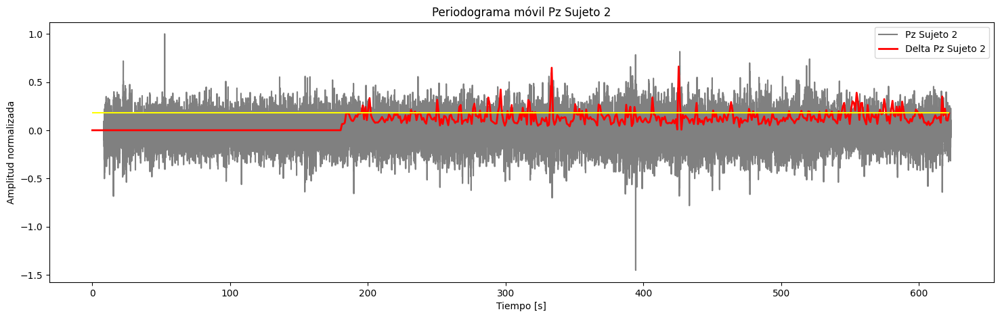

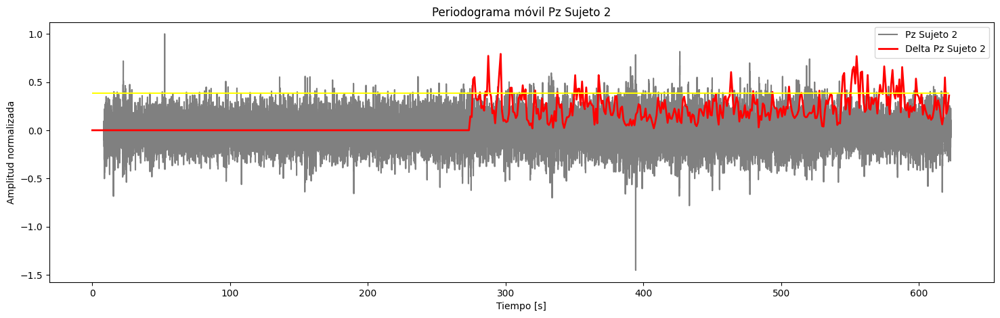

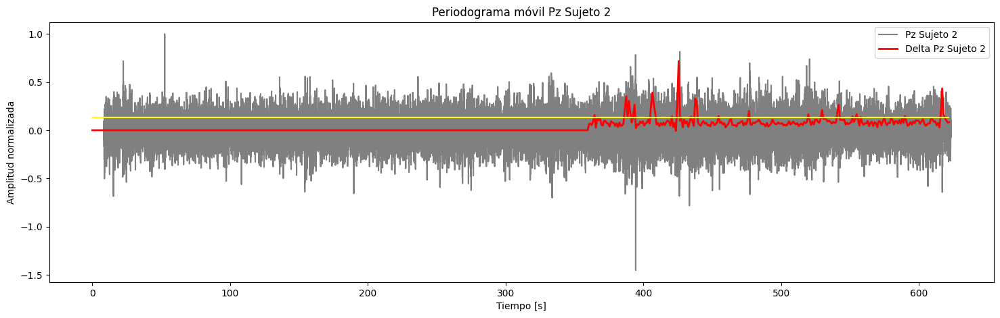

...

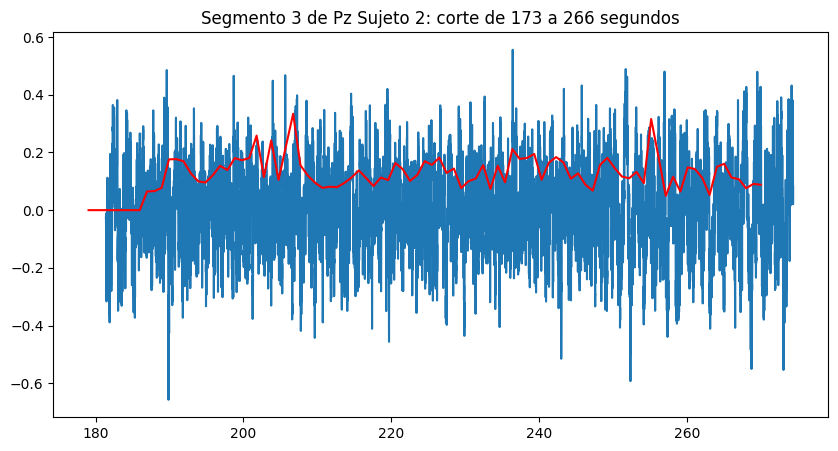

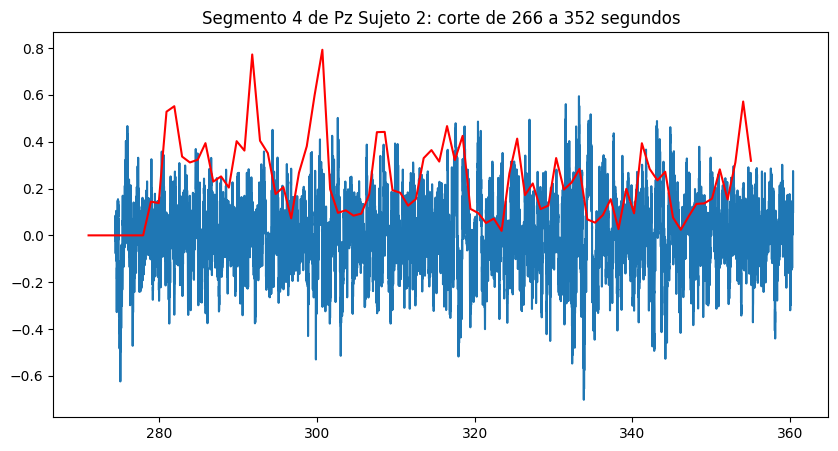

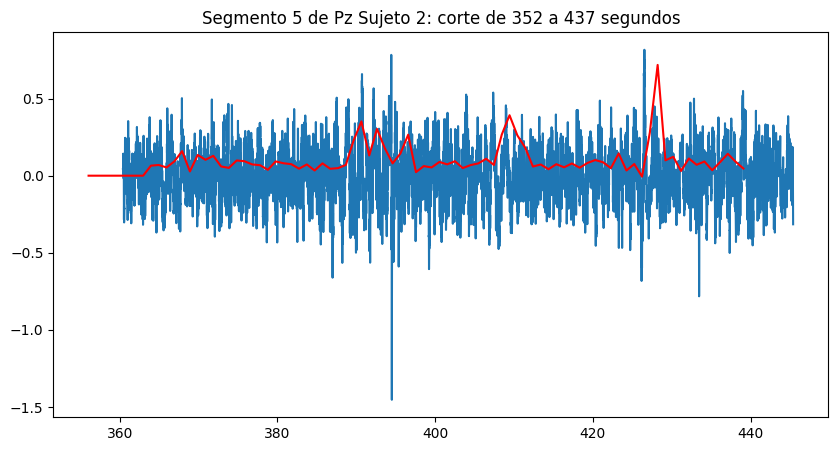

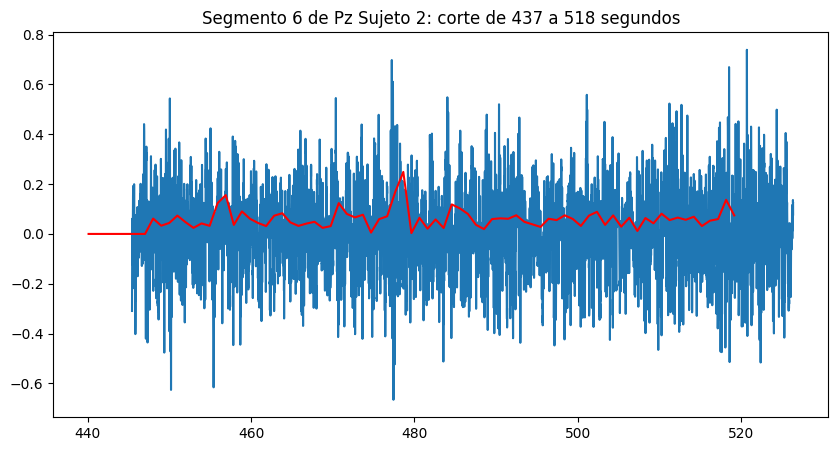

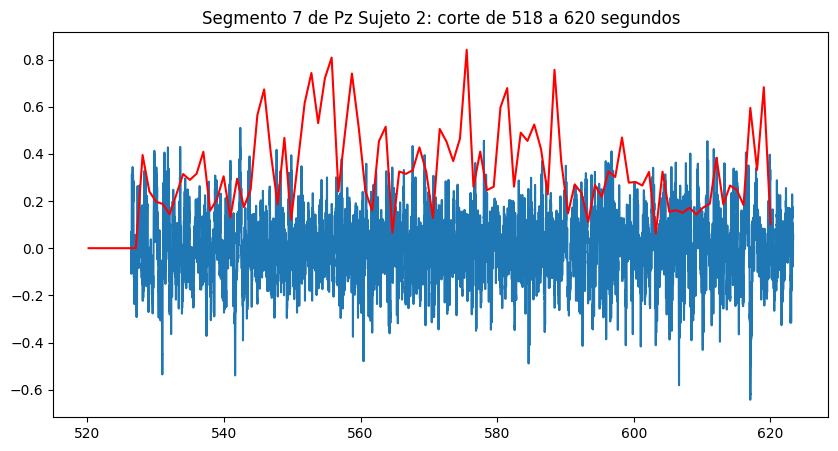

In [ ]:
period_Pz_1, deltas1_Pz_1, ies_Pz_1 = segmentador(senales_FA_1['Pz'], time1, 'Pz Sujeto 2')

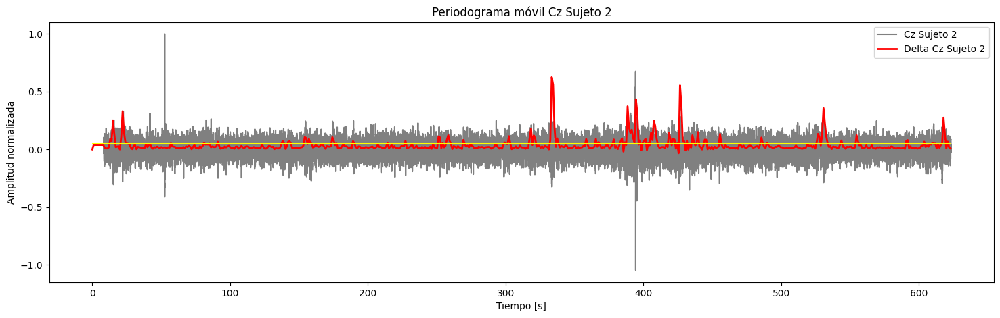

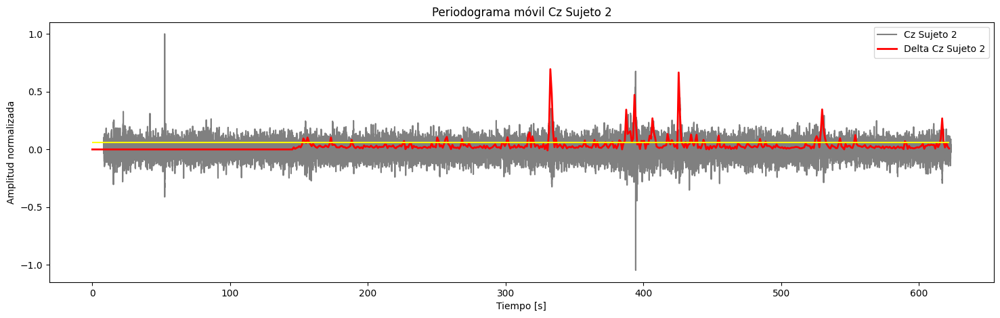

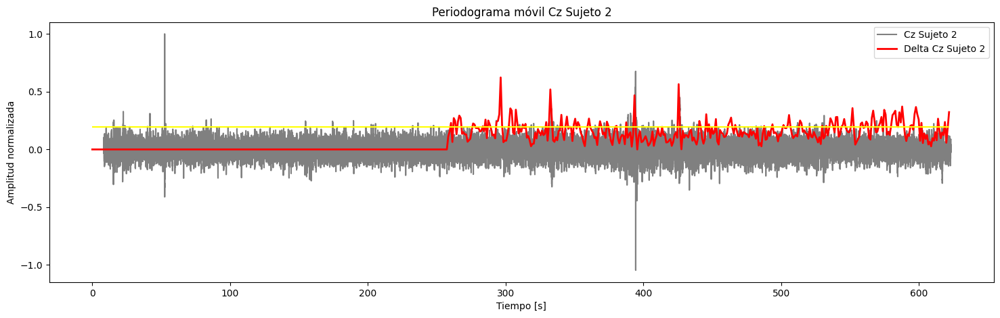

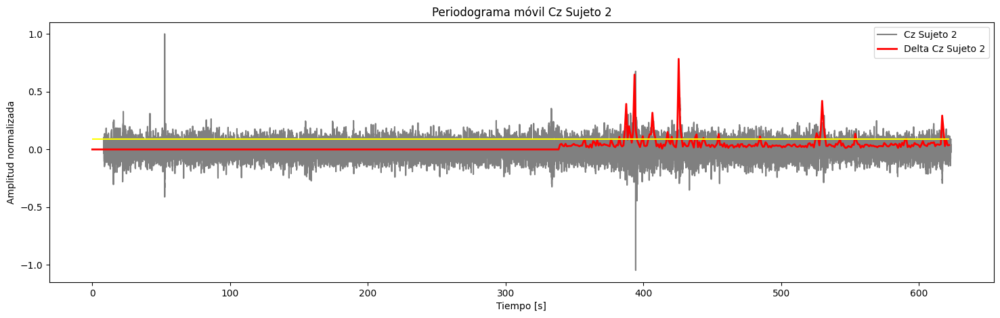

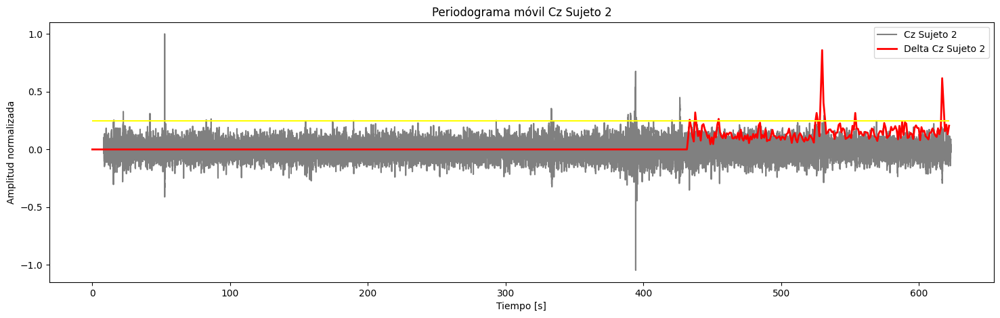

...

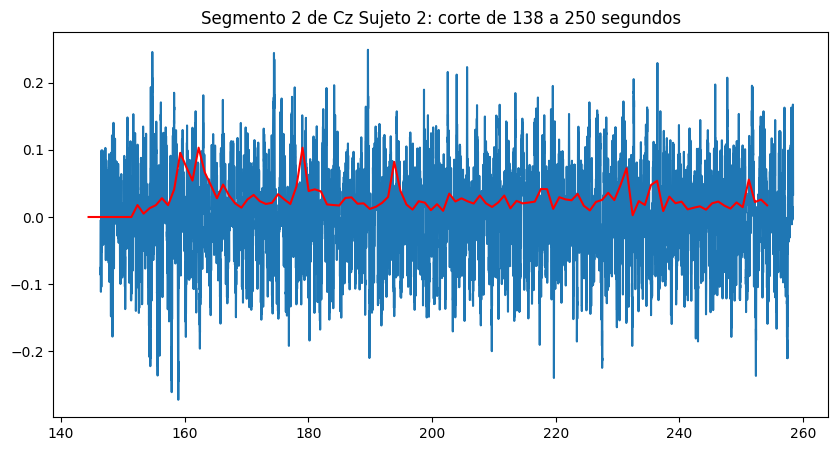

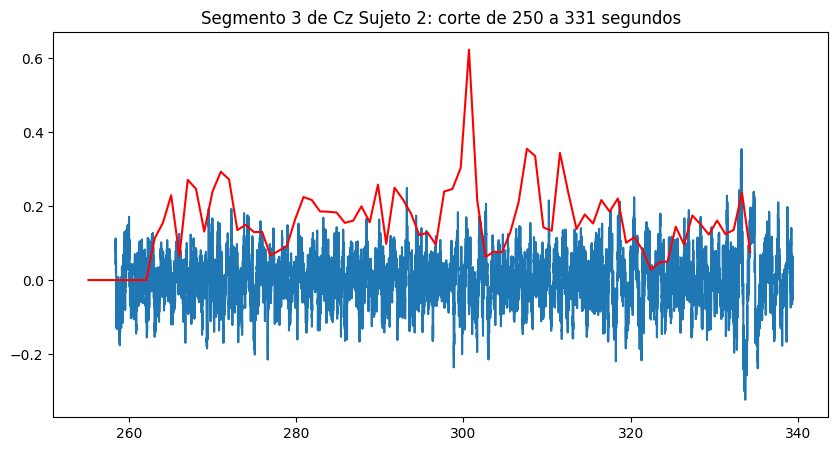

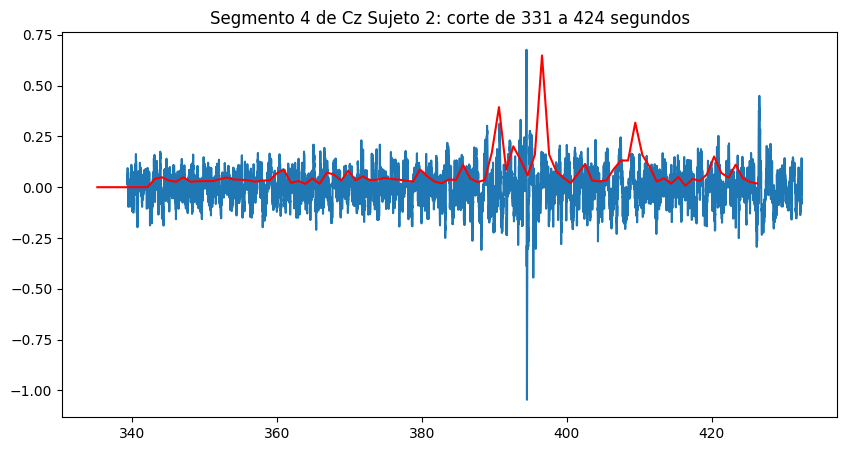

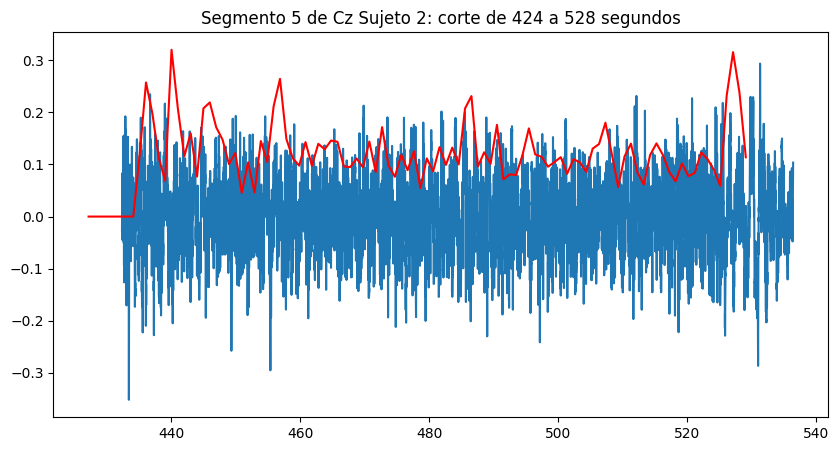

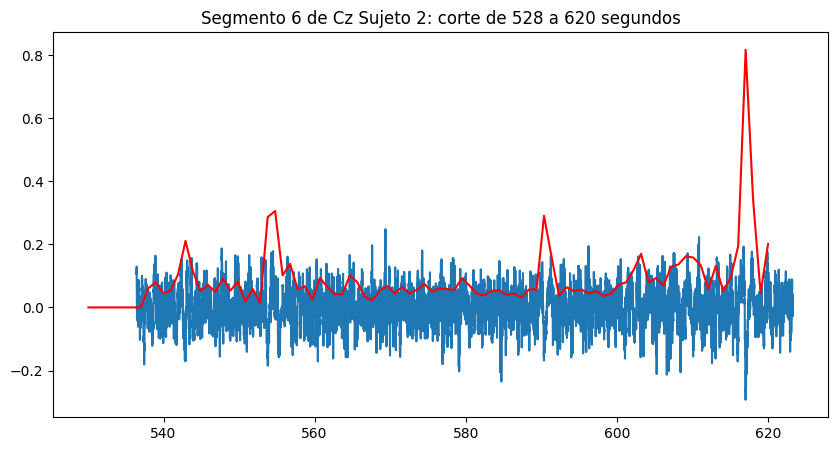

In [ ]:
period_Cz_1, deltas1_Cz_1, ies_Cz_1 = segmentador(senales_FA_1['Cz'], time1, 'Cz Sujeto 2')

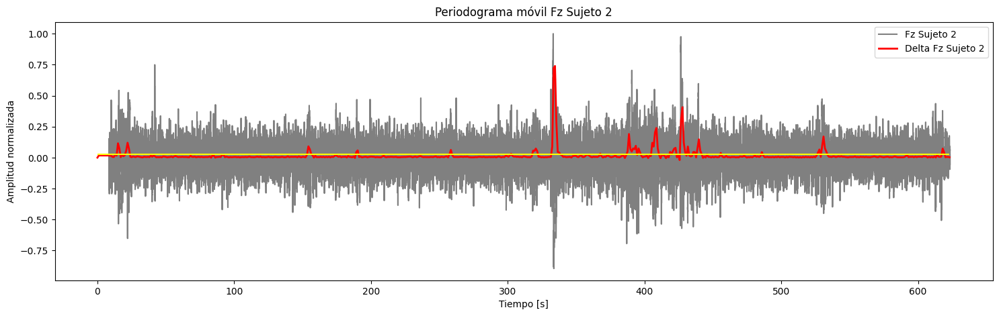

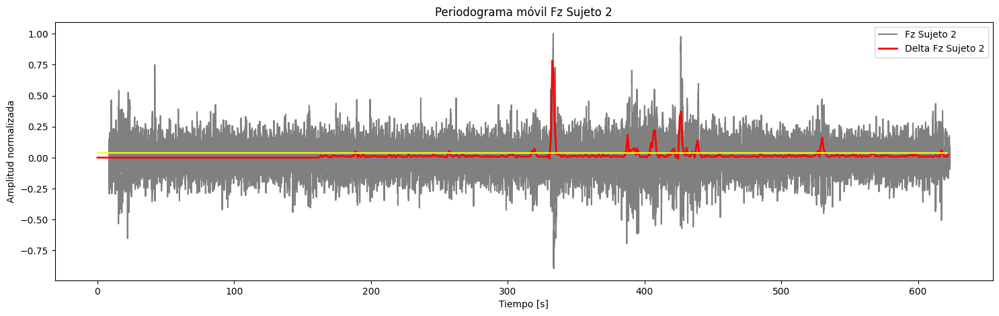

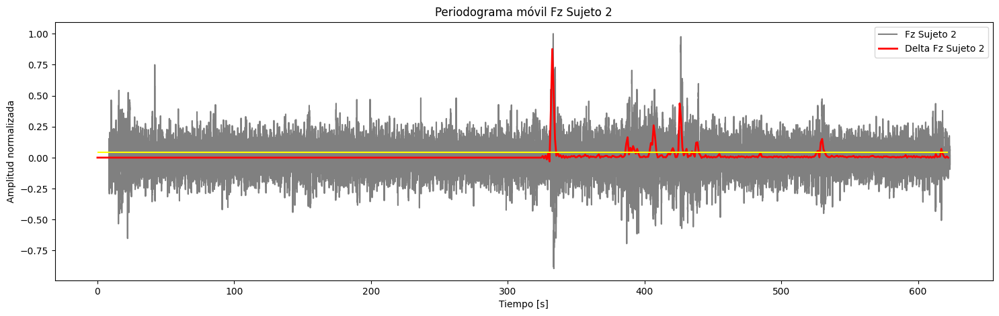

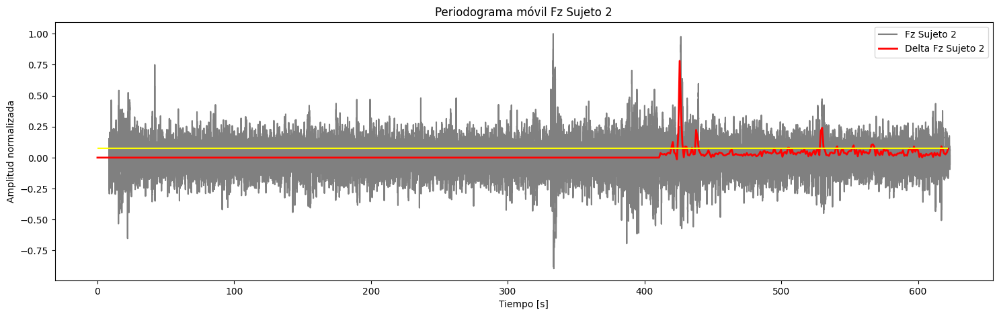

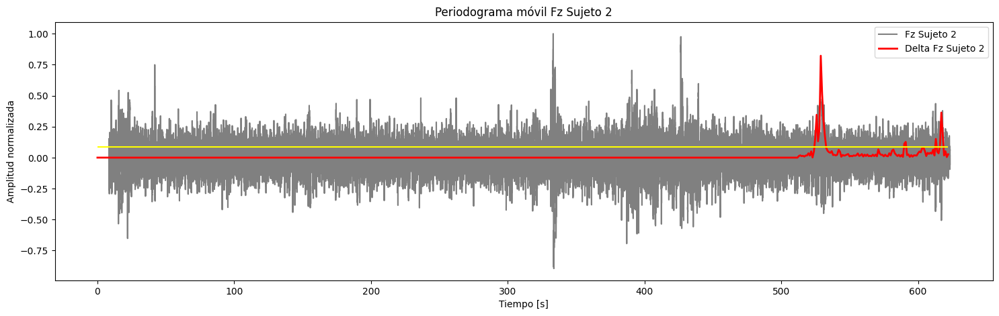

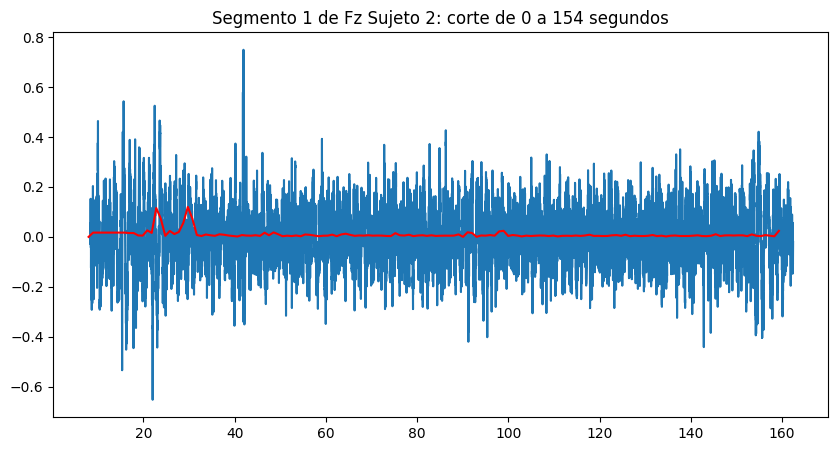

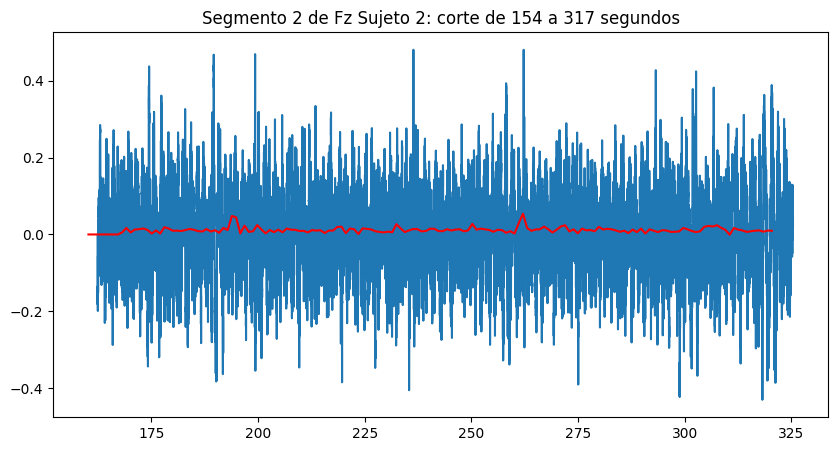

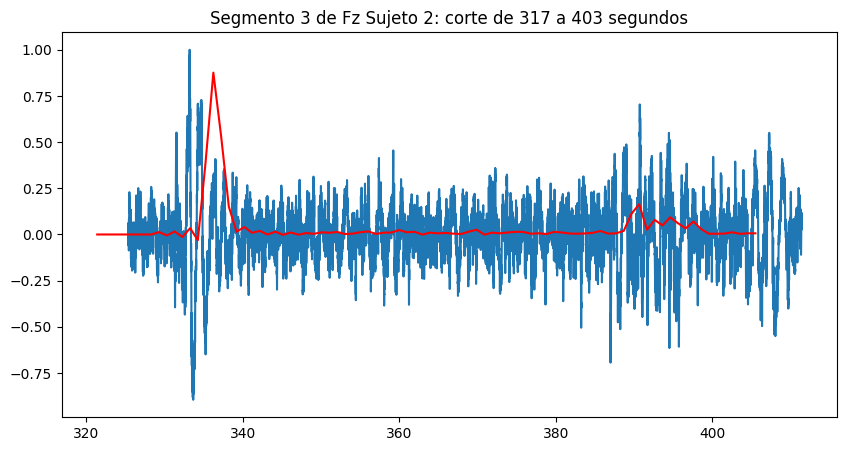

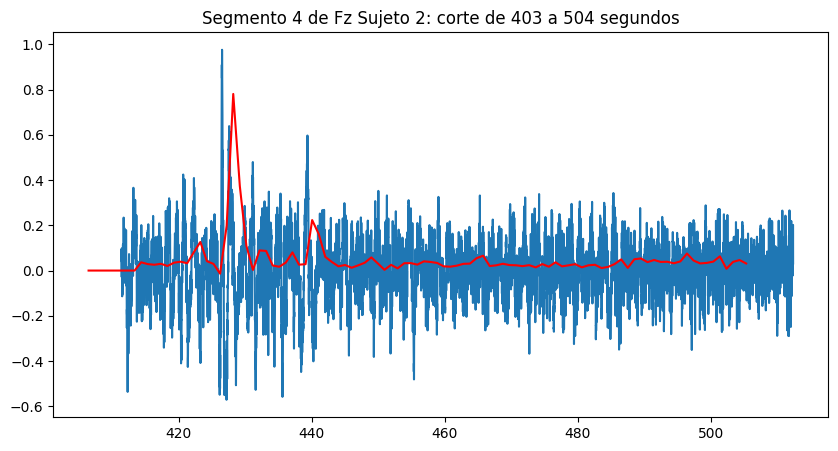

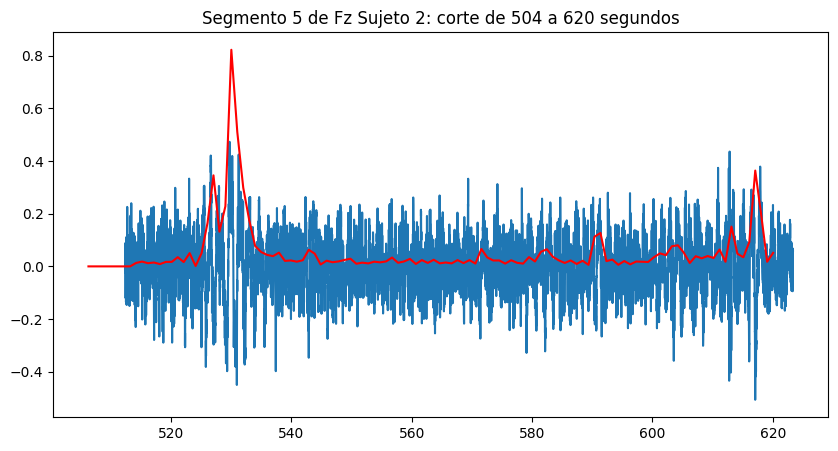

In [ ]:
period_Fz_1, deltas1_Fz_1, ies_Fz_1 = segmentador(senales_FA_1['Fz'], time1, 'Fz Sujeto 2')

######Sujeto 3

Esperamos los cortes alrededor de:
*   120-130 segundos
*   360-380 segundos
*   480-500 segundos

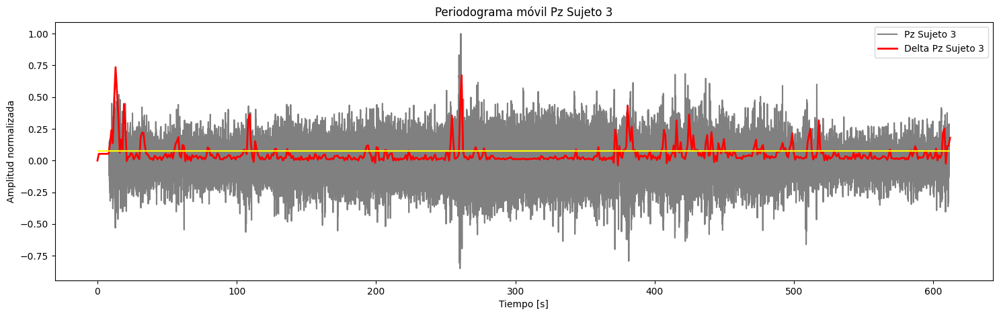

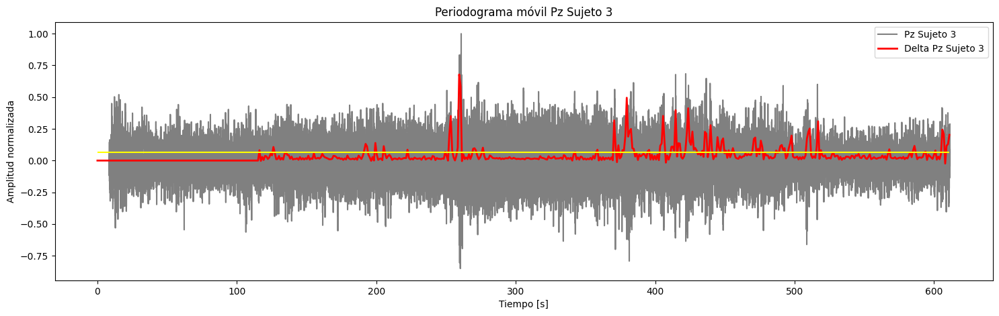

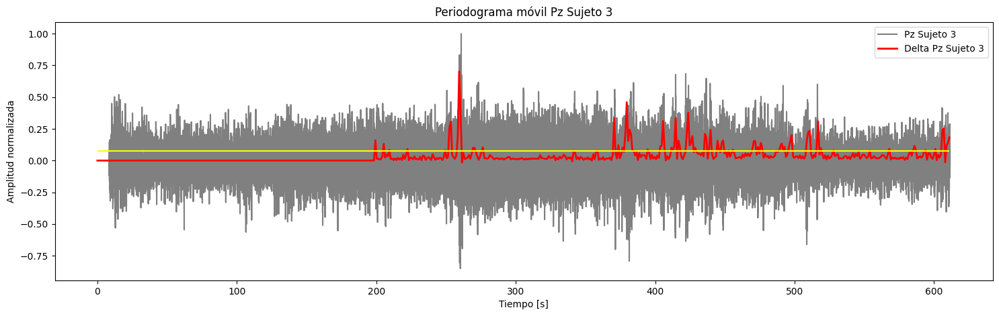

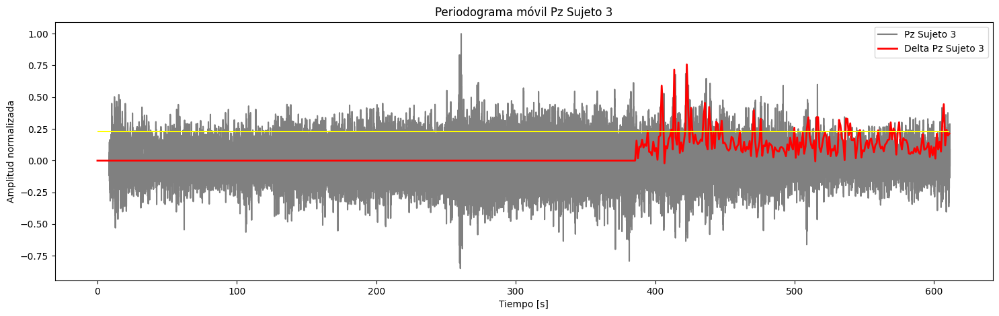

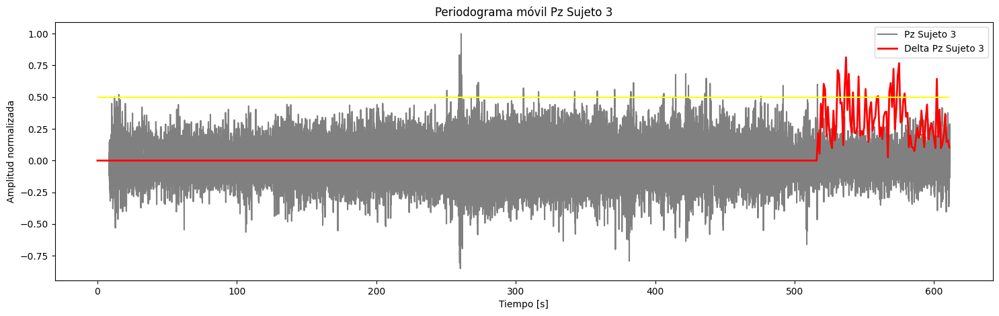

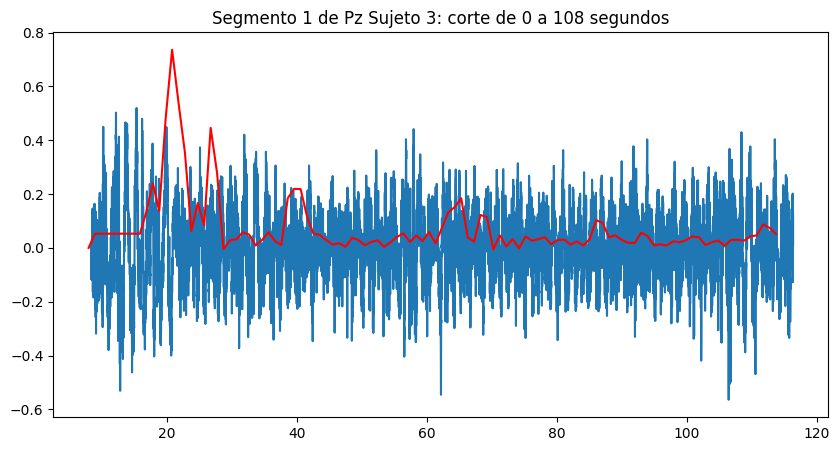

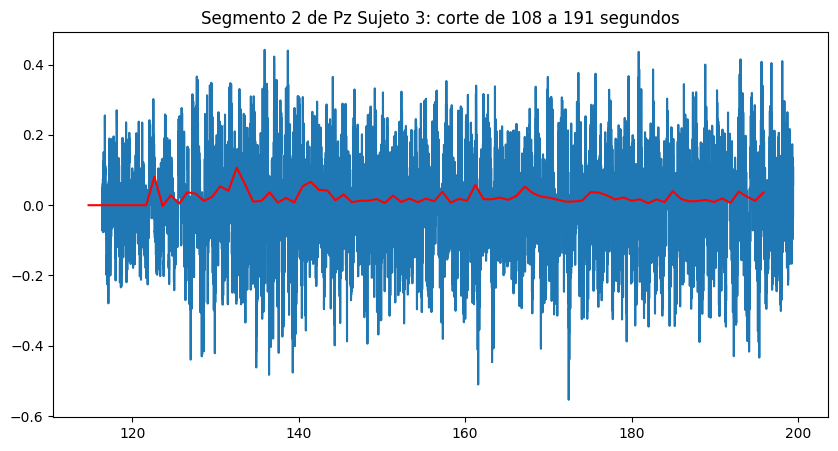

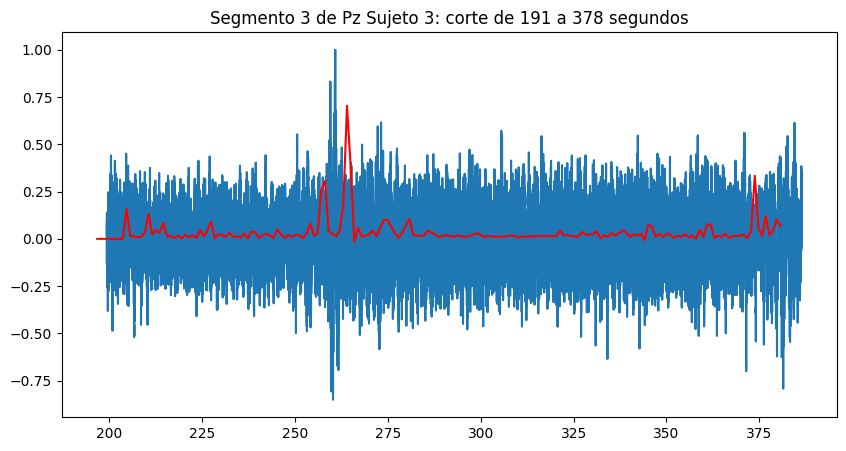

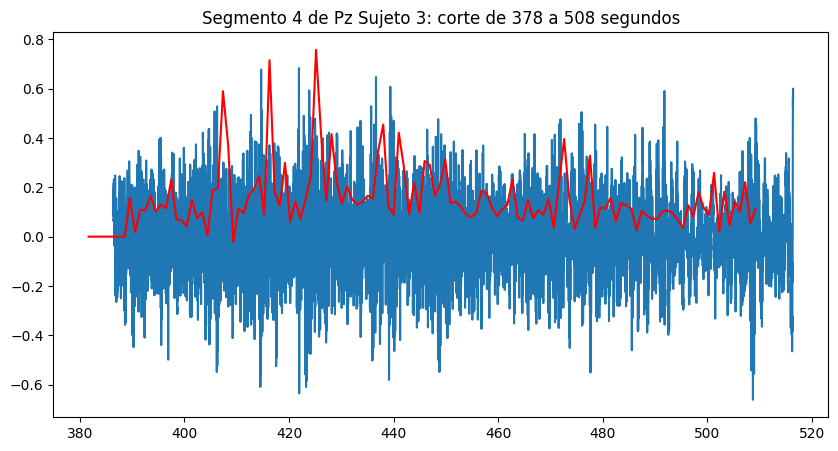

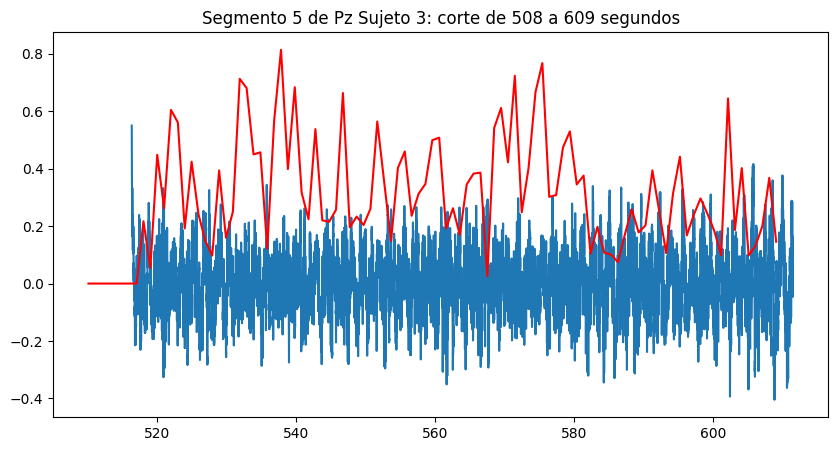

In [ ]:
period_Pz_2, deltas1_Pz_2, ies_Pz_2 = segmentador(senales_FA_2['Pz'], time2, 'Pz Sujeto 3')

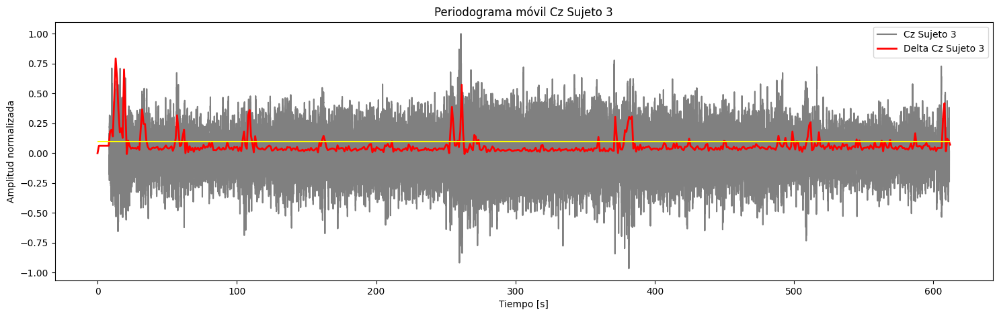

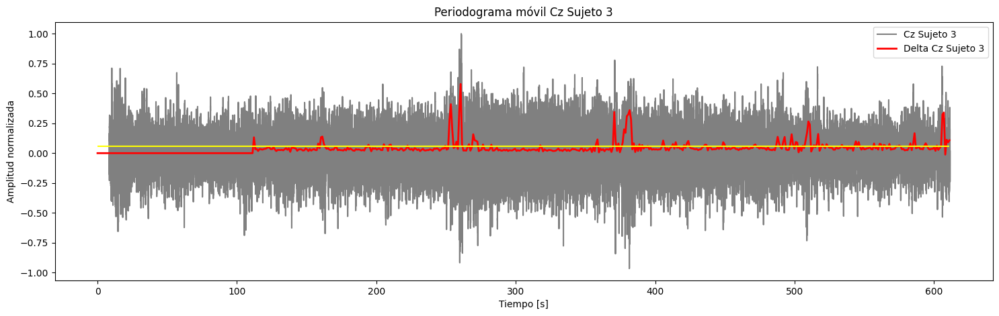

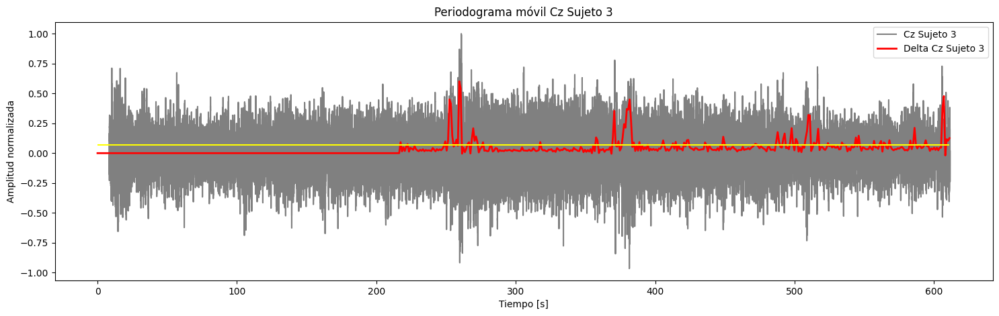

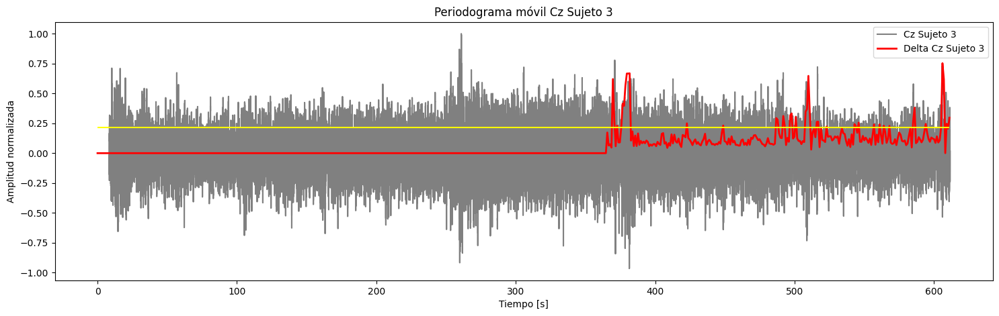

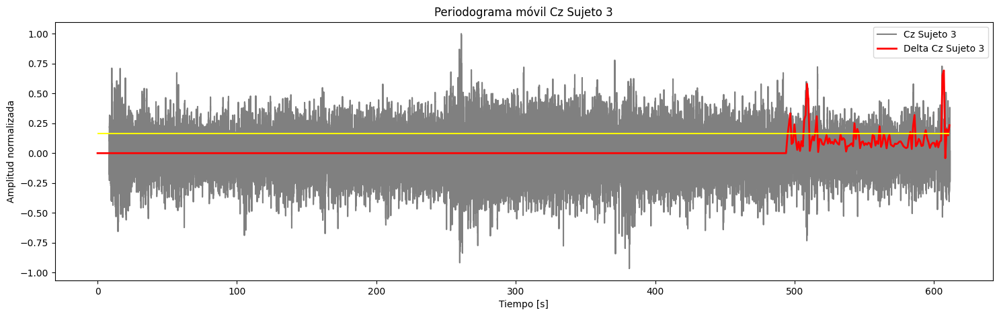

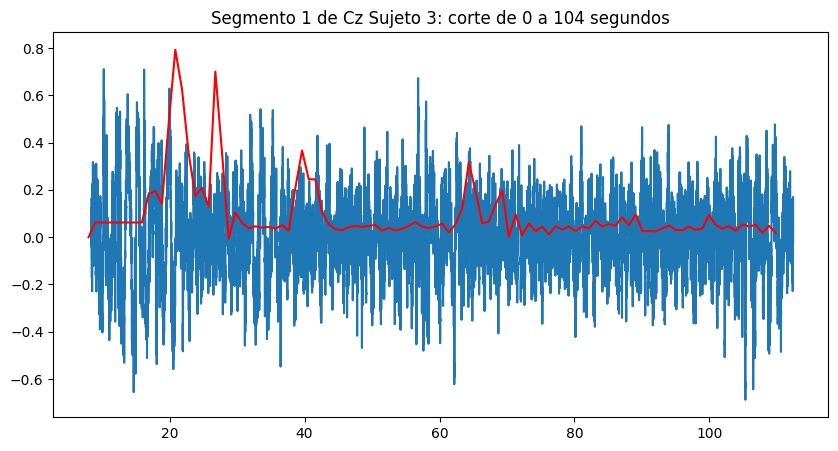

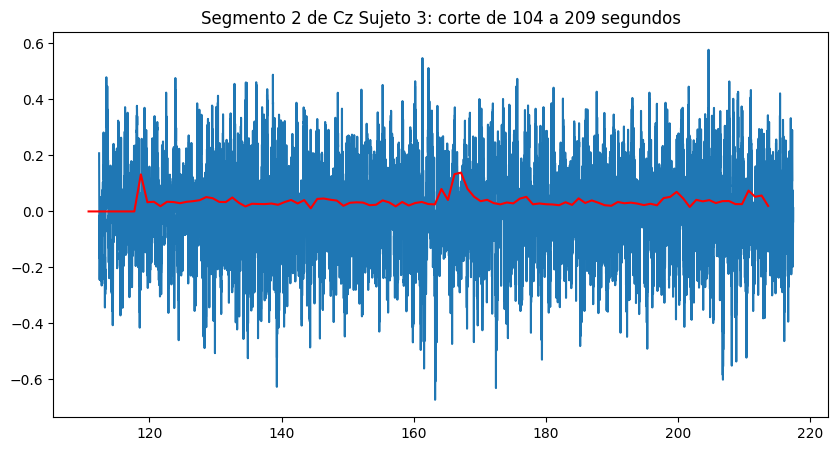

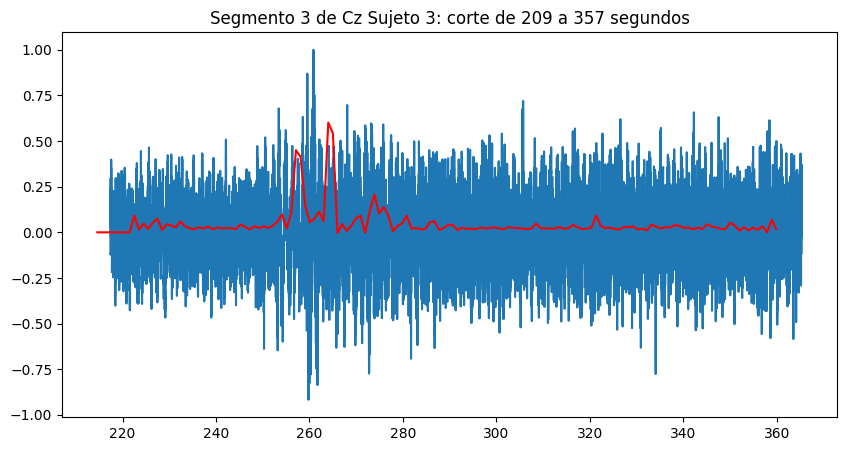

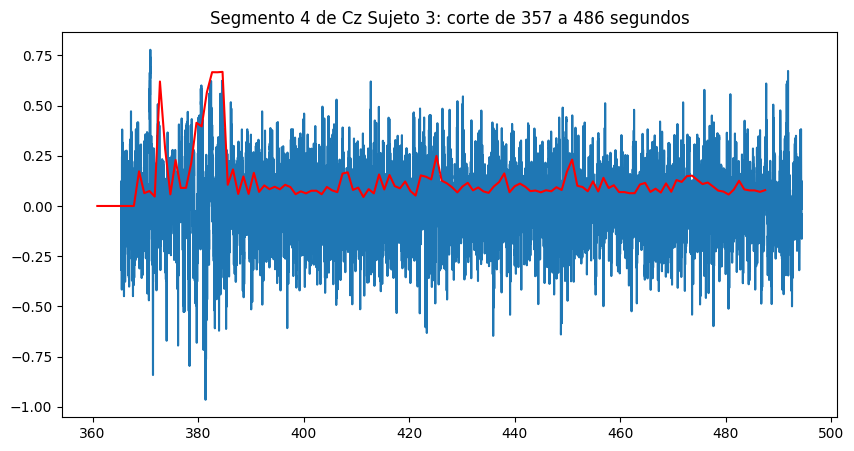

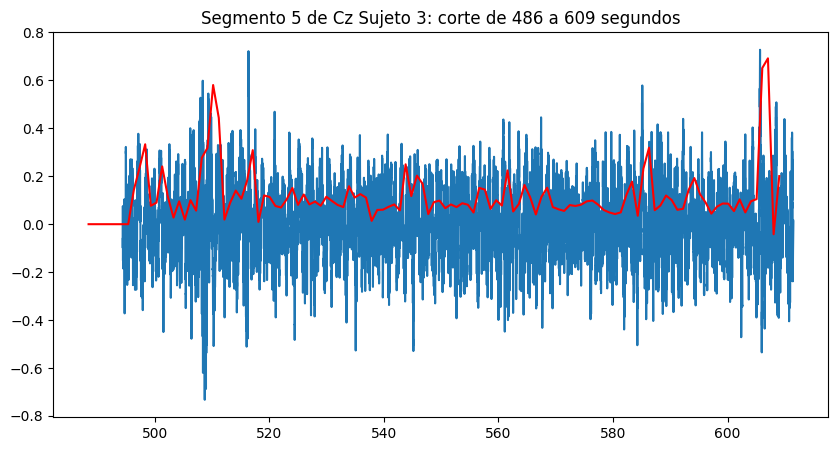

In [ ]:
period_Cz_2, deltas1_Cz_2, ies_Cz_2 = segmentador(senales_FA_2['Cz'], time2, 'Cz Sujeto 3')

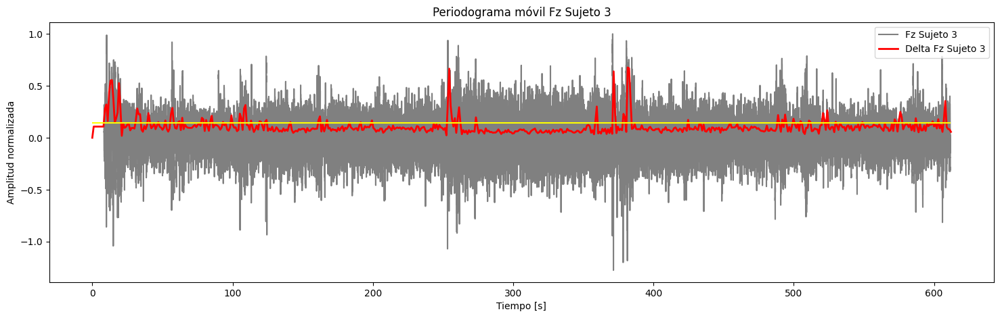

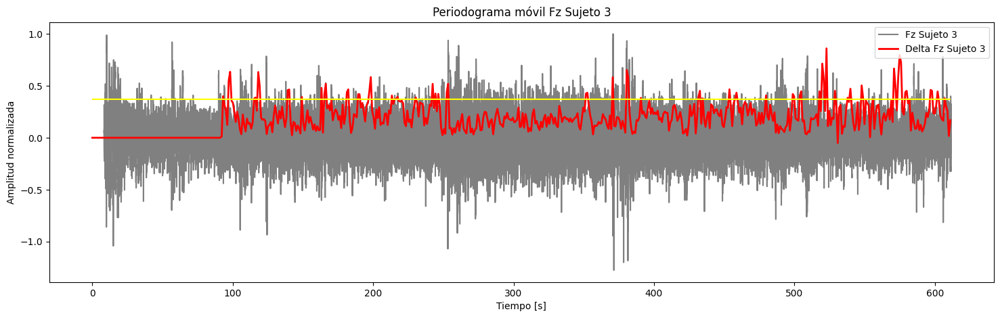

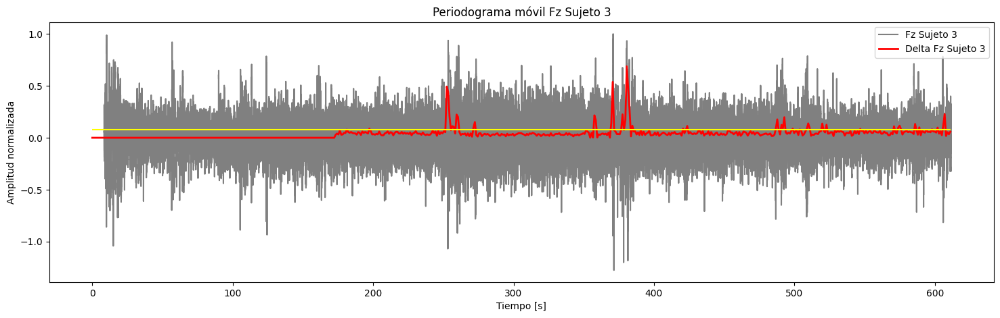

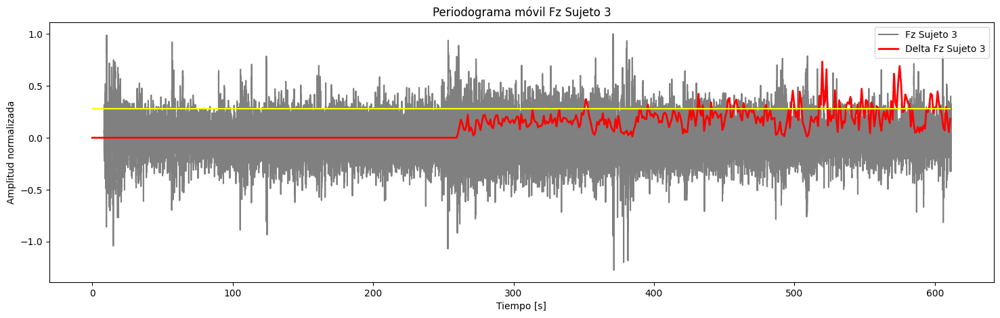

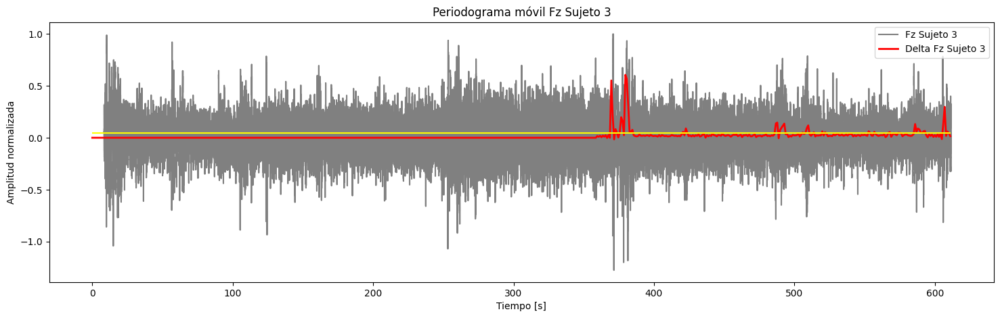

...

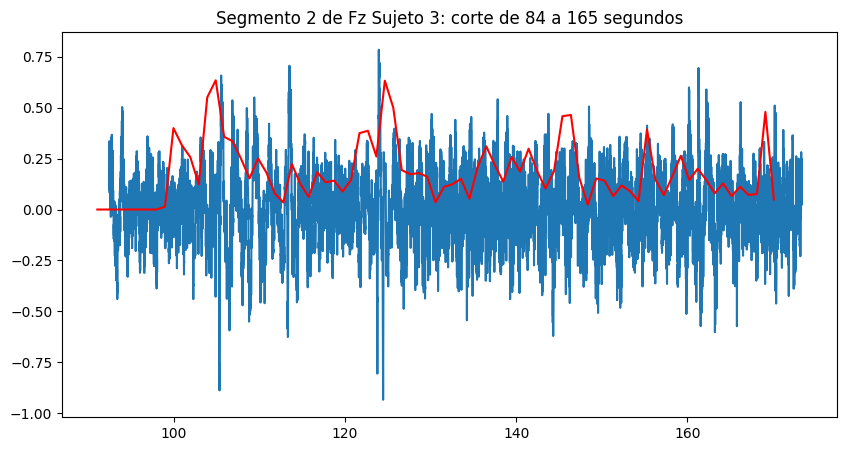

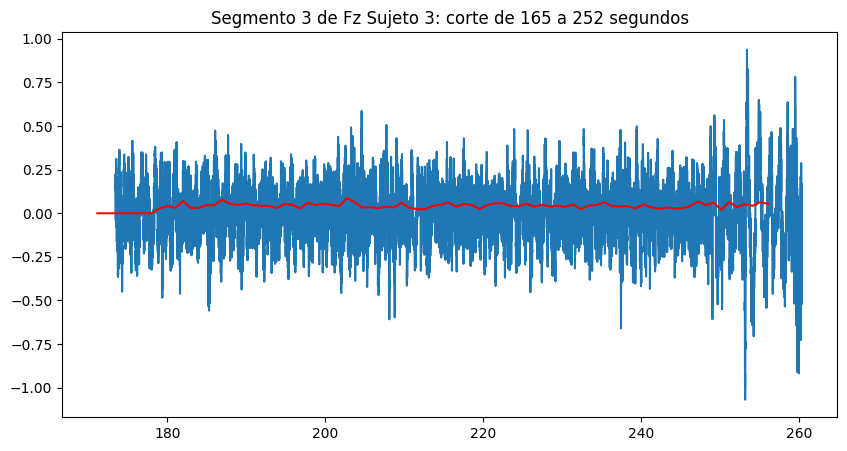

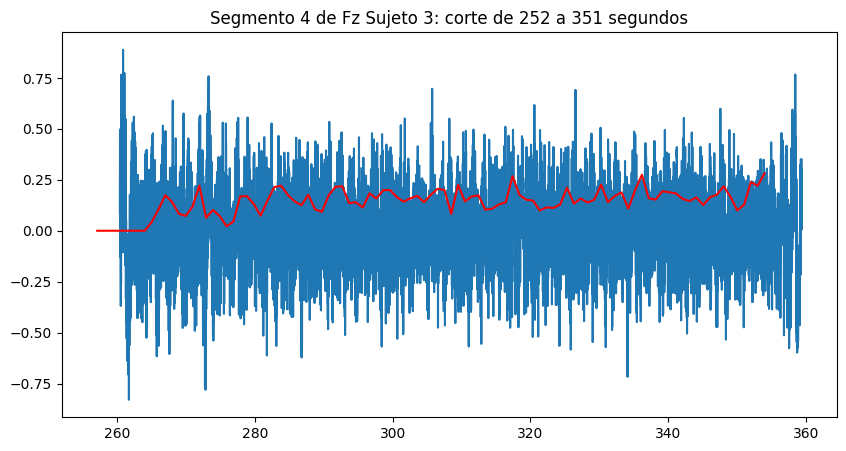

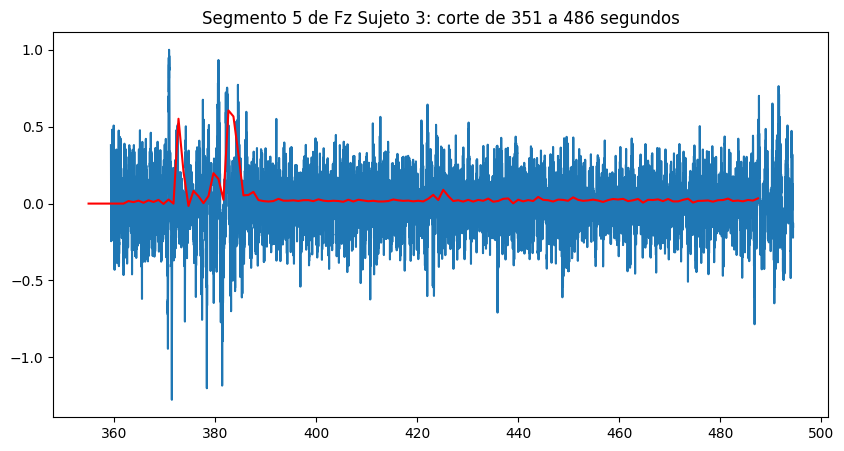

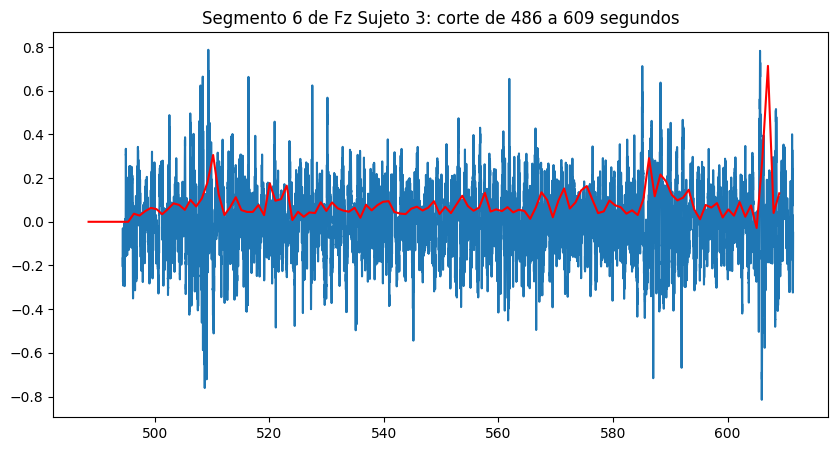

In [ ]:
period_Fz_2, deltas1_Fz_2, ies_Fz_2 = segmentador(senales_FA_2['Fz'], time2, 'Fz Sujeto 3')

##Segundo abordaje (ventana que se agranda)

In [ ]:
def disimilitud_periodogramaVM(senal, time, fs, N_wini, N_winf, titulo):
  N_win = int(fs) #revisar (empiricamente si asi va bien o conviene que sea más grande la ventana de referencia)
  N_senal = senal.shape[0]

  porcentaje = 0.75 # PORCENTAJE DE SOLAPAMIENTO

  paso =  int((1-porcentaje)*N_win) # 75% de solapamiento  --> (N_win/4)
  ref1 = np.random.randint(N_wini,N_winf)
  s_0 = senal[ref1:(ref1+fs)] # agarro la primer ventana --> ventana de referencia
  R_0 = np.correlate(s_0,s_0,mode='full')/s_0.shape[0] #Autocorr de la referencia
  R_00 = R_0[int(R_0.shape[0]/2)] #El valor del medio de R
  delta = [] #vector de datos del error espectral

  for i in range(N_winf, N_senal-N_win, paso):
    s_N = senal[(i):(i+N_win)]
    R_N = np.correlate(s_N,s_N,mode='full')/s_N.shape[0]    #al dividir por la longitud lo normalizo.
    R_N0 = R_N[int(R_N.shape[0]/2)]
    d = np.sum((R_N-R_0)**2)/(R_N0*R_00)
    delta.append(d)


  delta = delta/max(delta)
  senal = senal/max(senal)

  delta_0 = scipy.signal.resample(delta, int(senal[N_wini:].shape[0]/fs)) # resampleo (cambio freq de muestreo)para poder graficar
  if N_wini == 0:
    x = np.arange(8, dtype=np.double)
    a=np.full_like(x, np.mean(delta_0))
    delta_1=np.concatenate((a,delta_0),axis=None)
  else:
    delta_1=delta_0

  y = np.arange(8+int((senal.shape[0]/fs)-len(delta_1)), dtype=np.double)
  agregar0=np.full_like(y, 0)
  delta1_plot=np.concatenate((agregar0,delta_1),axis=None)
  tiempito=np.linspace(0,int(len(delta1_plot)),int(len(delta1_plot)))
  factor = 2*np.mean(delta1_plot[int(N_winf/fs):])
  umbral = factor*max(delta1_plot)

  '''
  plt.figure(figsize=(18,5)) # Se pierden las escalas de amplitud del gráfico para mejorar la comparación
  plt.title(f'Periodograma móvil {titulo}')
  plt.plot(time,senal,'gray',label=f'{titulo}')
  plt.plot(tiempito[:],delta1_plot,'red',linewidth=2,label=f'Delta {titulo}')
  plt.legend(loc='upper right')
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud normalizada')
  plt.hlines(y=umbral, xmin=0, xmax=len(delta1_plot), color='yellow')

  plt.show()
  '''
  return delta, senal, delta1_plot, factor

In [ ]:
def segmentador_movil(senal, time, titulo):
  segm = {}
  delta1s = {}
  ies = []
  c=0
  j=0
  k=1
  aux=np.array([])
  nuevo_inicio=0
  delta, senal, delta1s[f'Segmento{k}'], factor = disimilitud_periodogramaVM(senal, time, fs,N_wini=nuevo_inicio,N_winf=fs,titulo=titulo)
  umbral = factor*max(delta1s[f'Segmento{k}'])

  for i in range(len(delta1s[f'Segmento{k}'])-1):
    if delta1s[f'Segmento{k}'][i] > umbral:
      c+=1
      while c==1:
        if delta1s[f'Segmento{k}'][i+1] > umbral:
          if (len(senal[j*fs:i*fs])>80*fs or (len(aux)+len(senal[j*fs:i*fs]))>80*fs and (len(senal[i*fs:])>60*fs)):
            if(aux.shape!=0):
              senalsita=np.concatenate((aux,senal[j*fs:i*fs]),axis=None)
              aux=np.array([])
            else:
              senalsita=senal[j*fs:i*fs]
            segm[f'Segmento{k}'] = (senalsita)
            ies.append(i)
            k+=1
            delta, senal,  delta1s[f'Segmento{k}'], factor = disimilitud_periodogramaVM(senal, time, fs,N_wini=i*fs,N_winf=(i*fs)+fs,titulo=titulo)
            nuevo_inicio = i*fs
            umbral = factor*max(delta1s[f'Segmento{k}'])
          else:
            aux= np.append(aux,senal[j*fs:i*fs])
          c+=1
          j=i
        else:
          c=0
    else:
      c=0
      delta, senal, delta1s[f'Segmento{k}'], factor = disimilitud_periodogramaVM(senal, time, fs, N_wini=nuevo_inicio,N_winf=((i+1)*fs)+fs,titulo=titulo)


  ies.append(i)
  segm[f'Segmento{k}'] = senal[ies[-2]*fs:i*fs]
  tiempito=np.linspace(0,int(len(delta1s[f'Segmento1'])),int(len(delta1s[f'Segmento1'])))

  j=0
  k=1
  for i in ies:
    plt.figure(figsize=(10,5))
    plt.plot(time[j*fs:i*fs],segm[f'Segmento{k}'])
    plt.plot(tiempito[j:i],delta1s[f'Segmento{k}'][j:i],'red')
    plt.title(f'Segmento {k} de {titulo}: corte de {j} a {i} segundos')
    plt.show()
    j=i
    k+=1

  return segm, delta1s

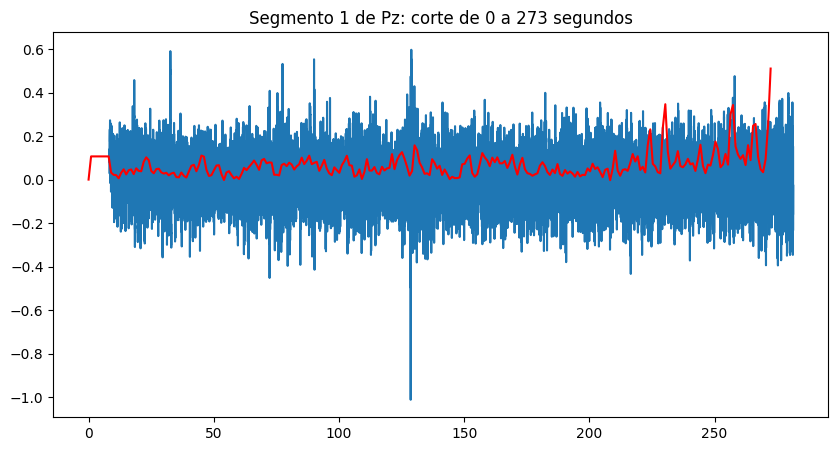

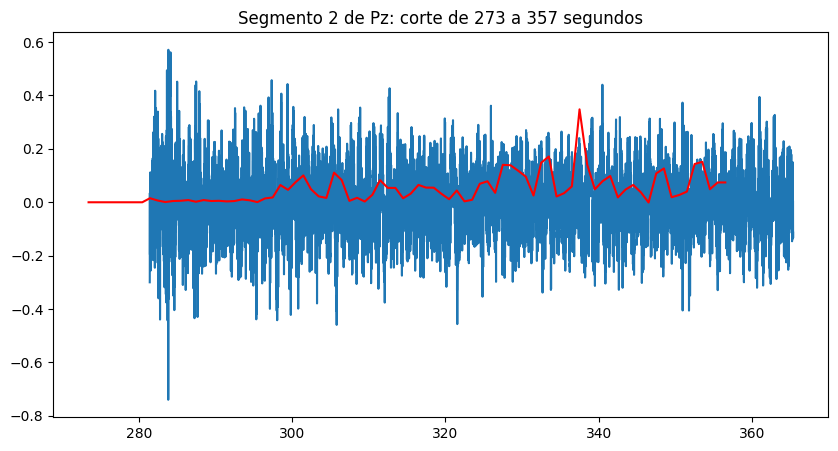

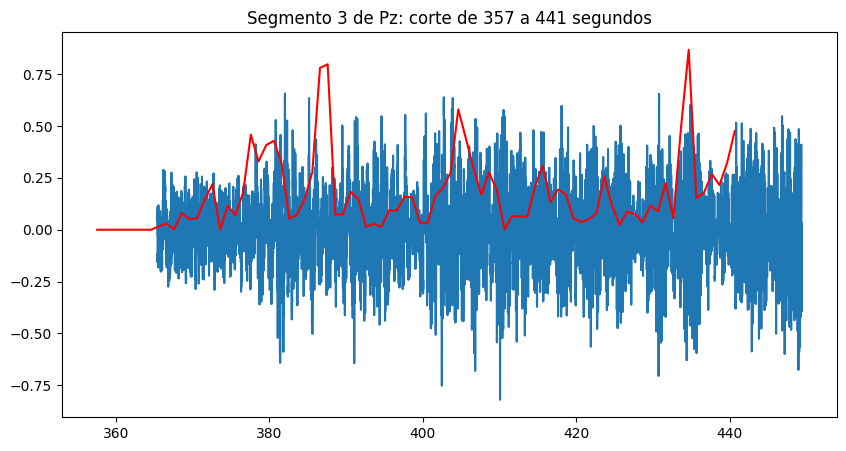

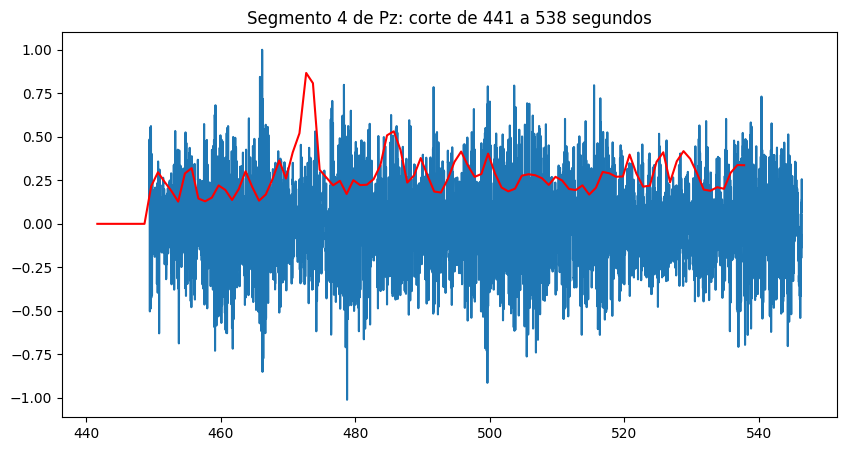

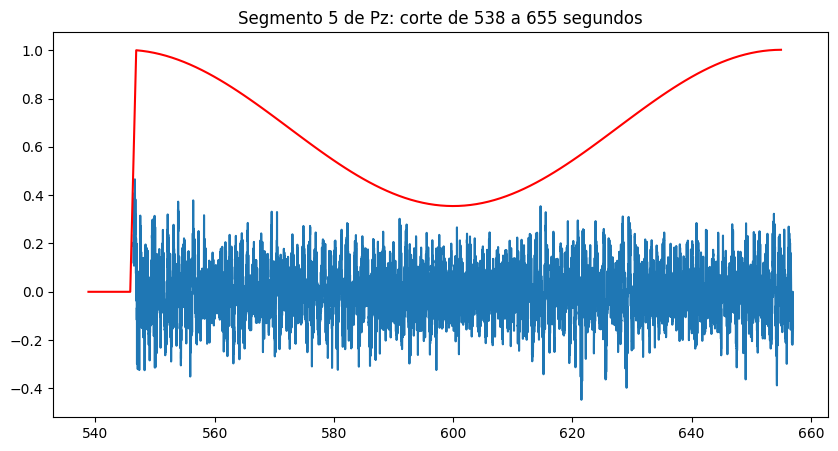

In [ ]:
segm_Pz_movil, deltas1_Pz_movil = segmentador_movil(senales_FA_0['Pz'], time0,'Pz')

Se realizó la segmentación por periodograma con ventana de referencia creciente (Growing), pero no se tiene en cuenta al ahora del procesado; ya que los resultados obtenidos eran aleatorios en función de las ventanas que se tomaban, ya que son ventanas aleatorias de longitud 1 segundo dentro del rango de la ventana agrandada. Esto se hace para poder calcular la correlación y que no haya inconvenientes con la obtención del coeficiente de disimilitud.

Por otro lado, el coeficiente de disimilitud varía mucho caso a caso, ya que se toman ventanas diferentes. Un ejempo puede ser que cuando la ventana agrandada cubre los primeros 115 segundos se esté utilizando de referencia del segundo 2 al 3, mientas que en el caso de 116 segundos use del segundo 108 al 109.


Por una cuestión de velocidad de procesamiento y de utilidad no se imprime cada gráfico de señal de EEG vs coeficiente de disimilitud.

##Segmentación paramétrica

> 1) Calcular coeficientes AR para cada ventana

> 2) Filtrar la señal de la Test Window (Tw) usando esos coeficientes

> 3) Si la salida es ruido blanco, Tw es similar a Reference Window (Rw). Si no, Tw != Rw y hay un cambio de actividad


In [ ]:
def levinson_durbin(x, L):

  R = [x.dot(x)]
  # Calculo la autocorrelación
  for i in range(1, L + 1):
      r = x[i:].dot(x[:-i])
      R.append(r)
  R = np.array(R)

  # Pasos Levinson-Durbin
  C = np.array([1, -R[1]/R[0]])
  P = R[0] + R[1] * C[1]

  for i in range(1,L):
    ki = (-1) * C[:i+1].dot(R[i+1:0:-1])/P
    C = np.hstack([C,0])
    C = C + ki * C[::-1]
    P = P * (1 - ki**2) #P es la varianza del ruido

  return C , P

In [ ]:
L = 2**4
N_window=int(fs)

coef_Pz_0, var_error_Pz_0 = levinson_durbin(senales_FA_0['Pz'][:N_window],L)
coef_Cz_0, var_error_Cz_0 = levinson_durbin(senales_FA_0['Cz'][:N_window],L)
coef_Fz_0, var_error_Fz_0 = levinson_durbin(senales_FA_0['Fz'][:N_window],L)

coef_Pz_1, var_error_Pz_1 = levinson_durbin(senales_FA_1['Pz'][:N_window],L)
coef_Cz_1, var_error_Cz_1 = levinson_durbin(senales_FA_1['Cz'][:N_window],L)
coef_Fz_1, var_error_Fz_1 = levinson_durbin(senales_FA_1['Fz'][:N_window],L)

coef_Pz_2, var_error_Pz_2 = levinson_durbin(senales_FA_2['Pz'][:N_window],L)
coef_Cz_2, var_error_Cz_2 = levinson_durbin(senales_FA_2['Cz'][:N_window],L)
coef_Fz_2, var_error_Fz_2 = levinson_durbin(senales_FA_2['Fz'][:N_window],L)

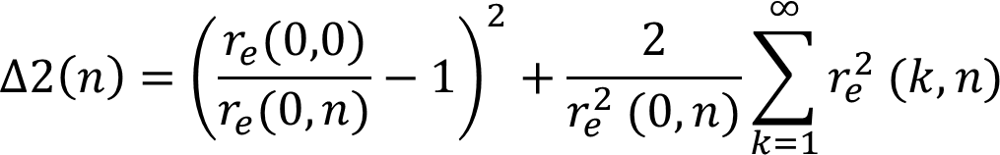

####Sin cambiar la ventana de referencia

In [ ]:
def parametrico(senal, time, titulo, coef, var):
  N_win=int(fs)
  N_senal = senal.shape[0]

  porcentaje = 0.1 # PORCENTAJE DE SOLAPAMIENTO

  paso =  int((1-porcentaje)*N_win) # 10% de solapamiento  --> (N_win/9)

  s_0=signal.lfilter(coef,1,senal[:N_win])
  R_0 = np.correlate(s_0,s_0,mode='full')/s_0.shape[0] #Autocorr de la referencia
  R_00 = R_0[int(R_0.shape[0]/2)] #El valor del medio de R

  delta = [] #vector de datos del error espectral

  for i in range(N_win, N_senal-N_win, paso):
    s_N = signal.lfilter(coef,1,senal[i:i+N_win])
    R_N = np.correlate(s_N,s_N,mode='full')/s_N.shape[0]    #al dividir por la longitud lo normalizo.
    R_N0 = R_N[int(R_N.shape[0]/2)]
    d = ((R_00/R_N0)-1)**2 + (2/R_N0**2)*np.sum((R_N)**2)   #Chequear
    delta.append(d)

  #delta = delta/max(delta)
  #senal = senal/max(senal)

  delta_0 = scipy.signal.resample(delta, int(senal.shape[0]/fs)) # resampleo (cambio freq de muestreo)para poder graficar
  x = np.arange(8, dtype=np.double)
  a=np.full_like(x, np.mean(delta_0))
  delta_1=np.concatenate((a,delta_0),axis=None)

  plt.figure(figsize=(18,5)) # Se pierden las escalas de amplitud del gráfico para mejorar la comparación
  plt.title(f'Parametrica {titulo}')
  plt.plot(time,senal,'gray',label=f'{titulo}')
  plt.plot(delta_1,'red',linewidth=2,label=f'Delta {titulo}')
  plt.legend(loc='upper right')
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud normalizada')
  plt.show()

  return delta, senal, delta_1

####Cambiando la ventana de referencia.

In [ ]:
def disimilitud_parametrico(senal, time, titulo, coef, var, N_wini, N_winf):
  N_win=int(fs)
  N_senal = senal.shape[0]

  porcentaje = 0.4 # PORCENTAJE DE SOLAPAMIENTO

  paso =  int((1-porcentaje)*N_win) # 40% de solapamiento  --> (N_win/6)
  s_0=signal.lfilter(coef,1,senal[N_wini:N_winf])
  R_0 = np.correlate(s_0,s_0,mode='full')/s_0.shape[0] #Autocorr de la referencia
  R_00 = R_0[int(R_0.shape[0]/2)] #El valor del medio de R

  delta = [] #vector de datos del error espectral

  for i in range(N_winf, N_senal-N_win, paso):
    s_N = signal.lfilter(coef,1,senal[i:i+N_win])
    R_N = np.correlate(s_N,s_N,mode='full')/s_N.shape[0]    #al dividir por la longitud lo normalizo.
    R_N0 = R_N[int(R_N.shape[0]/2)]
    d = ((R_00/R_N0)-1)**2 + (2/R_N0**2)*np.sum((R_N)**2)   #Chequear
    delta.append(d)

  delta = delta/max(delta)
  senal = senal/max(senal)

  delta_0 = scipy.signal.resample(delta, int(senal[N_winf:i].shape[0]/fs)) # resampleo (cambio freq de muestreo)para poder graficar
  if N_wini == 0:
    x = np.arange(8, dtype=np.double)
    a=np.full_like(x, np.mean(delta_0))
    delta_1=np.concatenate((a,delta_0),axis=None)
  else:
    delta_1=delta_0

  y = np.arange(9+int((senal.shape[0]/fs)-len(delta_1)), dtype=np.double)
  agregar0=np.full_like(y, 0)
  delta1_plot=np.concatenate((agregar0,delta_1),axis=None)

  tiempito=np.linspace(0,int(len(delta1_plot)),int(len(delta1_plot)))
  factor = 2.5*np.mean(delta1_plot[int(N_winf/fs):-1])

  plt.figure(figsize=(18,5)) # Se pierden las escalas de amplitud del gráfico para mejorar la comparación
  plt.title(f'Parametrica {titulo}')
  plt.plot(time,senal,'gray',label=f'{titulo}')
  plt.plot(delta1_plot,'red',linewidth=2,label=f'Delta {titulo}')
  plt.legend(loc='upper right')
  plt.xlabel('Tiempo [s]')
  plt.ylabel('Amplitud normalizada')
  plt.hlines(y=factor*max(delta1_plot), xmin=0, xmax=len(delta1_plot), color='yellow')
  plt.show()

  return delta, senal, delta1_plot, factor

In [ ]:
def segmentador_AR(senal, time, titulo, coef, var):
  segm = {}
  delta1s = {}
  ies = []
  c=0
  j=0
  k=1
  aux=np.array([])
  delta, senal, delta1s[f'Segmento{k}'], factor=disimilitud_parametrico(senal, time, titulo, coef, var, N_wini=0,N_winf=fs)
  umbral = factor*max(delta1s[f'Segmento{k}'])

  for i in range(len(delta1s[f'Segmento{k}'])-2):
    if delta1s[f'Segmento{k}'][i] > umbral:
      c+=1
      while c==1:
        if delta1s[f'Segmento{k}'][i+1] > umbral:
          if ((len(senal[j*fs:i*fs])>80*fs or (len(aux)+len(senal[j*fs:i*fs]))>80*fs) and (len(delta1s[f'Segmento{k}'][i:])>60)):
            if(aux.shape!=0):
              senalsita=np.concatenate((aux,senal[j*fs:i*fs]),axis=None)
              aux=np.array([])
            else:
              senalsita=senal[j*fs:i*fs]
            segm[f'Segmento{k}'] = (senalsita)
            ies.append(i)
            k+=1
            delta, senal,  delta1s[f'Segmento{k}'], factor= disimilitud_parametrico(senal, time, titulo, coef, var, N_wini=i*fs,N_winf=(i*fs)+fs)
            umbral = factor*max(delta1s[f'Segmento{k}'])
          else:
            aux= np.append(aux,senal[j*fs:i*fs])
          c+=1
          j=i
        else:
          c=0
    else:
      c=0

  ies.append(i)
  segm[f'Segmento{k}'] = senal[ies[-2]*fs:i*fs]
  tiempito=np.linspace(0,int(len(delta1s[f'Segmento1'])),int(len(delta1s[f'Segmento1'])))

  j=0
  k=1
  for i in ies:
    plt.figure(figsize=(10,5))
    plt.plot(time[j*fs:i*fs],segm[f'Segmento{k}'])
    plt.plot(tiempito[j:i],delta1s[f'Segmento{k}'][j:i],'red')
    plt.title(f'Segmento {k} de {titulo}: corte de {j} a {i} segundos')
    plt.show()
    j=i
    k+=1

  return segm, delta1s, ies

#####Sujeto 1

Esperamos los cortes alrededor de:
*   120-150 segundos
*   385-435 segundos
*   540 segundos

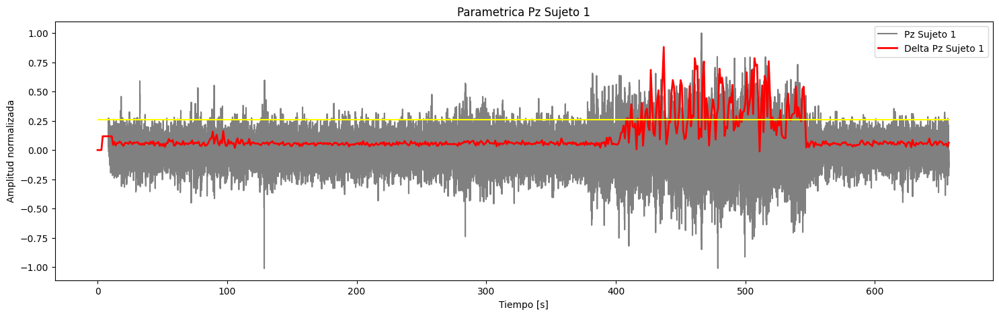

423.0 	 423.0 	 235
ya segmente, ahora a poner un nuevo delta en:  423 424


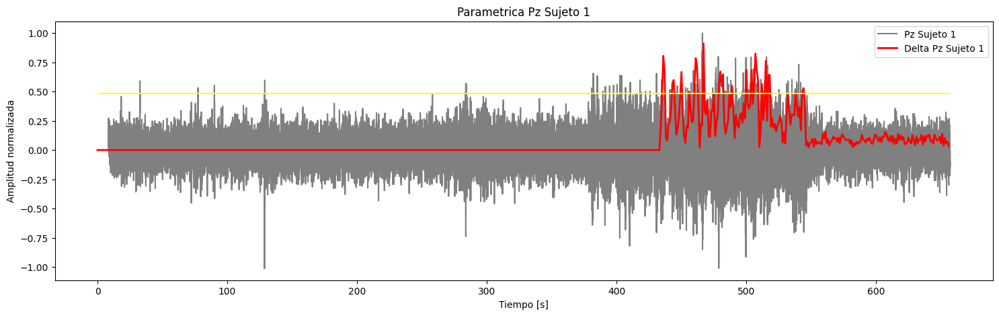

13.0 	 13.0 	 221
7.0 	 3257.0 	 214
17.0 	 5017.0 	 197
19.0 	 9269.0 	 178
27.0 	 14027.0 	 151
ya segmente, ahora a poner un nuevo delta en:  506 507


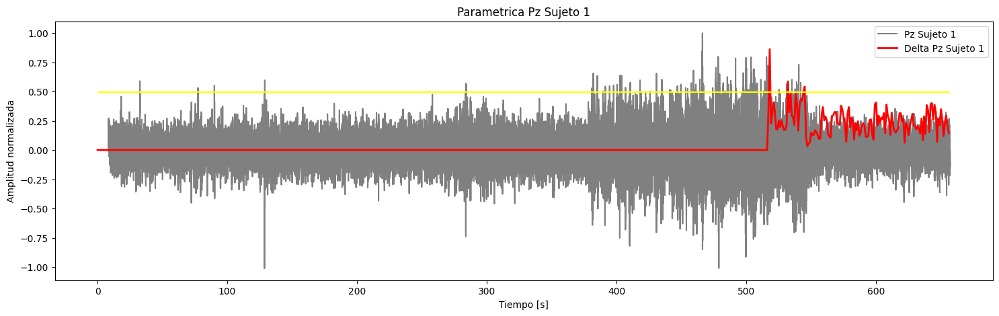

38.0 	 38.0 	 113


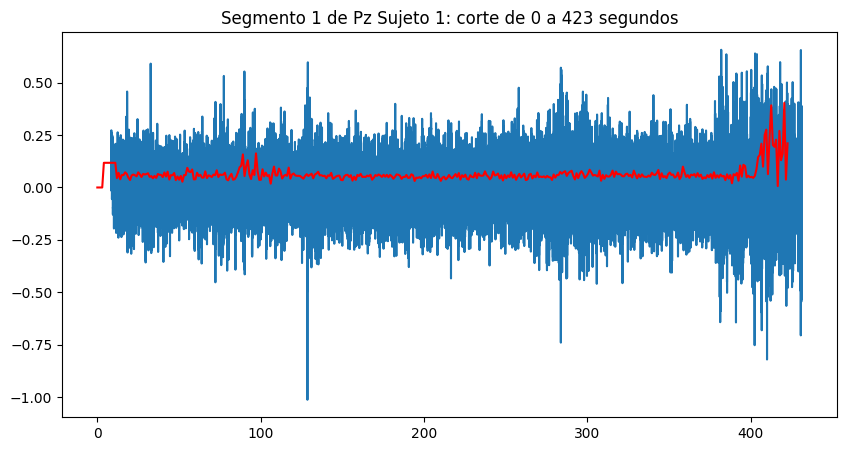

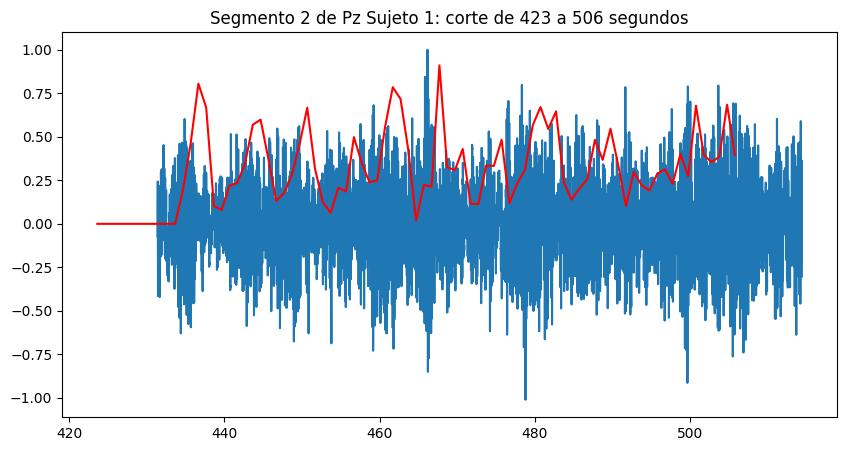

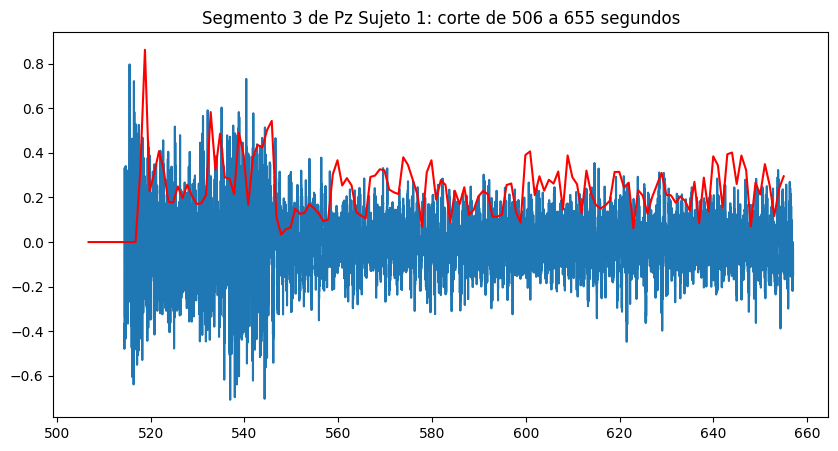

In [ ]:
segmentos_AR_Pz_0, deltas1_AR_Pz_0, ies_AR_Pz_0 = segmentador_AR(senales_FA_0['Pz'], time0, 'Pz Sujeto 1', coef_Pz_0,var_error_Pz_0)

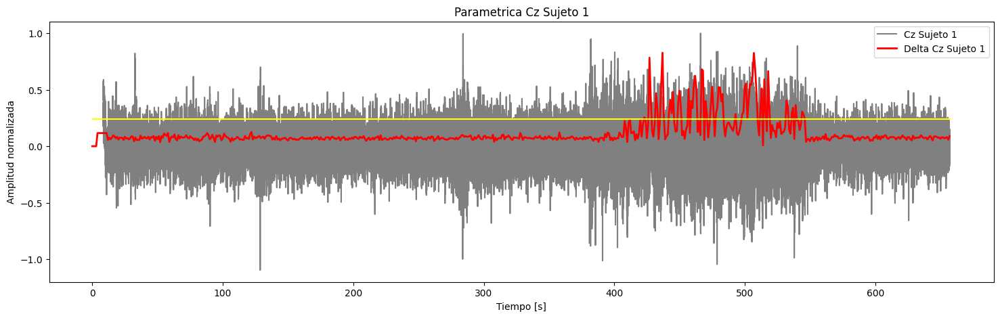

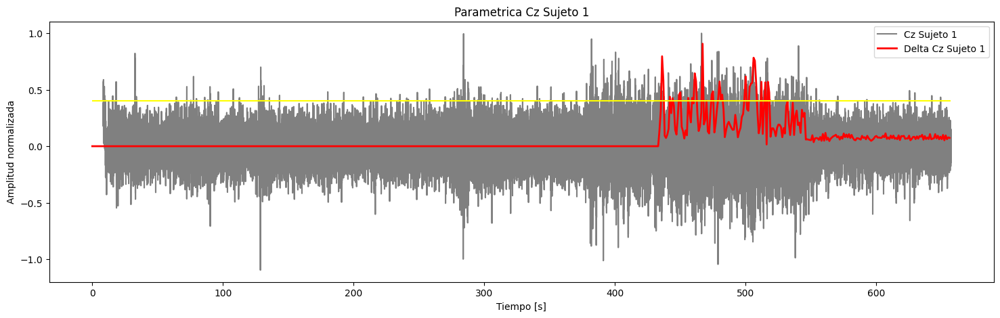

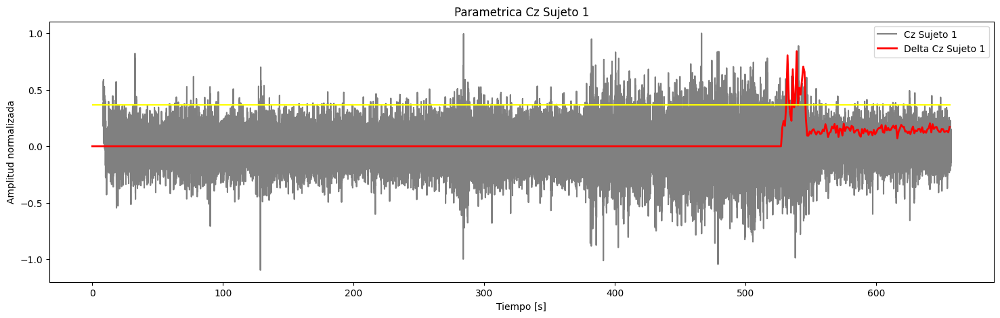

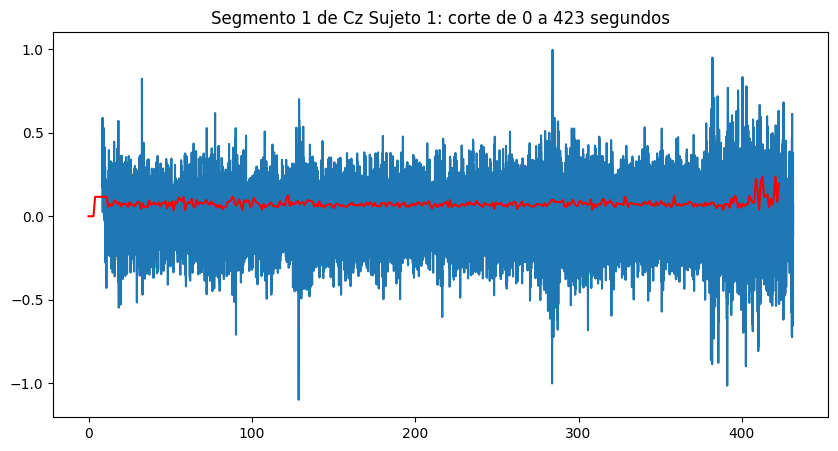

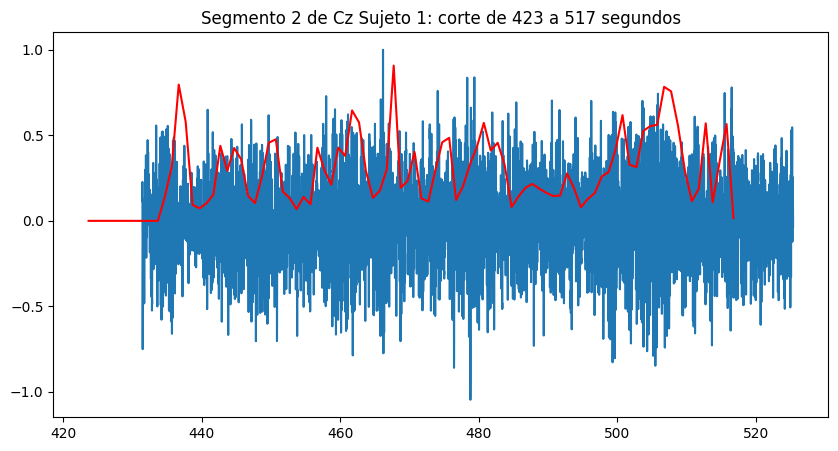

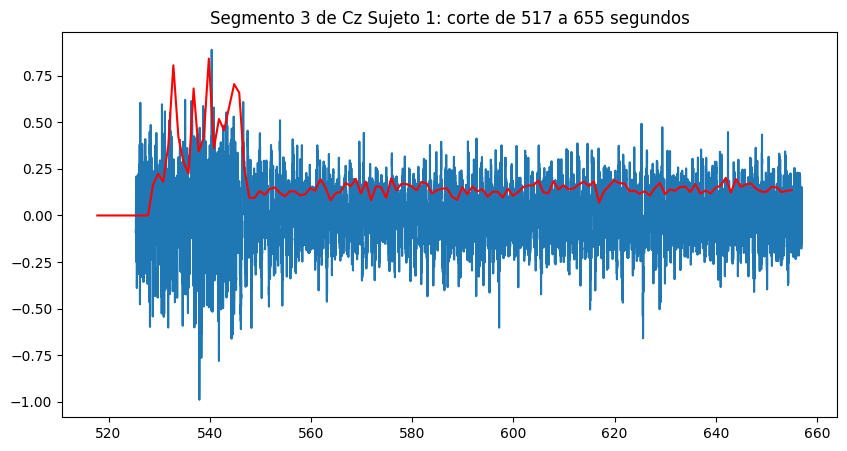

In [ ]:
segmentos_AR_Cz_0, deltas1_AR_Cz_0, ies_AR_Cz_0 = segmentador_AR(senales_FA_0['Cz'], time0, 'Cz Sujeto 1', coef_Cz_0,var_error_Cz_0)

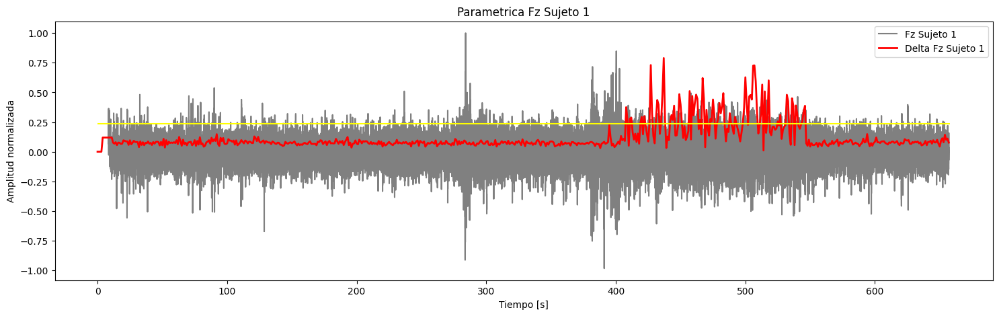

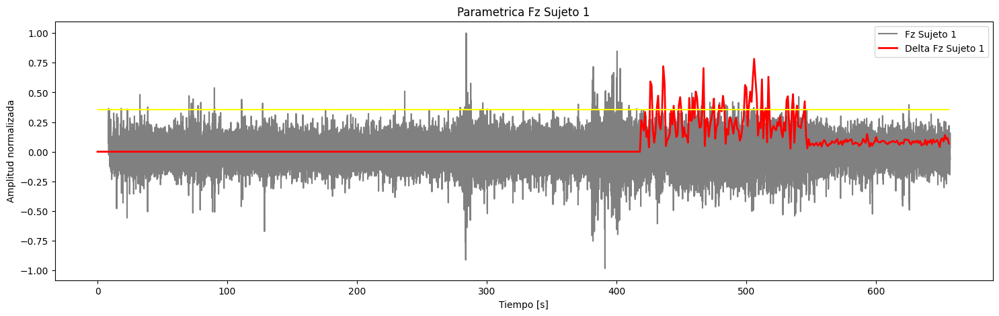

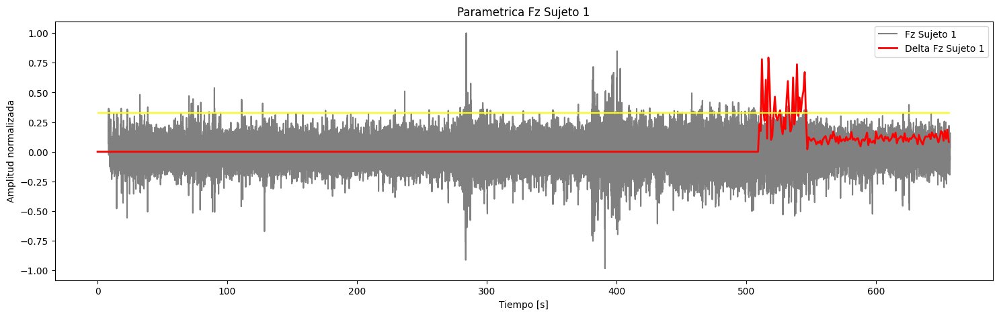

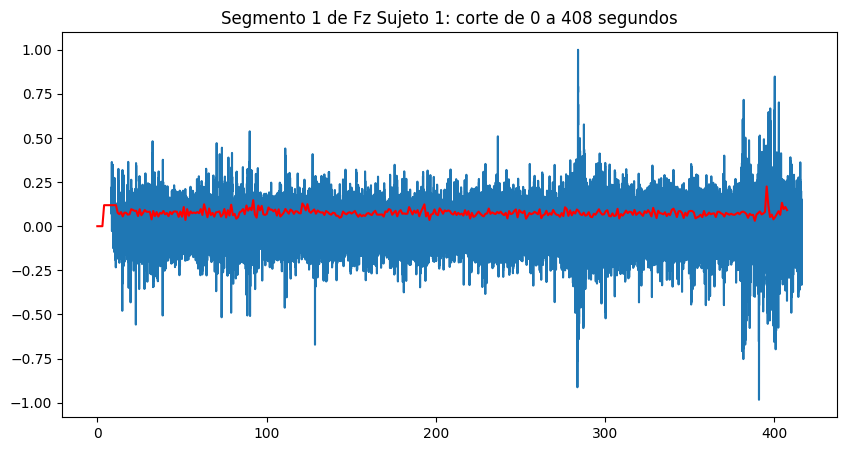

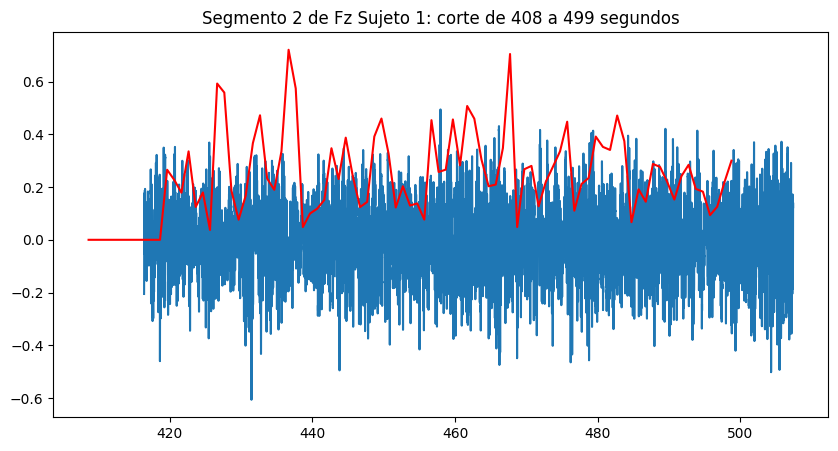

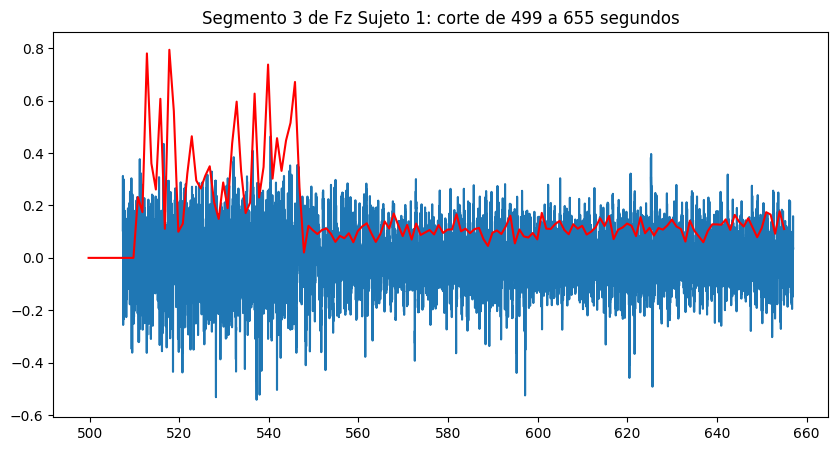

In [ ]:
segmentos_AR_Fz_0, deltas1_AR_Fz_0, ies_AR_Fz_0 = segmentador_AR(senales_FA_0['Fz'], time0, 'Fz Sujeto 1', coef_Fz_0,var_error_Fz_0)

#####Sujeto 2

Esperamos los cortes alrededor de:
*   120-150 segundos
*   360-410 segundos (abrio los ojos)
*   440-510 segundos
*   510 segundos

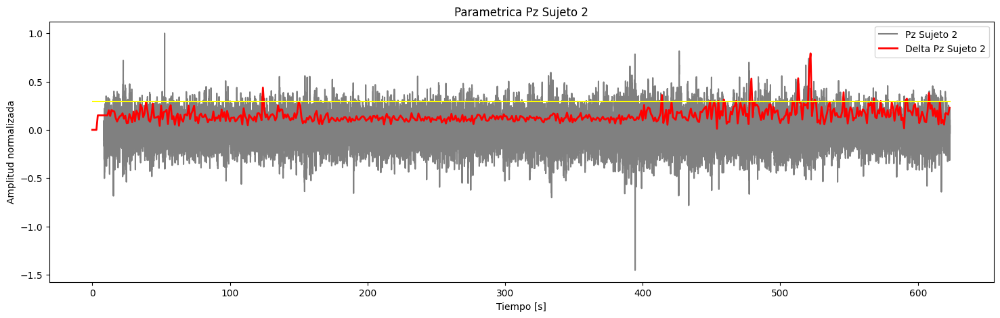

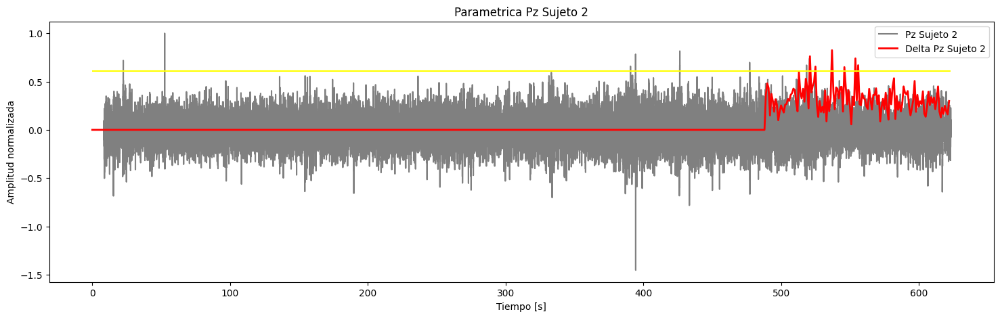

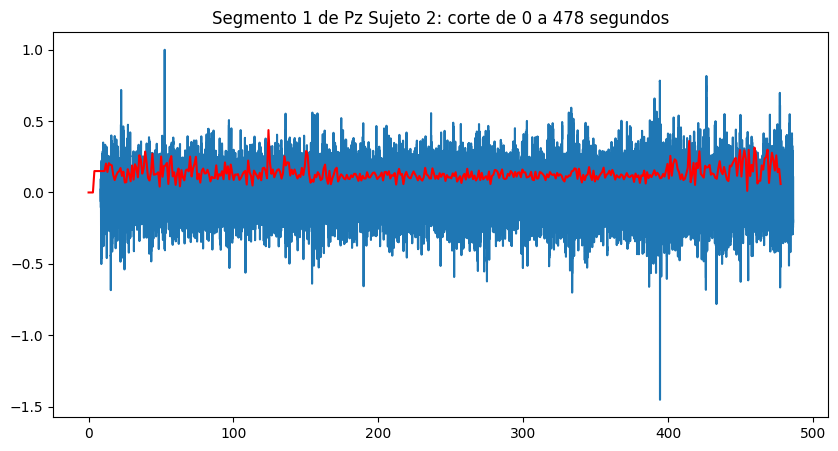

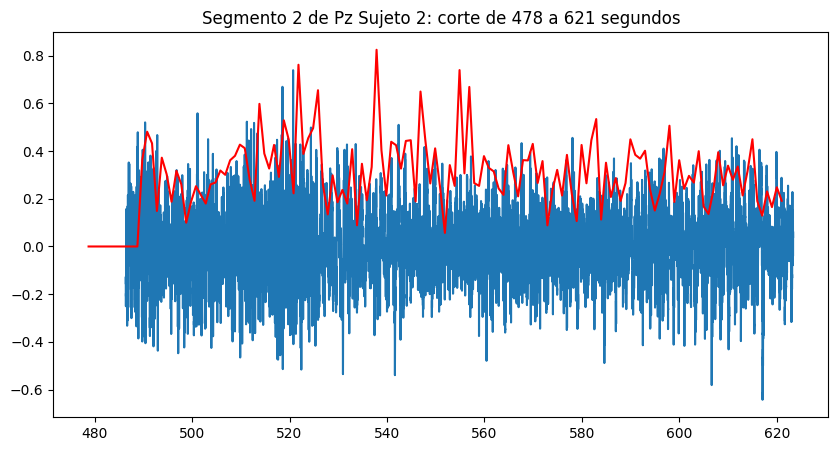

In [ ]:
segmentos_AR_Pz_1, deltas1_AR_Pz_1, ies_AR_Pz_1 = segmentador_AR(senales_FA_1['Pz'], time1, 'Pz Sujeto 2', coef_Pz_1,var_error_Pz_1)

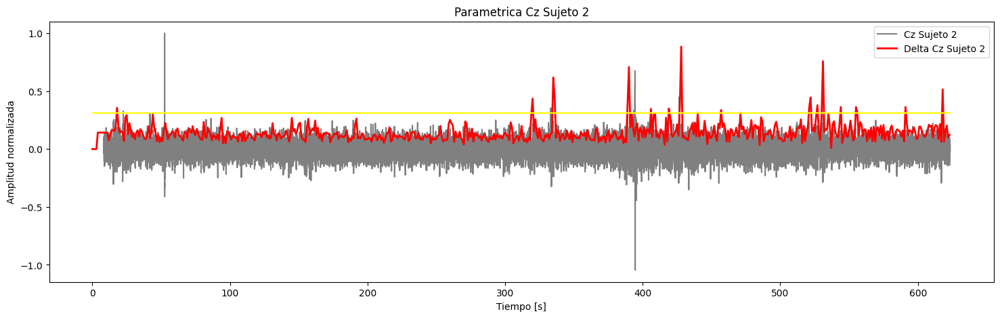

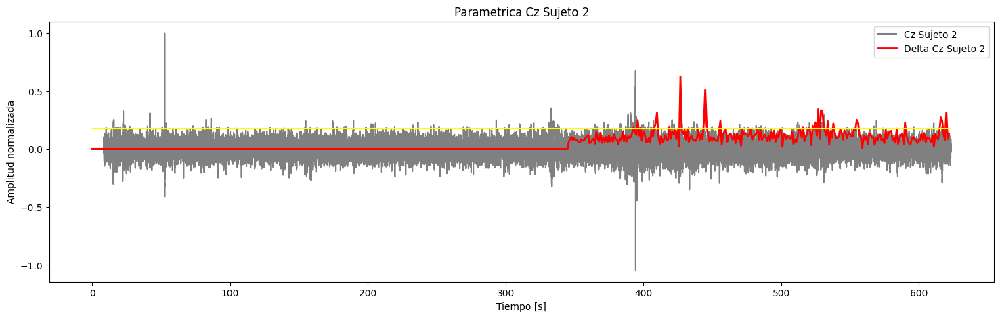

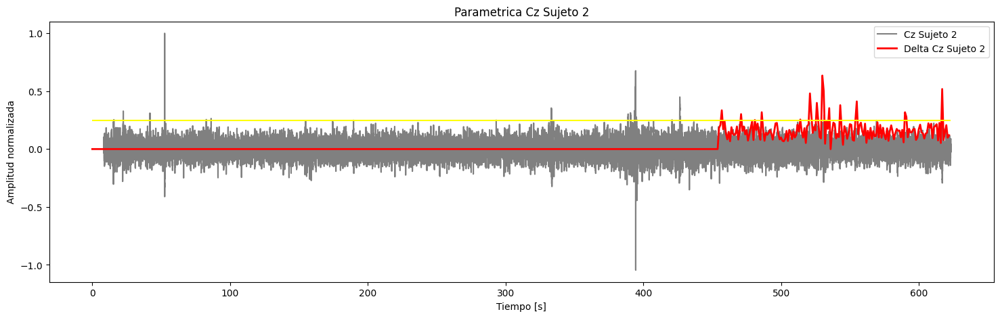

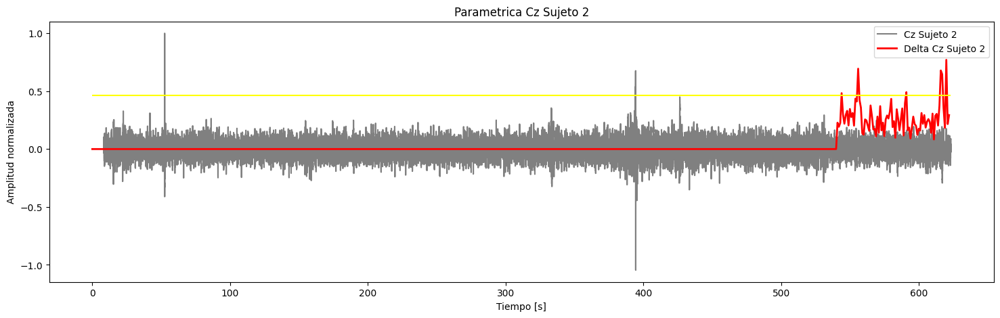

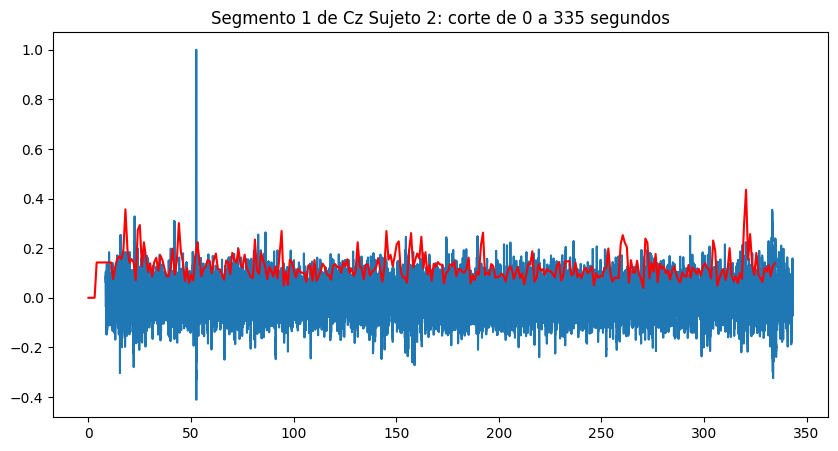

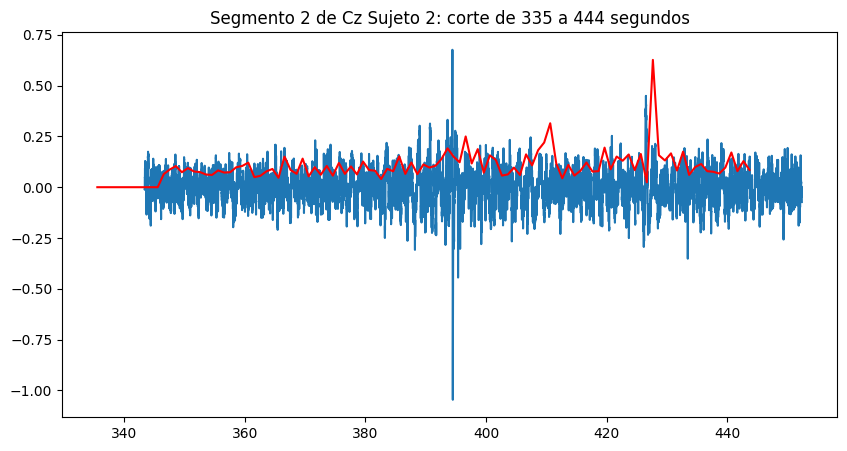

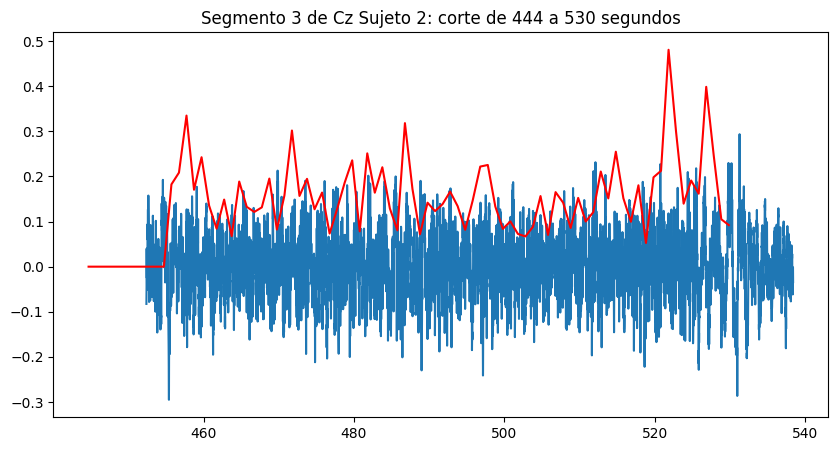

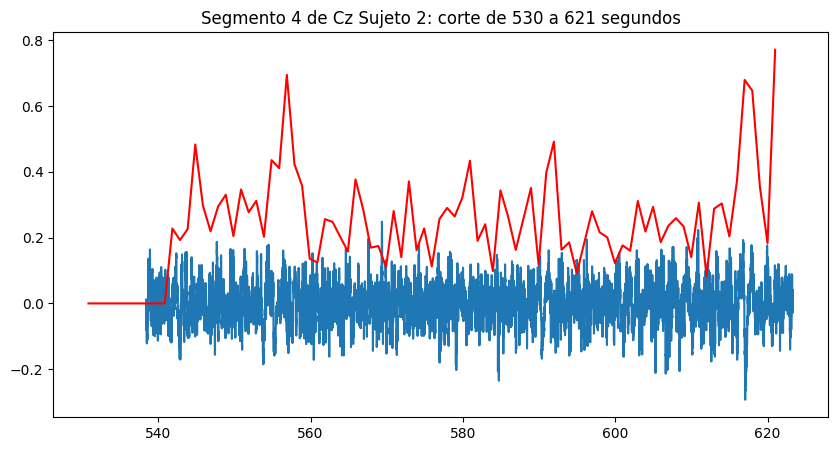

In [ ]:
segmentos_AR_Cz_1, deltas1_AR_Cz_1, ies_AR_Cz_1 = segmentador_AR(senales_FA_1['Cz'], time1, 'Cz Sujeto 2', coef_Cz_1,var_error_Cz_1)

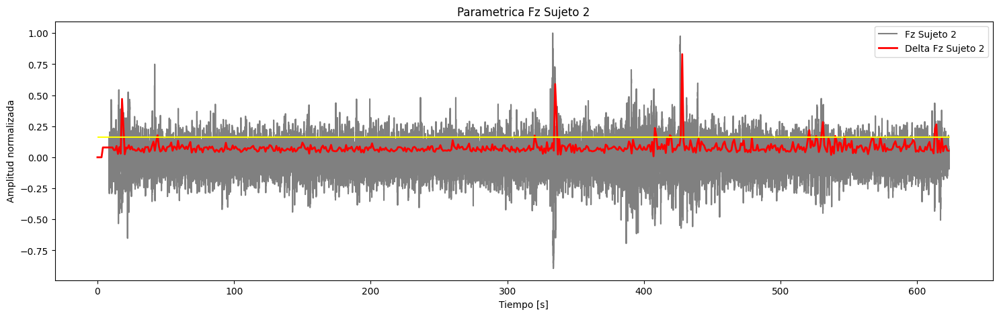

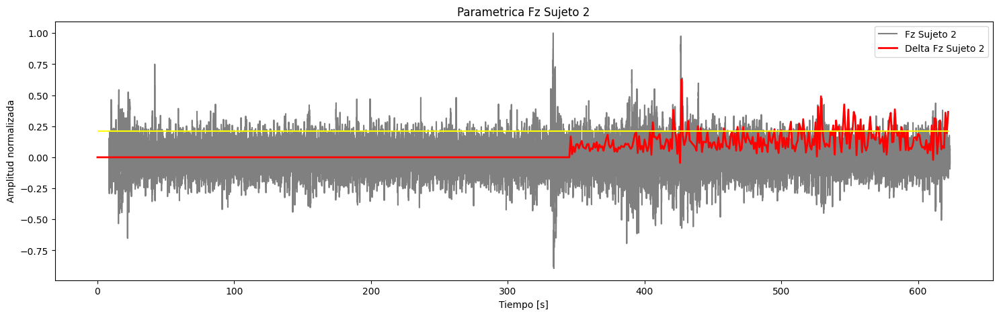

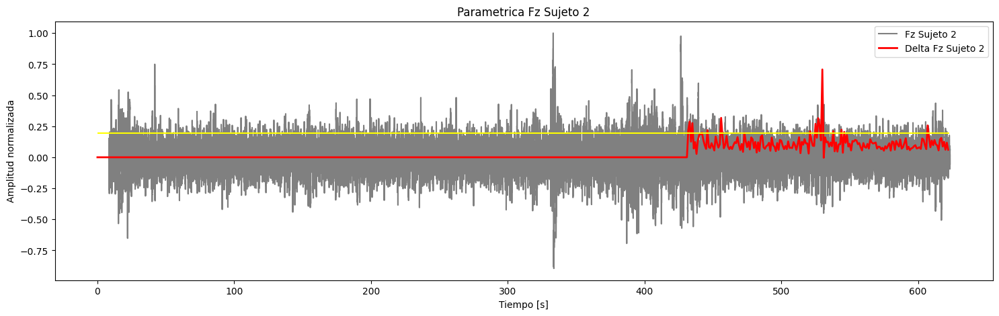

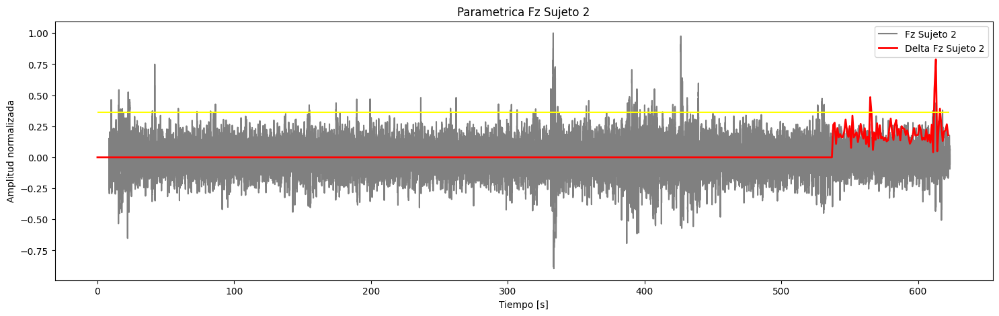

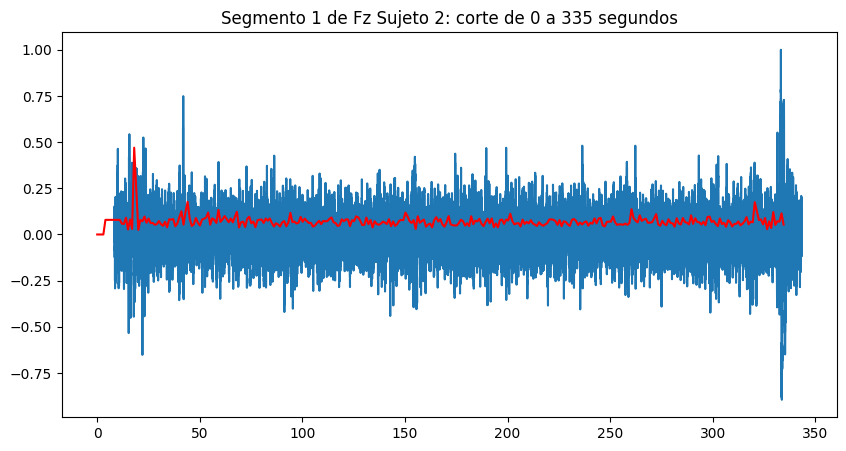

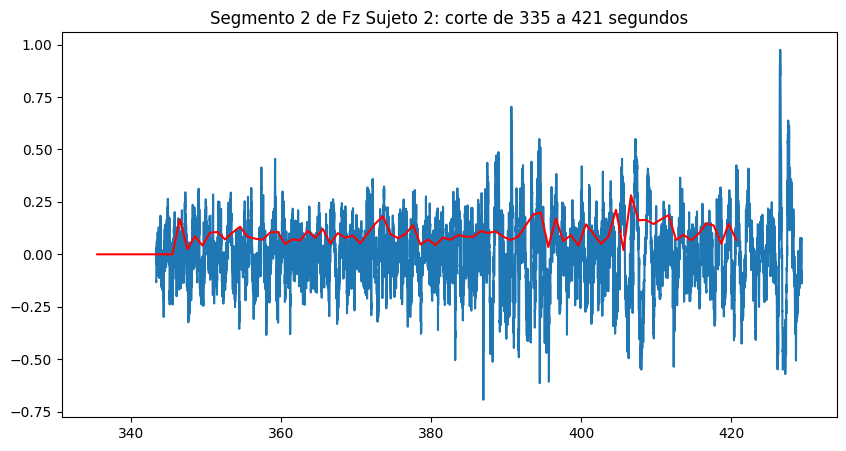

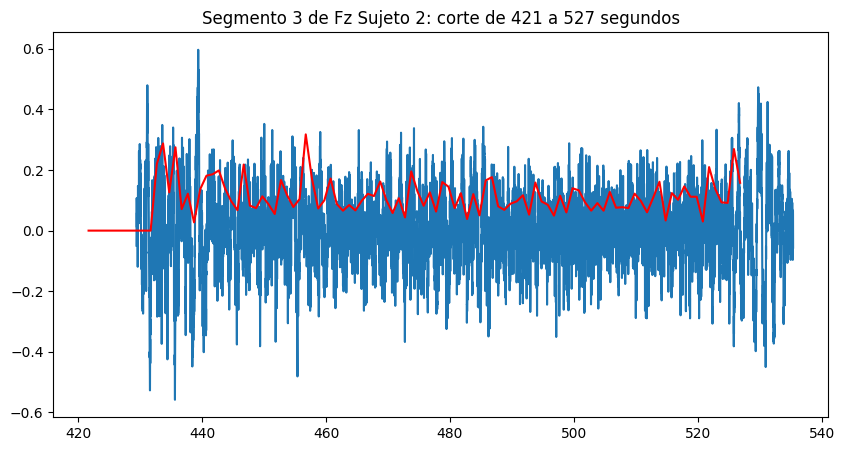

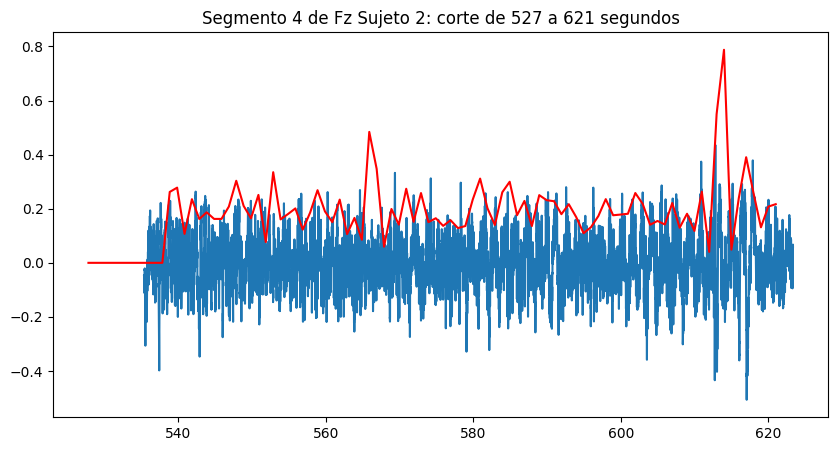

In [ ]:
segmentos_AR_Fz_1, deltas1_AR_Fz_1, ies_AR_Fz_1 = segmentador_AR(senales_FA_1['Fz'], time1, 'Fz Sujeto 2', coef_Fz_1,var_error_Fz_1)

#####Sujeto 3

Esperamos los cortes alrededor de:
*   120-130 segundos
*   360-380 segundos
*   480-500 segundos

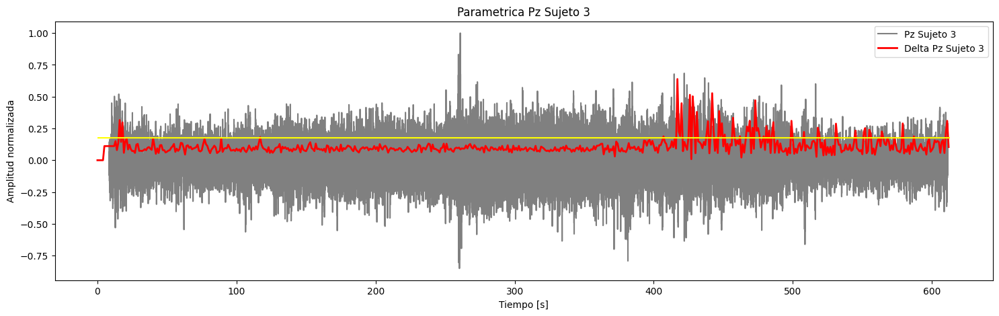

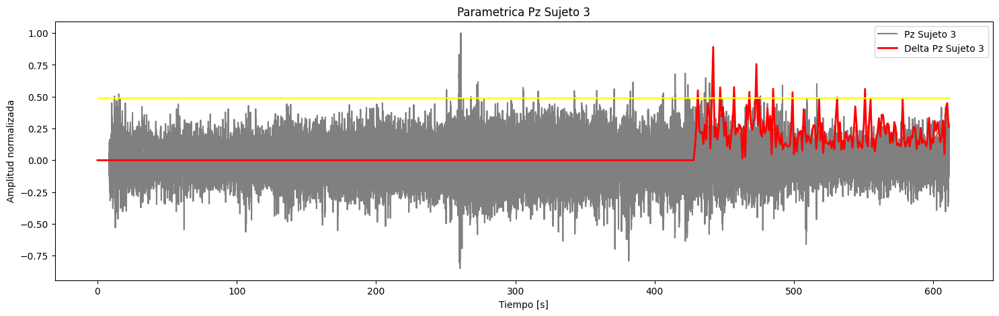

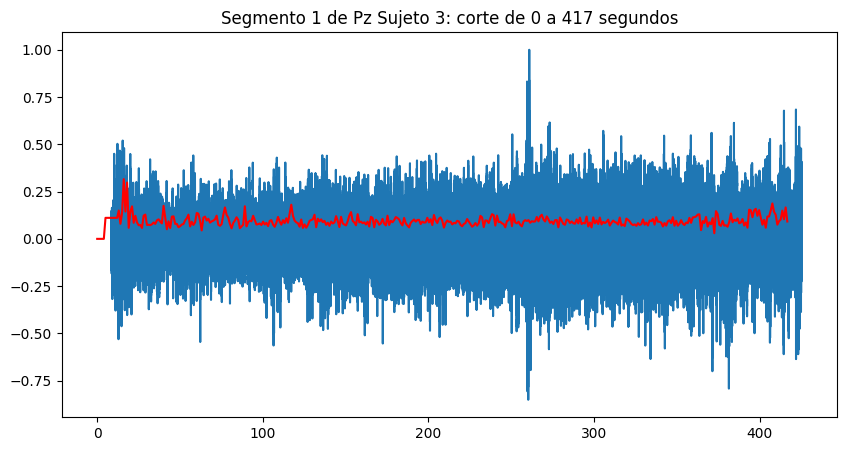

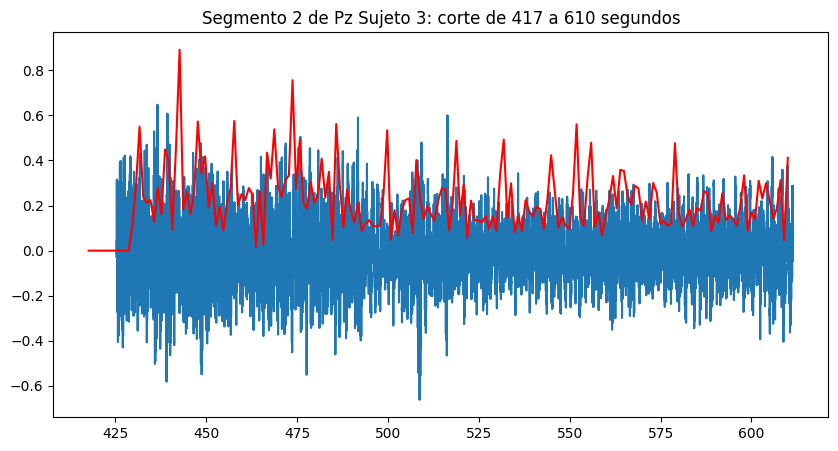

In [ ]:
segmentos_AR_Pz_2, deltas1_AR_Pz_2, ies_AR_Pz_2 = segmentador_AR(senales_FA_2['Pz'], time2, 'Pz Sujeto 3', coef_Pz_2,var_error_Pz_2)

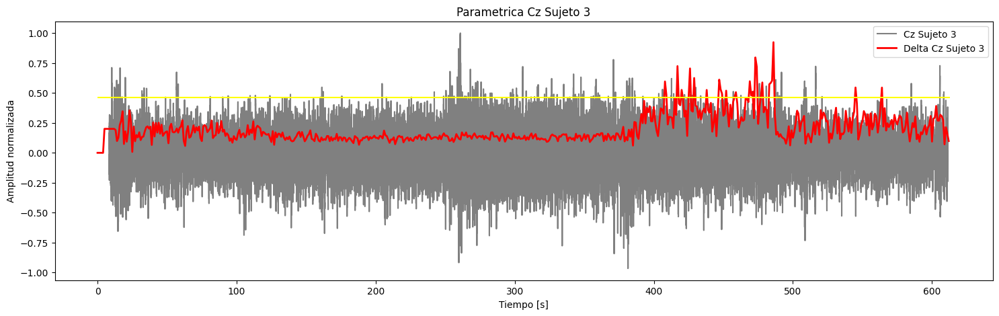

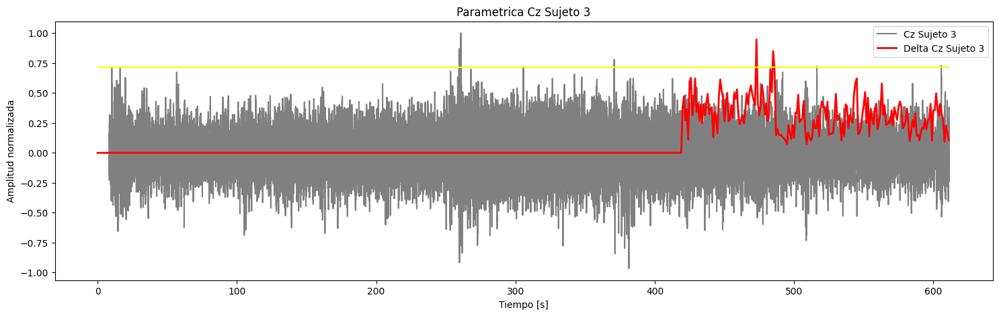

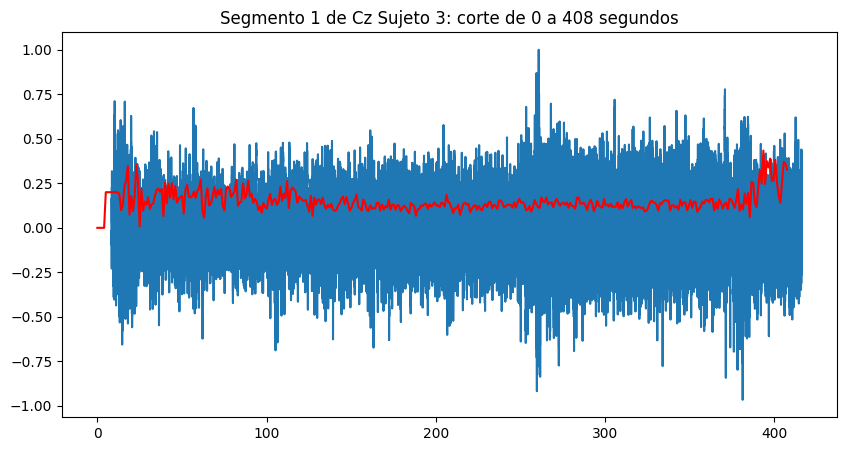

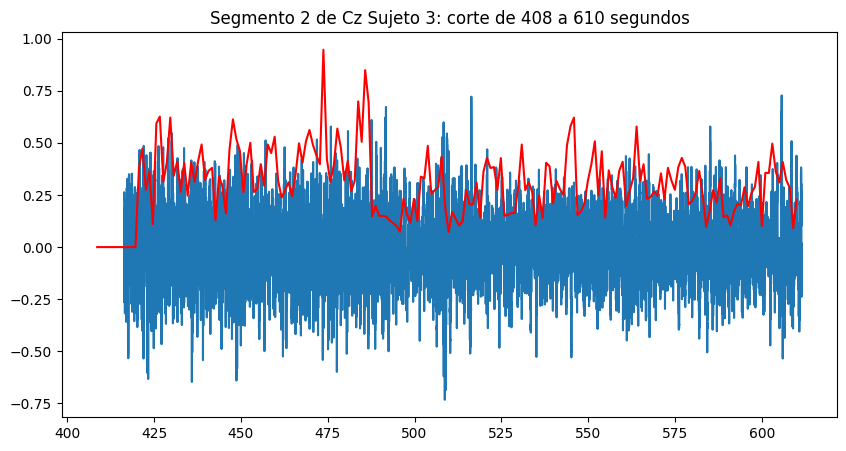

In [ ]:
segmentos_AR_Cz_2, deltas1_AR_Cz_, ies_AR_Cz_2 = segmentador_AR(senales_FA_2['Cz'], time2, 'Cz Sujeto 3', coef_Cz_2,var_error_Cz_2)

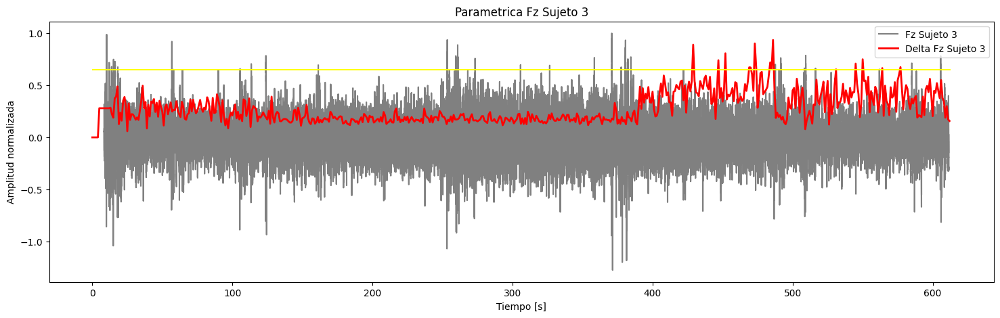

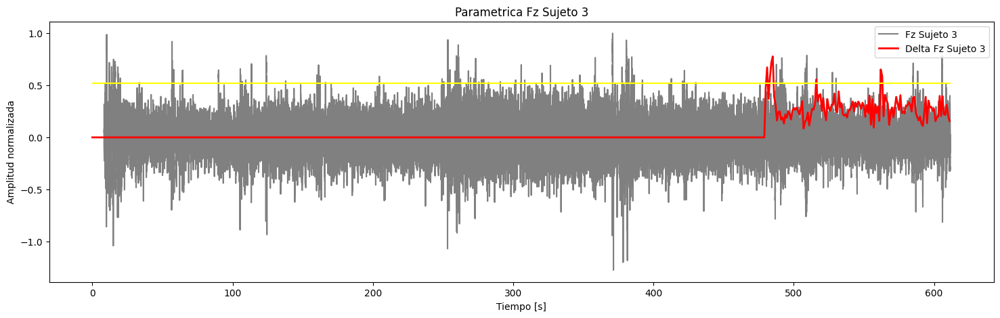

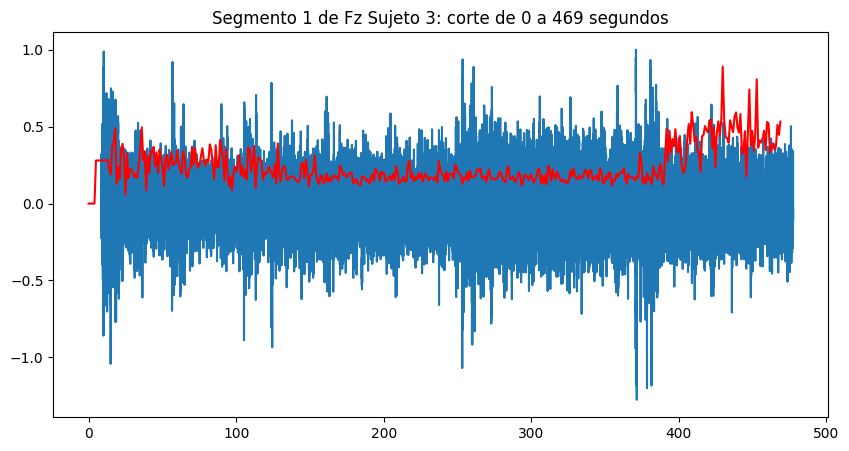

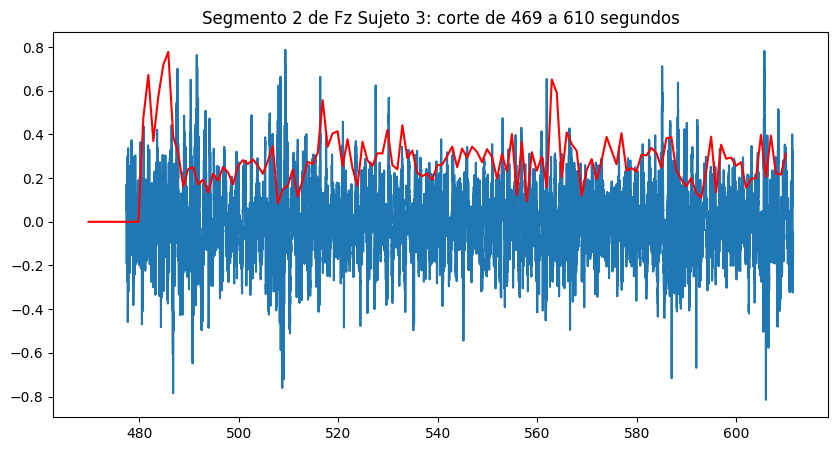

In [ ]:
segmentos_AR_Fz_2, deltas1_AR_Fz_2, ies_AR_Fz_2 = segmentador_AR(senales_FA_2['Fz'], time2, 'Fz Sujeto 3', coef_Fz_2,var_error_Fz_2)

##Análisis de Performance

In [ ]:
print('Se observan la cantidad de segmentos para tener en cuenta qué método y sujeto utilizar para el analisis espectral')
print('Método Periodograma Móvil')
print('Sujeto 1: Se esperan 4 segmentos\n Pz:', len(period_Pz_0), '\n Cz:', len(period_Cz_0), '\n Fz:',len(period_Fz_0))
print('Sujeto 2: Se esperan 5 segmentos\n Pz:', len(period_Pz_1), '\n Cz:', len(period_Cz_1), '\n Fz:',len(period_Fz_1))
print('Sujeto 3: Se esperan 4 segmentos\n Pz:', len(period_Pz_2), '\n Cz:', len(period_Cz_2), '\n Fz:',len(period_Fz_2))
print('\nMétodo Paramétrico')
print('Sujeto 1: Se esperan 4 segmentos\n Pz:', len(segmentos_AR_Pz_0), '\n Cz:', len(segmentos_AR_Cz_0), '\n Fz:',len(segmentos_AR_Fz_0))
print('Sujeto 2: Se esperan 5 segmentos\n Pz:', len(segmentos_AR_Pz_1), '\n Cz:', len(segmentos_AR_Cz_1), '\n Fz:',len(segmentos_AR_Fz_1))
print('Sujeto 3: Se esperan 4 segmentos\n Pz:', len(segmentos_AR_Pz_2), '\n Cz:', len(segmentos_AR_Cz_2), '\n Fz:',len(segmentos_AR_Fz_2))

Se observan la cantidad de segmentos para tener en cuenta qué método y sujeto utilizar para el analisis espectral
Método Periodograma Móvil
Sujeto 1: Se esperan 4 segmentos
 Pz: 3 
 Cz: 5 
 Fz: 6
Sujeto 2: Se esperan 5 segmentos
 Pz: 7 
 Cz: 6 
 Fz: 5
Sujeto 3: Se esperan 4 segmentos
 Pz: 5 
 Cz: 5 
 Fz: 6

Método Paramétrico
Sujeto 1: Se esperan 4 segmentos
 Pz: 3 
 Cz: 3 
 Fz: 3
Sujeto 2: Se esperan 5 segmentos
 Pz: 2 
 Cz: 4 
 Fz: 4
Sujeto 3: Se esperan 4 segmentos
 Pz: 2 
 Cz: 2 
 Fz: 2


A partir de la cantidad de segmentos y la utilidad de los mismos a partir de los gráficos observados: especialmente los de la señal de EEG vs el coeficiente de dismilitud, se puede ver como el método de periodograma móvil da en la gran mayoría de los casos un resultado más confiable que el caso paramétrico. Esto se puede ver en que al segmentar y cambiar el coeficiente de disimilitud (es decir que existe un cambio de estado), al calularse nuevamente el mismo sigue dando muy similar al caso anterior, cosa que genera dudas. Sin embargo, al revisar la fórmula reiteradas veces, queda la solución de descartarlo para el análisis posterior.

**Por consiguiente, se decide realizar el análisis frecuencial con los segmentos obtenidos del método de periodograma móvil con ventana de referncia fija.**

Esto se realiza más allá de conocer las limitaciones del segmentador offline; ya que existen desfasajes de más de 20 segundos en algunos casos con respecto al corte esperado. Sin embargo, es la mejor referencia que se obtiene. Se cree que estos desfasajes y cortes imprecisos se deben a la técnica utilizada para revisar que se supere por más de 1 segundo el umbral. Esto se chequeó en cantidad de tiempo (656 segundos) en vez de en cantidad de muestras (aprox 162000). Si se realizaba el abordaje teniendo en cuenta las muestras, se podía anlizar por fragmentos de segundo, mientras que al hacerlo en segundos y recorrer el vector de a 1 segundo, esto permitía una fuente de error mayor.


Por ejemplo, se puede observar que se segmenta en reiterados casos en el medio del segmento de concentración en tareas de esfuerzo cognitivo (cuentas matemáticas). Esto se cree que es porque se logró un estado de mayor concentración a medida que las cuentas matemáticas se complejizaban. Genernado entonces un corte en donde no se esperaba, entre los 120 y 360 segundos del estudio, usualmente apareciendo entre 250 y 300.

Por otro lado, teniendo en cuenta a los distintos sujetos, se ve una segmentación más uniforme de los 3 canales en el sujeto 3. Se ve una varianza clara entre los 3 canales para los sujetos 1 y 2. Esto se supone que se debe a conflictos con el entorno, con el paciente o con la colocación de los electrodos; siendo todso estos errores humanos.

Se sabe que el Sujeto 1 se asustó entre los 7 y 8 minutos. Y también se sabe que la Sujeto 2 abrió los ojos en el período cuando se esperaba que esté con los ojos cerrados.

Como el código está realizado de forma genérica para que los segmentos sean mayores a 80 segundos (pues se espera de eso según las indicaciones del Laboratorio), si hay interrupciones antes, es posible que se ignoren o que segmente de más si es que hubo una segmentación inesperada previamente.

##Analisis Frecuencial y ritmos dominantes

Lo que se espera ver según la bibliografía

    Estado basal = predominancia Beta frecuencia media / alta [2]

    Estado matemática = predominancia Gamma [1]

    Estado Ojos Cerrados = predominancia Alfa [3]

    Estado Relajación Ojos Abiertos = Predominancia Beta baja frecuencia [2]


In [ ]:
def analisis_frecuencial(segm, time, delta1, ies, titulo):
  j=0
  k=1
  for i in ies:
    tiempito=np.linspace(0,int(len(delta1[f'Segmento{k}'])),int(len(delta1[f'Segmento{k}'])))

    fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(20, 6))
    fig.suptitle(f'Analisis espectral para Segmento {k} de {titulo}. Corte de {j} a {i} segundos', fontsize=15)
    ax1.set_title(f'Segmento del EEG')
    ax1.plot(time[j*fs:i*fs],segm[f'Segmento{k}'],'gray',label=f'{titulo}')
    ax1.plot(tiempito[j:i],delta1[f'Segmento{k}'][j:i],'red',linewidth=2,label=f'Delta {titulo}')
    ax1.legend(loc='lower right')
    ax1.set_xlabel('Tiempo [s]')
    ax1.set_ylabel('Amplitud normalizada')

    ticks = [l for l in range(0, 65, 5)]
    values = [str(l) for l in range(0, 65, 5)]
    ax2.psd(segm[f'Segmento{k}'], Fs=fs, NFFT=2**10) #Cambiar NFFT !!
    ax2.set_title(f'Power Spectral Density Segmento {k} de {titulo}')
    ax2.set_xlim([0, 65])
    ax2.set_xticks(ticks)
    ax2.set_xticklabels(values)

    j=i
    k+=1

####Sujeto 1

Periodograma

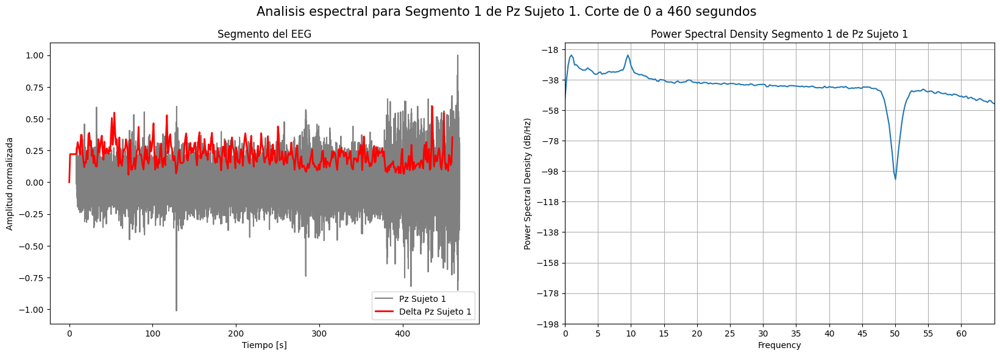

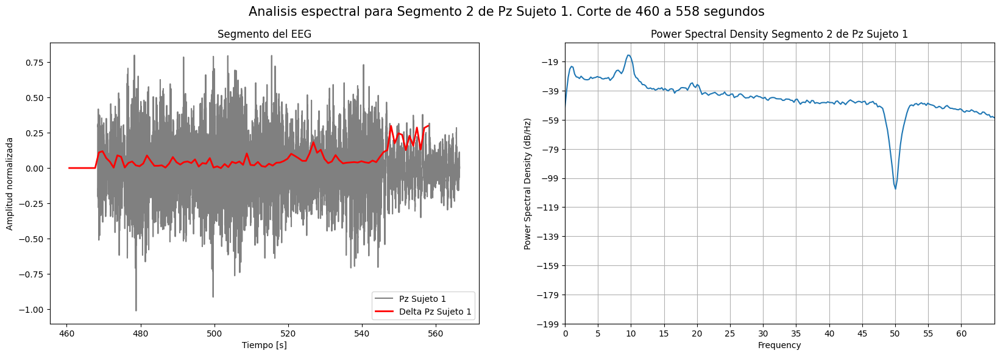

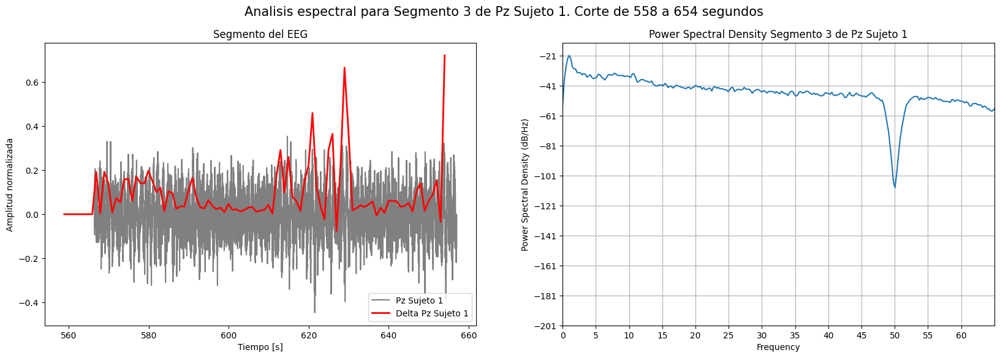

In [ ]:
analisis_frecuencial(period_Pz_0, time0, deltas1_Pz_0, ies_Pz_0, 'Pz Sujeto 1')

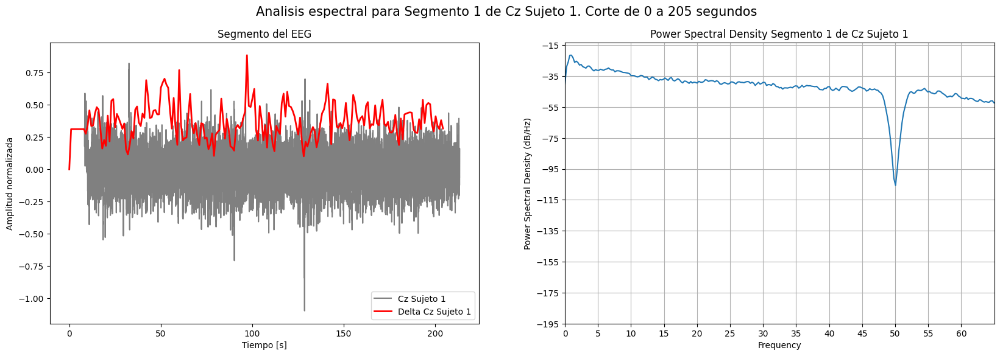

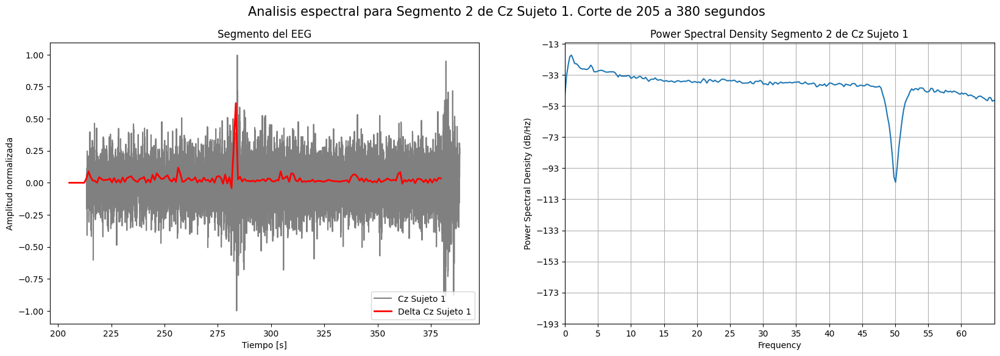

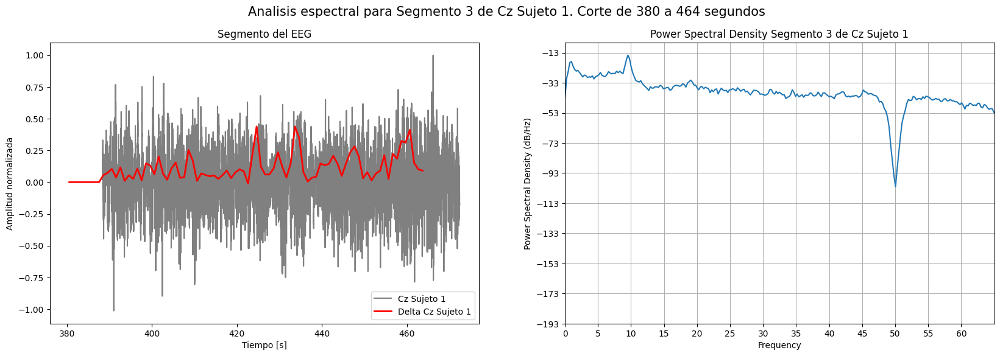

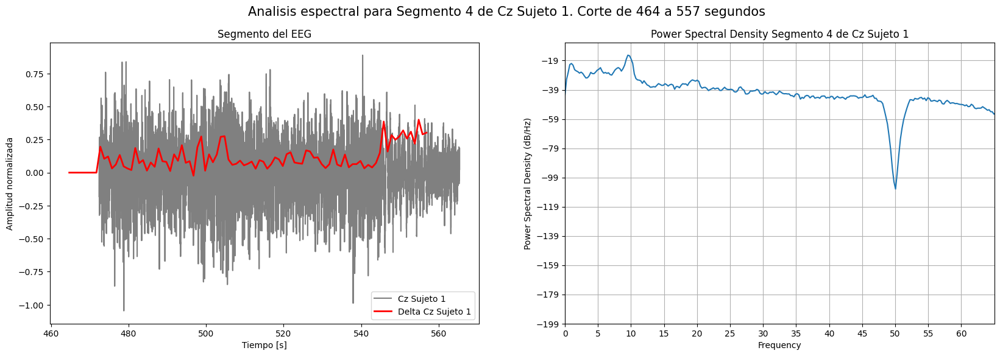

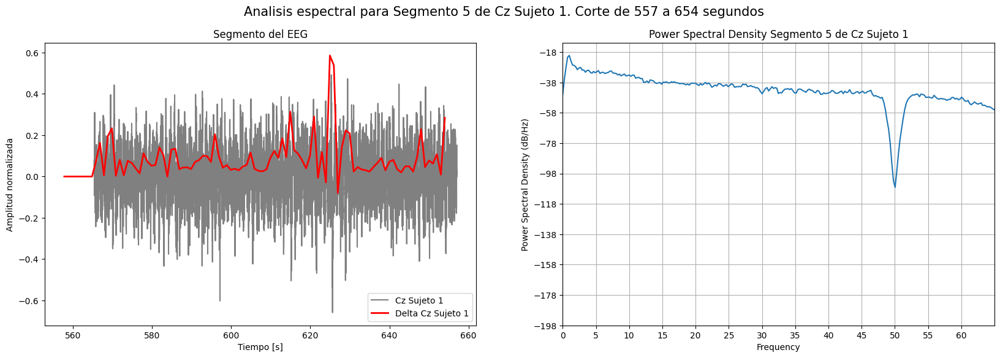

In [ ]:
analisis_frecuencial(period_Cz_0, time0, deltas1_Cz_0, ies_Cz_0, 'Cz Sujeto 1')

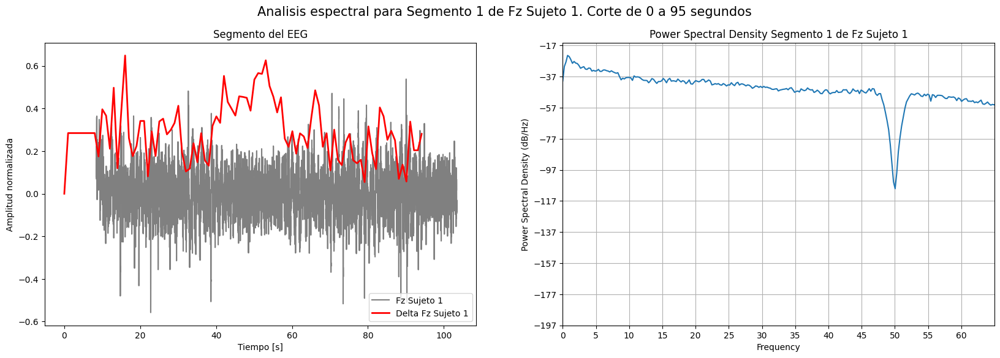

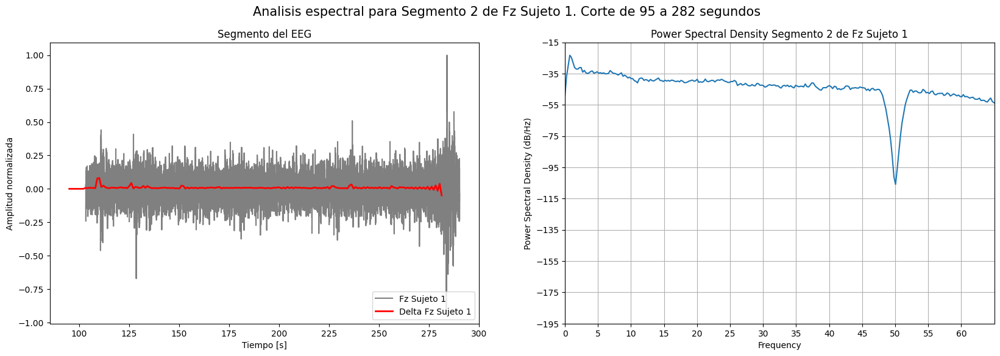

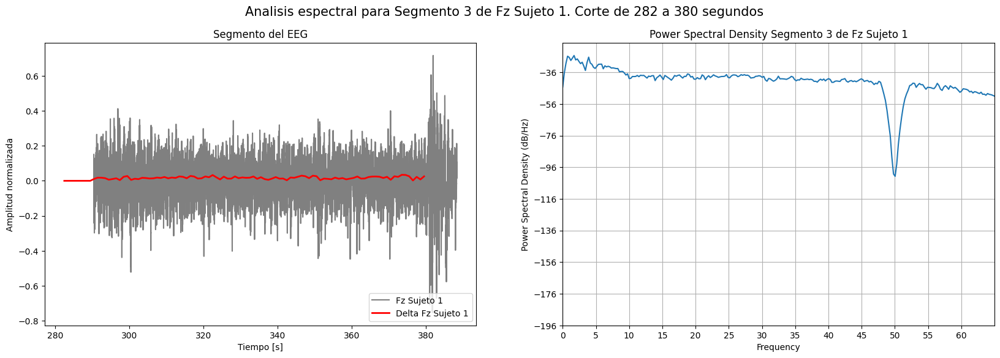

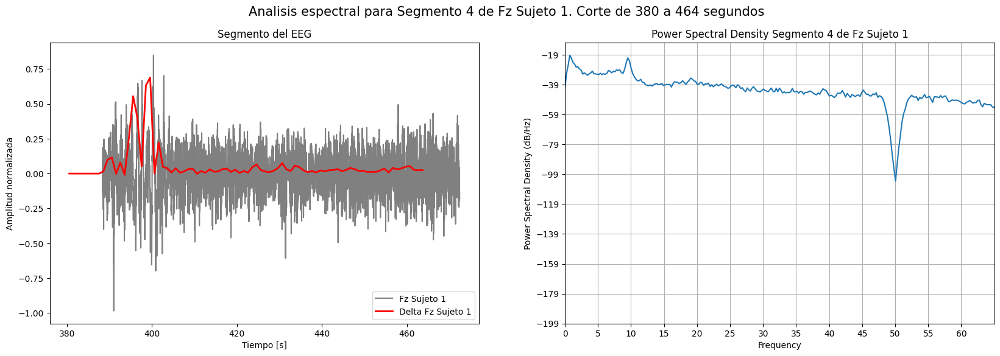

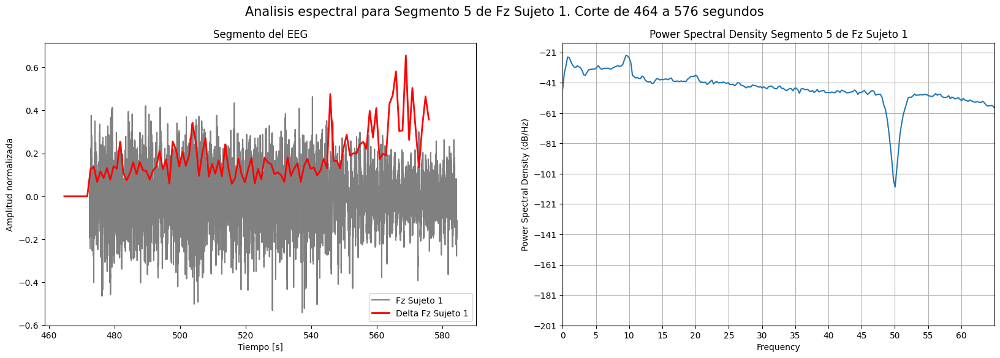

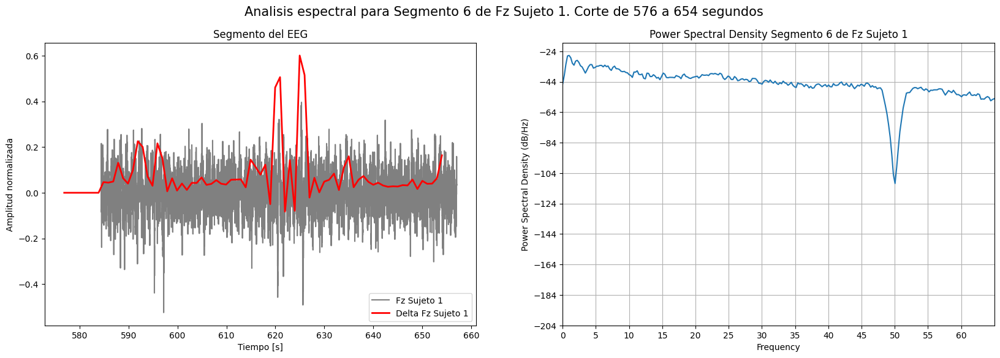

In [ ]:
analisis_frecuencial(period_Fz_0, time0, deltas1_Fz_0, ies_Fz_0, 'Fz Sujeto 1')

####Sujeto 2

Periodograma

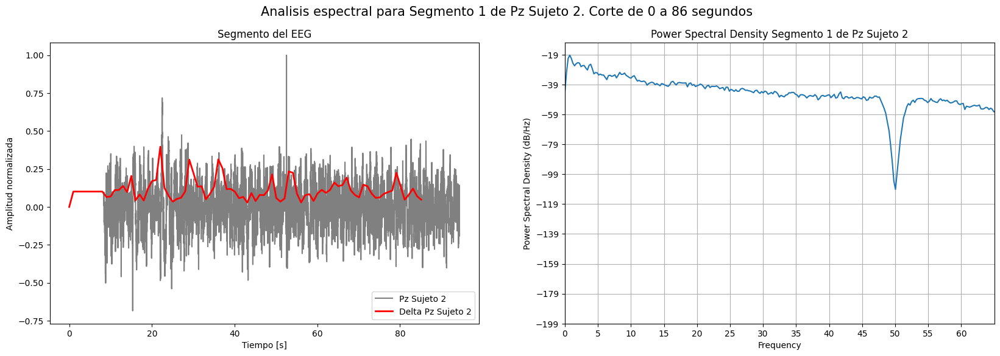

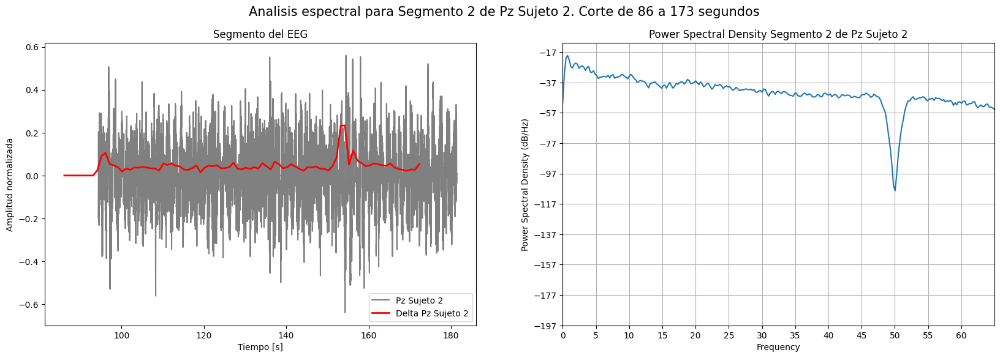

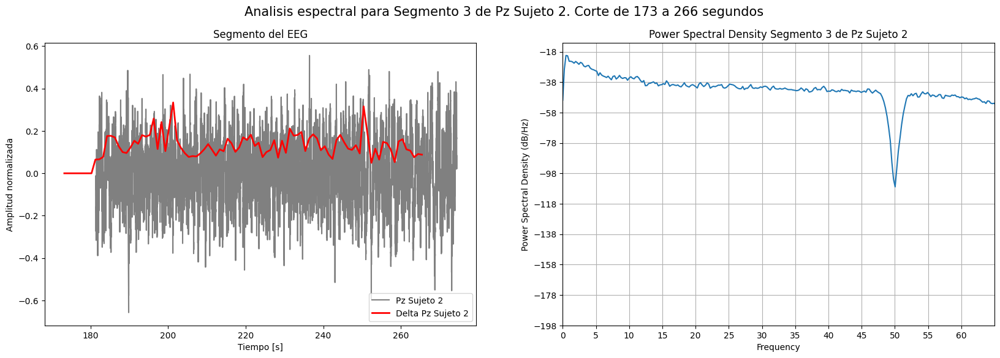

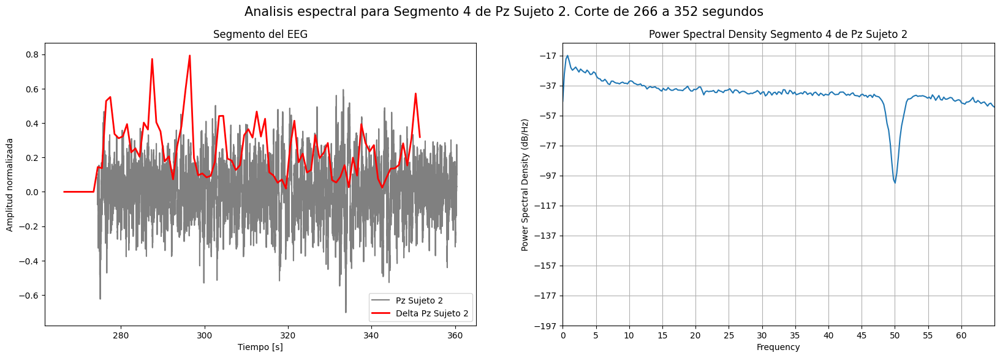

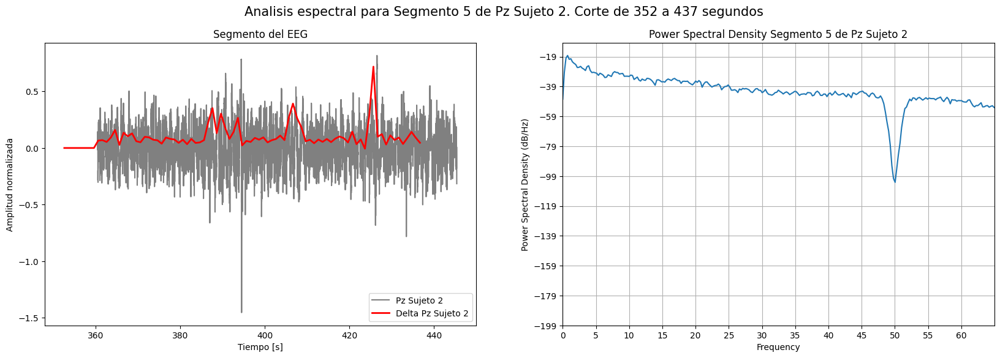

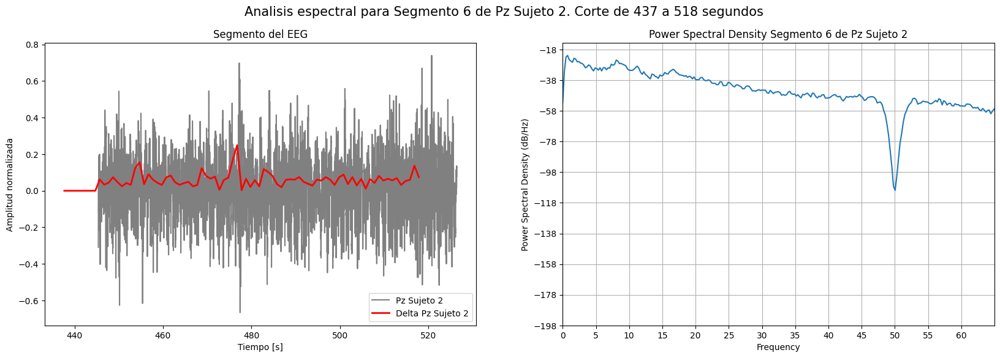

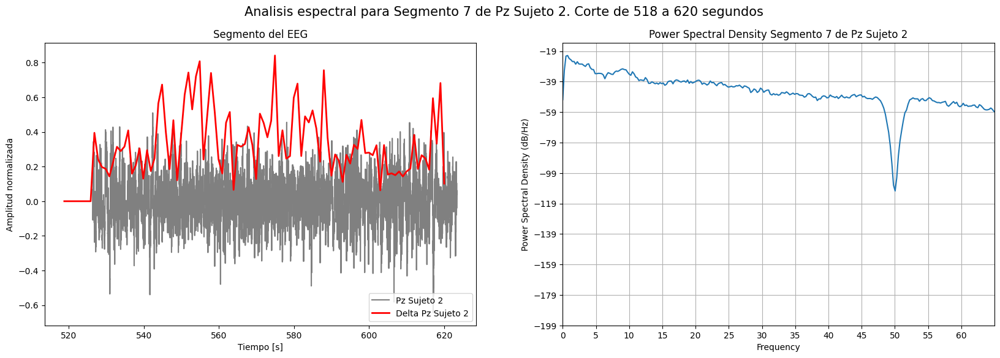

In [ ]:
analisis_frecuencial(period_Pz_1, time1, deltas1_Pz_1, ies_Pz_1, 'Pz Sujeto 2')

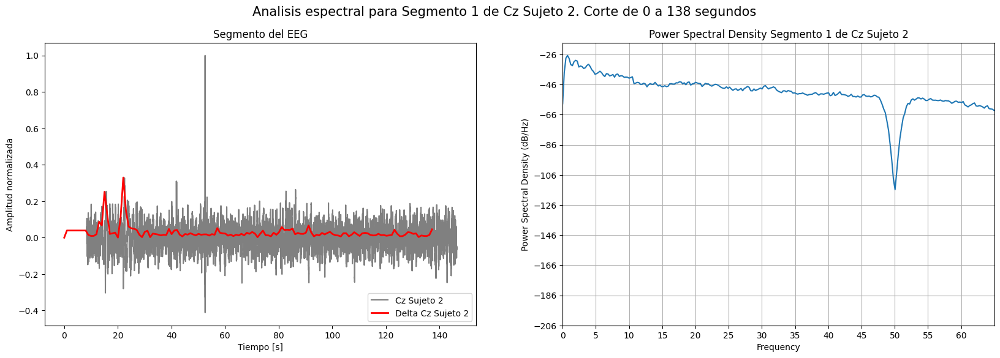

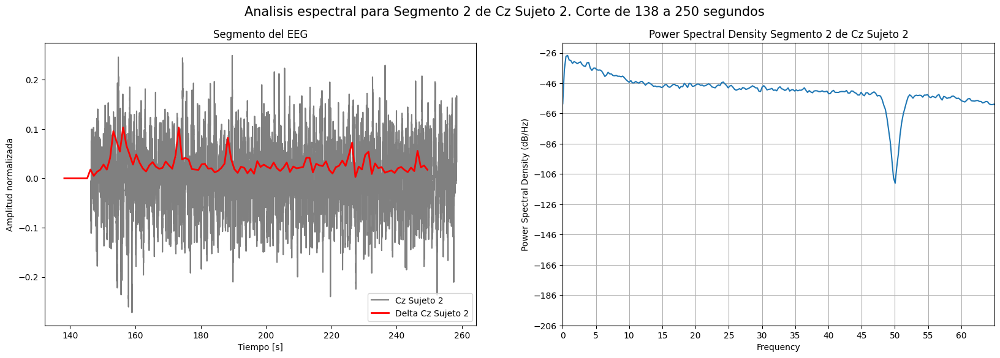

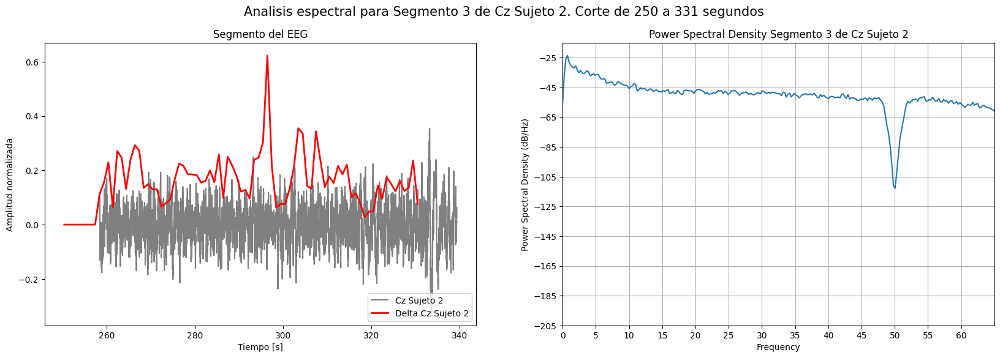

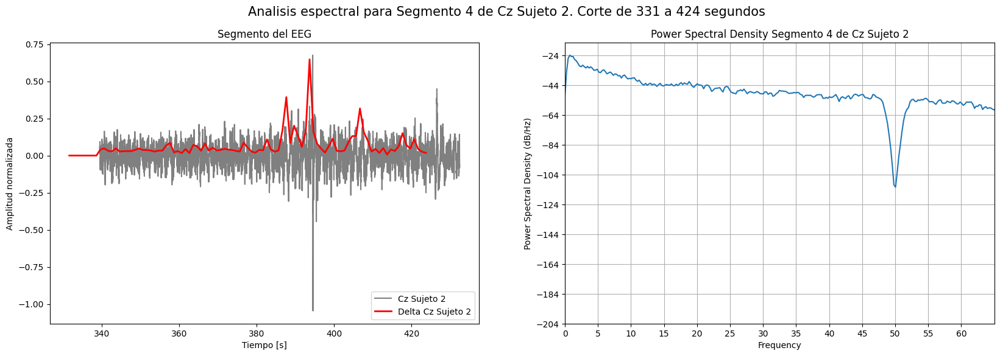

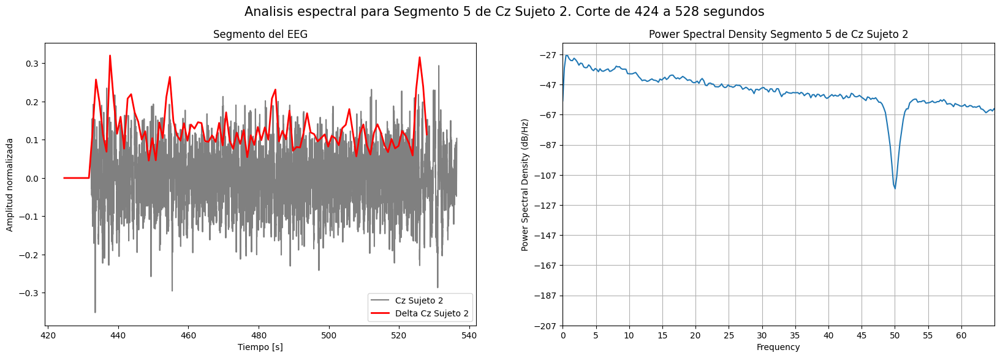

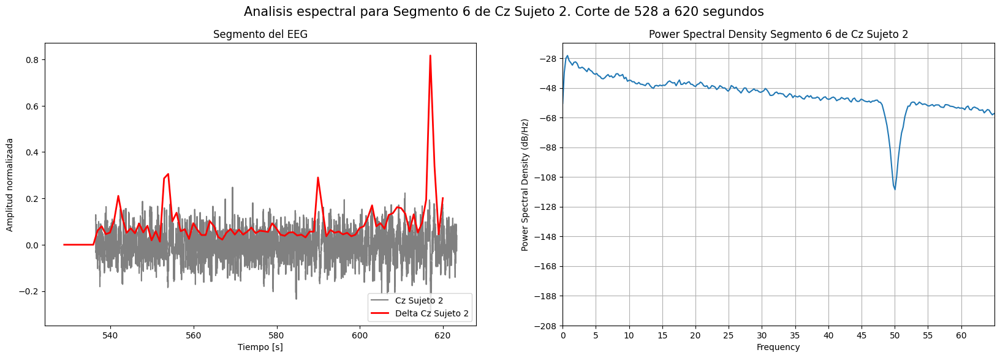

In [ ]:
analisis_frecuencial(period_Cz_1, time1, deltas1_Cz_1, ies_Cz_1, 'Cz Sujeto 2')

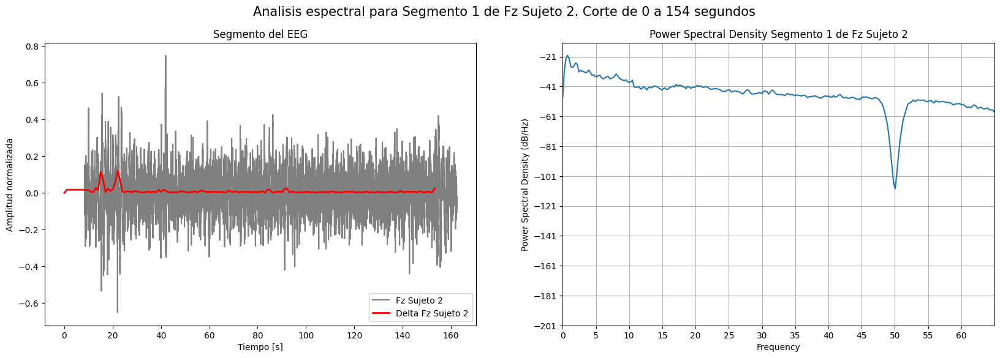

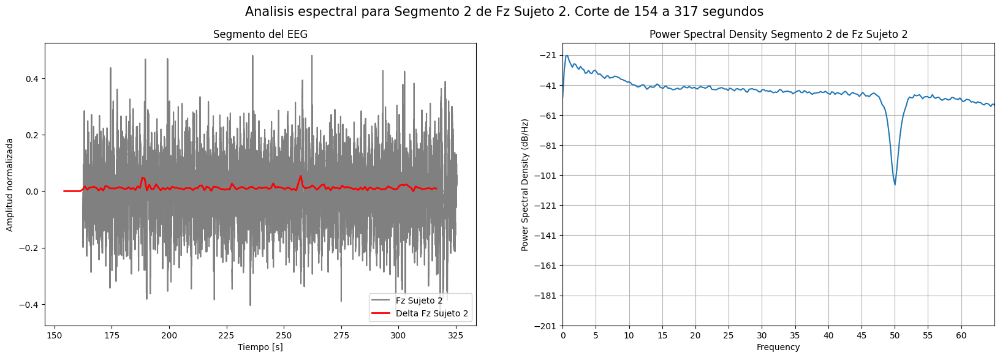

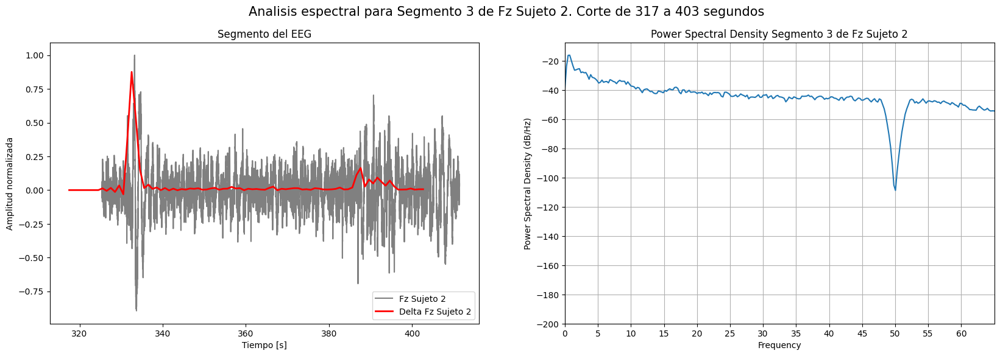

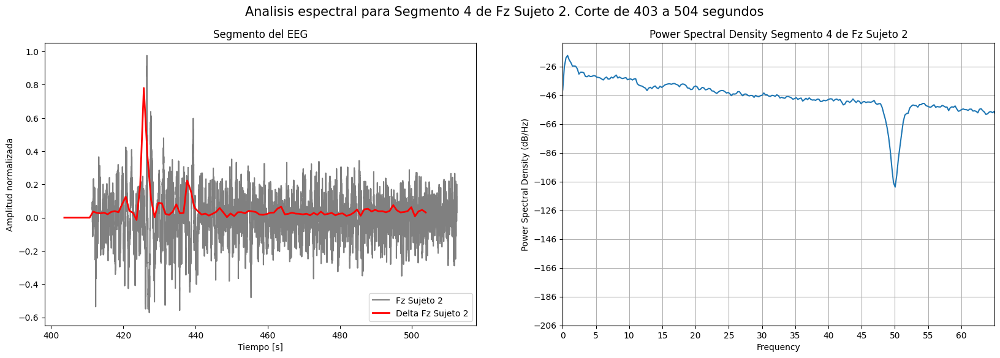

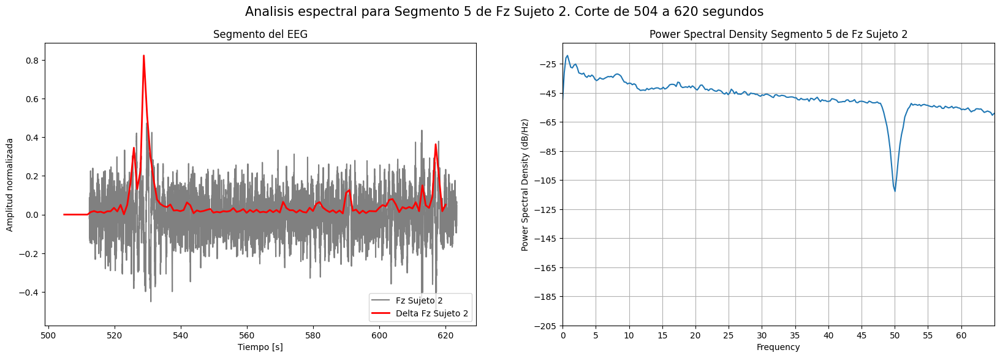

In [ ]:
analisis_frecuencial(period_Fz_1, time1, deltas1_Fz_1, ies_Fz_1, 'Fz Sujeto 2')

####Sujeto 3

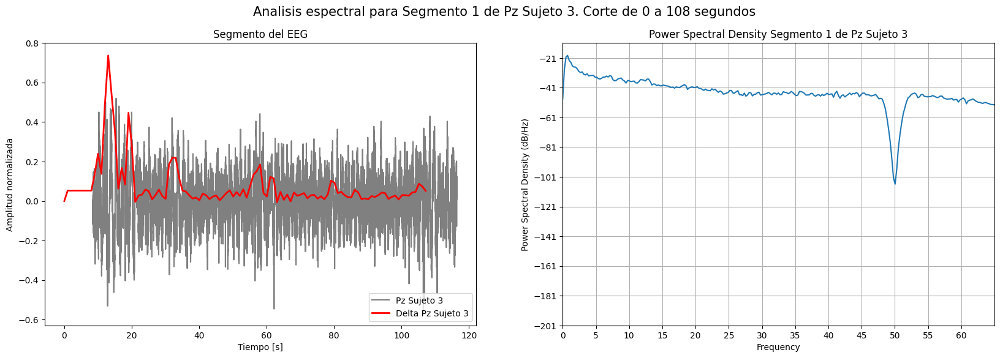

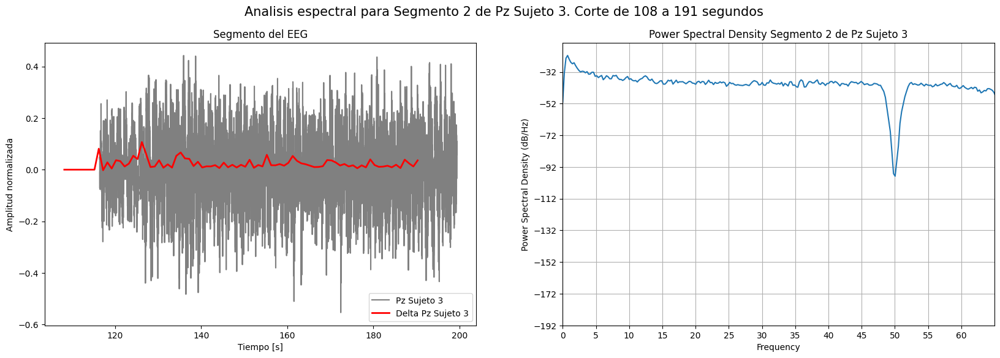

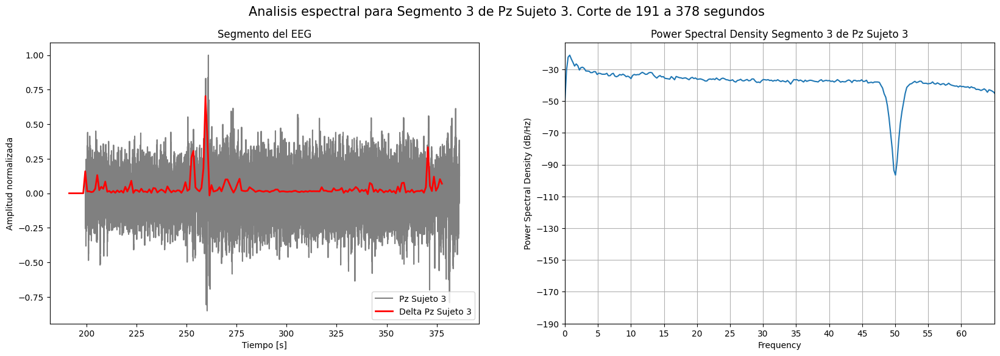

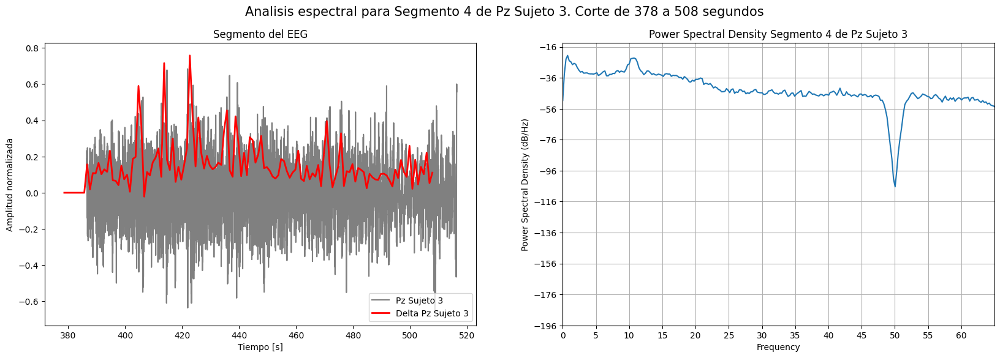

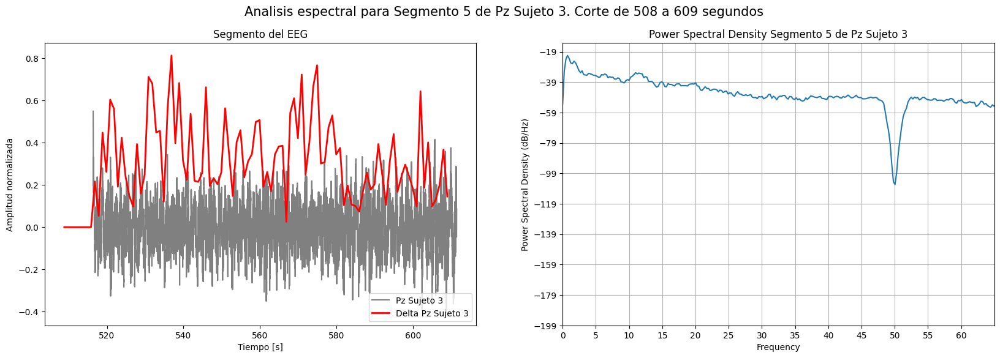

In [ ]:
analisis_frecuencial(period_Pz_2, time2, deltas1_Pz_2, ies_Pz_2, 'Pz Sujeto 3')

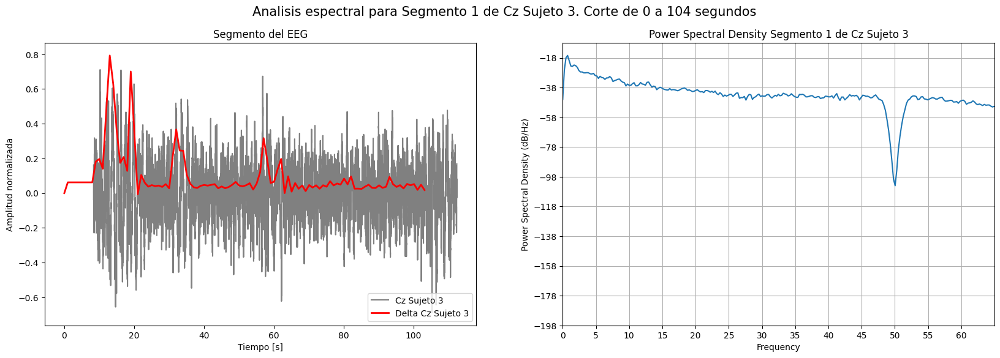

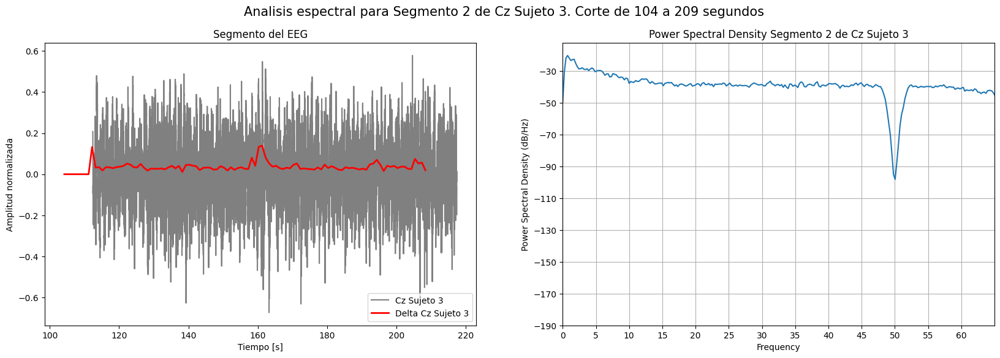

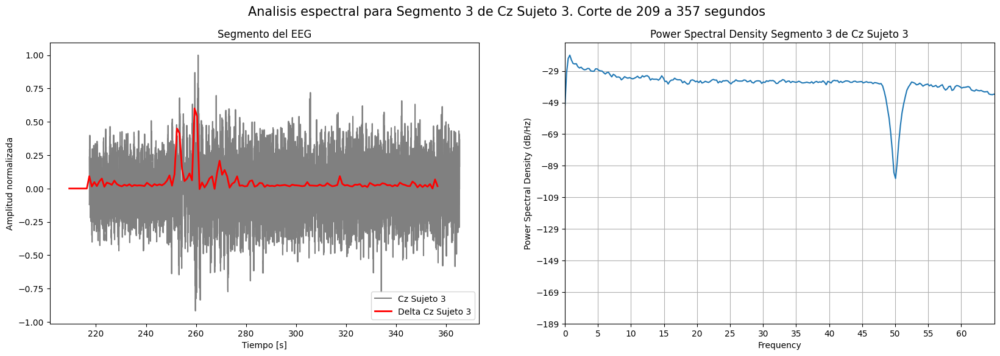

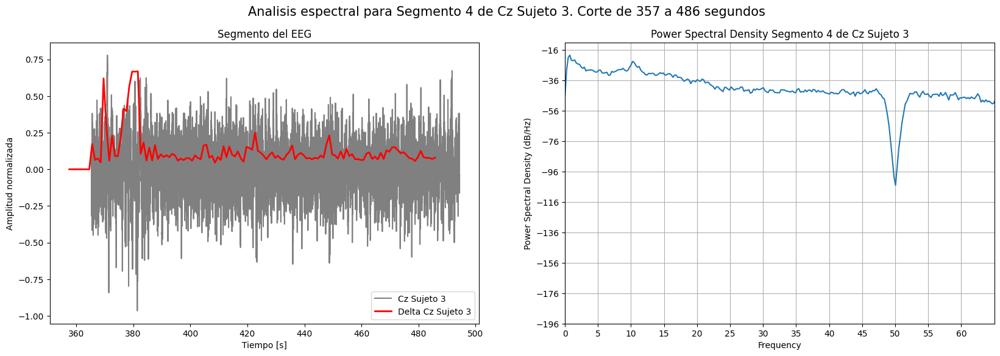

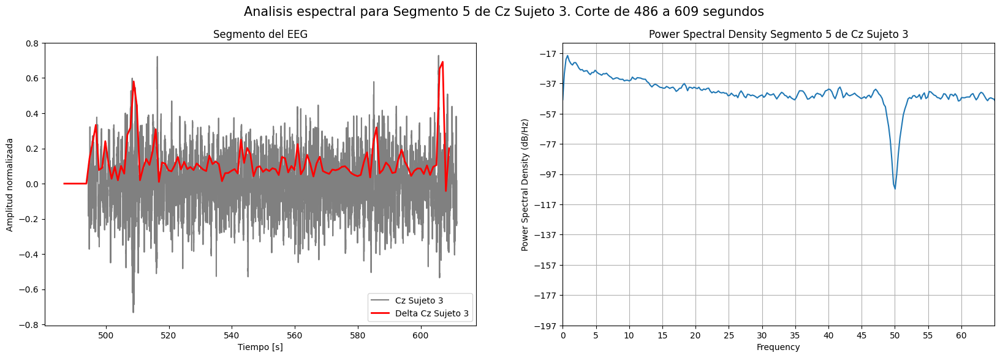

In [ ]:
analisis_frecuencial(period_Cz_2, time2, deltas1_Cz_2, ies_Cz_2, 'Cz Sujeto 3')

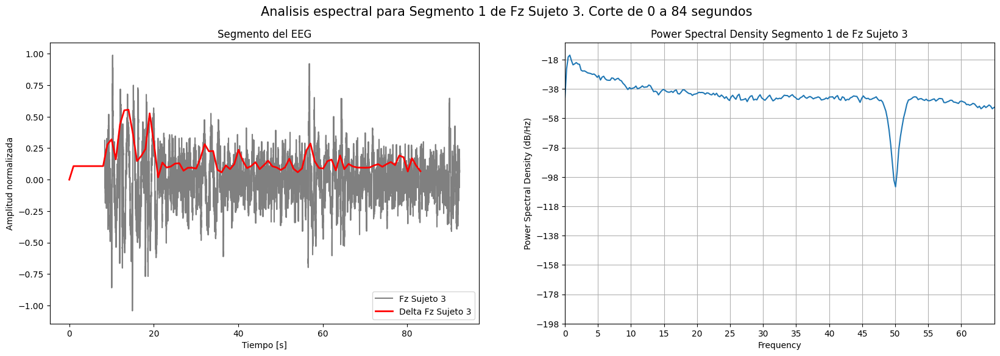

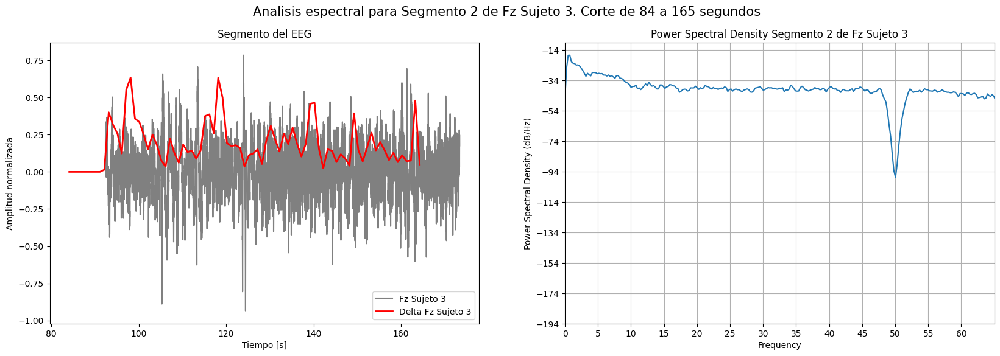

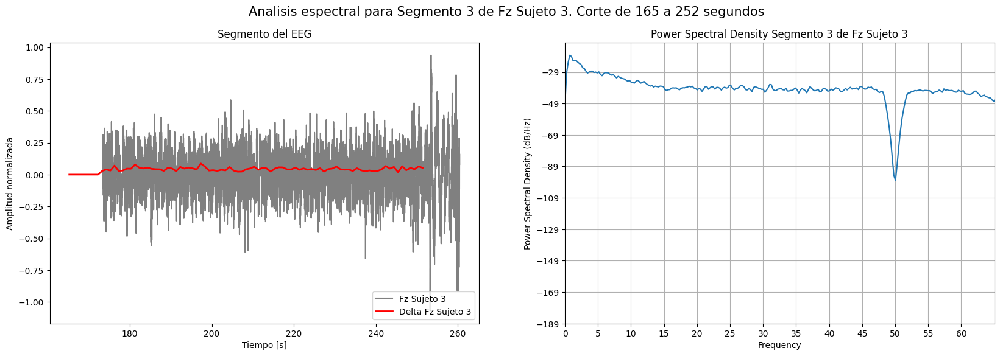

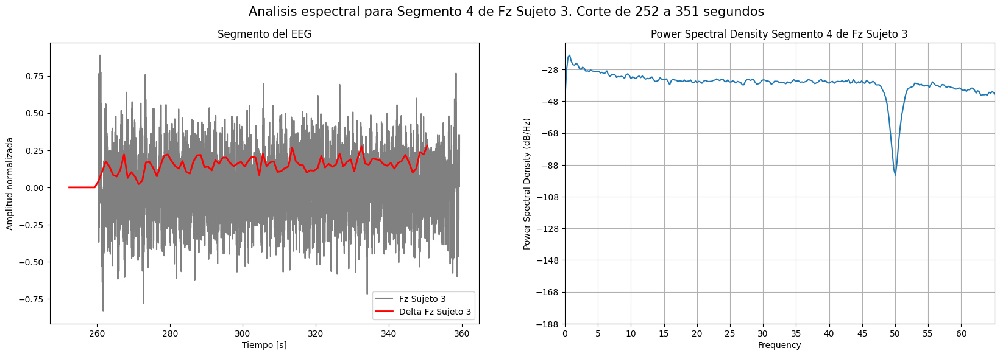

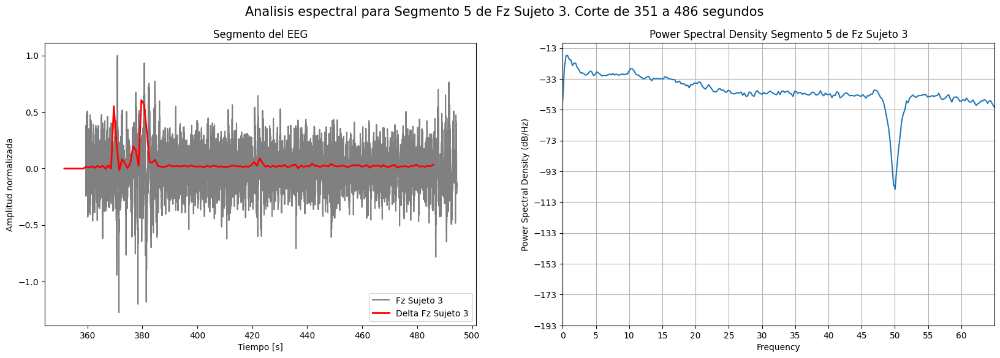

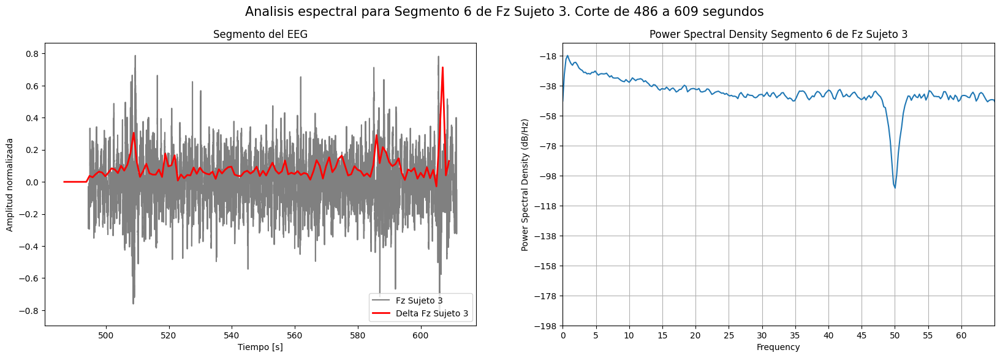

In [ ]:
analisis_frecuencial(period_Fz_2, time2, deltas1_Fz_2, ies_Fz_2, 'Fz Sujeto 3')

##Conclusiones

Se puede observar en los gráficos de la Densidad Espectral de Potencia especialmente del Sujeto 3 (tomado como Golden Standard por lo explicado anteriormente) se pueden ver 3 momentos diferentes bien marcados. Cuando el sujeto está con los ojos abiertos, luego los cierra y luego los abre nuevamente.

A nivel general, se puede ver que en todos los gráficos hay picos menores a 4 Hz. Esto puede relacionarse al filtro utilizado, que es posible que no haya sido el mejor teniendo en cuenta estos resultados; ya que el butterworth (filtro pasabandas usado) tiene crecimientos y decrecimientos lentos, pero sin ripple. Se priorizó la nulidad del ripple al crecimiento y decrecimiento rápido para no alterar las frecuencias intermedias para analizar posteriormente. Cuando se notó esto era muy tarde para modificar los parámetros "arbitrarios" elegidos para las segmentaciones, por lo que, a pesar de haber intentado modificar el pasabandas, esto provocaba pérdidas importantes de información en la segmentación posterior. Por lo que se corrió el riesgo de tener un pico en frecuencias delta (que se sabe que no tienen que ver con el estudio) y luego analizar las demás frecuencias sin tenr en cuenta las anteriores.

Comenzando por el segmento basal, la densidad espectral de potencia muestra que no hay predominancia explícita de una frecuencia en particular. Esto tiene sentido según Aminoff [2], quien explica en el libro *Aminoff’s electrodiagnosis in clinical neurology^* que la actividad Beta se ve atenuada por movimientos colaterales u oculares, que suelen ocurrir en los estados basales.

Continuando con el segundo estado, no se logran ver picos del frecuencias en el rango de gamma, que son esperadas en el / los segmentos de concentración y esfuerzo en tareas cognitivas. Sin embargo, se puede observar como en el canal Fz (el más relacionado con el lóbulo frontal, encargado de generar pensamientos lógicos) los dB/Hz aumentan de -40 a -35 entre el segmento 1 (antes de 150 segundos aproximadamente) y el segmento 2 y 3 (hasta 360 segundos aproximadamente). Es posible que esto no sea un aumento significativo, pero simboliza una potencia mayor de esas frecuencias dentro del espetro, por lo que se interpreta como una mayor aparición en el Sujeto en ese segmento en particular.

Luego, según los ritmos descritos por la bibliografía para cada segmento, se espera ver ritmo alfa únicamente cuando los ojos están cerrados. **Esto, ocurre no solo para el Sujeto 3, sino que para los otros dos sujetos también. Pero se especifica más que nada en el 3ero.** Se puede ver claramente la existencia de un pico alrededor de los 10 Hz siempre que los segmentos ocurren del segundo 350 al 500. Ahora bien, las intensidades varían en relación al segmento en particular, ya que el pico puede no estar tan marcado en un segmento que también incluye ondas beta y gamma. Suele estar bien diferenciado cuando el segmento es puramente de ojos cerrados. Como lo es el Segmento 4 de Pz del Sujeto 3 (entre 378 y 508). Teplan [3] concluye en 2002 que es predominante el ritmo alfa cuando los seres adultos cierran los ojos.

Además, se puede ver en el Segmento 5 de Pz del Sujeto 3 que hay ondas Beta de baja frecuencia, con un pico alrededor de los 14 Hz. Esto determina el estado de conciencia relajado con ojos abiertos. Se ve la transición del ritmo alfa al beta y la predominancia de éste, como lo menciona Aminoff [2] en su libro.





###Mejoras a futuro

A nivel general, se analiza que el segmentador funciona con sus limitaciones.

Respecto a la segmentación realizada, se recomienda realizar la misma a partir de las muestras del coeficiente de disimilitud crudo, sin ser este resampleado, ya que esto pudo haber traído complicaciones. Esto provoca que comprobar que la disimilitud ocurre por más de una muestra consecutiva sea más factible que probarlo por 2 segundos consecutivos, cuando cada uno de estos incluye hasta 250 muestras.

Por otro lado, el pasabandas butterworth tuvo sus defectos vistos en las densidades espectrales de potencia con presencia de picos menores a 1 Hz. A futuro se recomienda realizar una prueba de diversos filtros para procesar, incluyendo filtros FIR (con diferentes ventanas) e IIR (entre ellos Butterworth y Chebyshev).

##Bibliografía

[1] Maureira Cid, F., Díaz Muñoz, H., Flores Ferro, E., Gavotto Nogales, O., &amp; Hadweh Briceño, M. (2019). Variaciones de las dinámicas no lineales de las ondas gamma durante la Resolución de Una Prueba de Atención Tras La Aplicación de Ejercicio físico&nbsp; (variations in Nonlinear Gamma Wave Dynamics during the resolution of a test of attention after the Applica. Retos, (37), 320–325. https://doi.org/10.47197/retos.v37i37.73032

[2] Aminoff, M. J. (2012). Aminoff’s electrodiagnosis in clinical neurology: Expert consult - online. Elsevier Health Sciences.

[3] Michal Teplan. (2002). Fundamental of EEG measurement. MEA-SUREMENT SCIENCE REVIEW, 2